<a href="https://colab.research.google.com/github/cscicla/SEM/blob/main/Upload_Annotated_SemanticSEM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [24]:
from __future__ import print_function
import argparse
import time
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from torchvision.io import read_image
import numpy as np
import matplotlib.pyplot as plt
import glob
from PIL import Image
from PIL.ImageOps import grayscale
from matplotlib.pyplot import imsave, imshow
import gc
from pathlib import Path
from skimage.transform import resize
!pip install pytorch-toolbelt
from pytorch_toolbelt import losses as L
import random
from sklearn.metrics import f1_score
from google.colab.patches import cv2_imshow
import cv2 as cv
from sklearn.preprocessing import MultiLabelBinarizer
import json
from PIL import Image, ImageDraw
from sklearn.model_selection import train_test_split
import shutil
from sklearn.metrics import precision_recall_curve, f1_score, confusion_matrix
import imageio
import seaborn as sns

# Define the model: U-Net

In [25]:
class UNet_PV(nn.Module):
    def __init__(self):
        super(UNet_PV, self).__init__()
        ######################## DEFINE THE LAYERS ########################
        self.dropout = nn.Dropout(p=0.3)
        # encoder layers (convolution)
        self.max_pool = nn.MaxPool2d(kernel_size=2)
        self.enc1 = nn.LazyConv2d(64, 3, 1, 1)
        self.enc1b = nn.LazyConv2d(64, 3, 1, 1)
        self.enc2 = nn.LazyConv2d(128, 3, 1, 1)
        self.enc2b = nn.LazyConv2d(128, 3, 1, 1)
        self.enc3 = nn.LazyConv2d(256, 3, 1, 1)
        self.enc3b = nn.LazyConv2d(256, 3, 1, 1)
        self.enc4 = nn.LazyConv2d(512, 3, 1, 1)
        self.enc4b = nn.LazyConv2d(512, 3, 1, 1)

        # bottleneck
        self.enc5 = nn.LazyConv2d(1024, 3, 1, 1)
        self.enc5b = nn.LazyConv2d(1024, 3, 1, 1)

        # decoder layers (deconvolution)
        # up-convolution (2x2)
        self.dec1 = nn.LazyConvTranspose2d(512, 2, 2, 0)
        self.dec1b = nn.LazyConvTranspose2d(512, 2, 2, 0)
        self.dec2 = nn.LazyConvTranspose2d(256, 2, 2, 0)
        self.dec2b = nn.LazyConvTranspose2d(256, 2, 2, 0)
        self.dec3 = nn.LazyConvTranspose2d(128, 2, 2, 0)
        self.dec3b = nn.LazyConvTranspose2d(128, 2, 2, 0)
        self.dec4 = nn.LazyConvTranspose2d(64, 2, 2, 0)
        self.dec4b = nn.LazyConvTranspose2d(64, 2, 2, 0)
        # convolution (3x3)
        self.conv1a = nn.LazyConv2d(64, 3, 1, 1)
        self.conv1b = nn.LazyConv2d(64, 3, 1, 1)
        self.conv2a = nn.LazyConv2d(128, 3, 1, 1)
        self.conv2b = nn.LazyConv2d(128, 3, 1, 1)
        self.conv3a = nn.LazyConv2d(256, 3, 1, 1)
        self.conv3b = nn.LazyConv2d(256, 3, 1, 1)
        self.conv4a = nn.LazyConv2d(512, 3, 1, 1)
        self.conv4b = nn.LazyConv2d(512, 3, 1, 1)
        self.conv5a = nn.LazyConv2d(1024, 3, 1, 1)
        self.conv5b = nn.LazyConv2d(1024, 3, 1, 1)

        # output map (6 classes)
        self.out = nn.LazyConv2d(6, 1, 1, 0)
        self.forward = self.build_unet_model

    # essentially just adding relu to all of our conv (enc and conv)
        # (the dec is convTranspose)
    def double_conv_block1(self, x):
        # Conv2D then ReLU activation
        x = F.relu(self.enc1(x))
        x = F.relu(self.enc1b(x))
        return x
    def double_conv_block2(self, x):
        x = F.relu(self.enc2(x))
        x = F.relu(self.enc2b(x))
        return x
    def double_conv_block3(self, x):
        x = F.relu(self.enc3(x))
        x = F.relu(self.enc3b(x))
        return x
    def double_conv_block4(self, x):
        x = F.relu(self.enc4(x))
        x = F.relu(self.enc4b(x))
        return x
    def double_conv_block5(self, x):
        x = F.relu(self.enc5(x))
        x = F.relu(self.enc5b(x))
        return x
    def up_double_conv_block1(self, x):
        x = F.relu(self.conv5a(x))
        x = F.relu(self.conv5b(x))
        return x
    def up_double_conv_block2(self, x):
        x = F.relu(self.conv4a(x))
        x = F.relu(self.conv4b(x))
        return x
    def up_double_conv_block3(self, x):
        x = F.relu(self.conv3a(x))
        x = F.relu(self.conv3b(x))
        return x
    def up_double_conv_block4(self, x):
        x = F.relu(self.conv2a(x))
        x = F.relu(self.conv2b(x))
        return x

    # Now that we have defined our layers (with ReLu), we can build our blocks
    #################### Contracting path (Encoder) ####################
    '''
    * captures contextual information and reduces spatial resolution of the input
    * downsampling: converting a high resolution image to a low resolution image
          * helps the model better understand "WHAT" is present in the image, but it loses the information of "WHERE" it is present
            the pooling (and convolution) operation both reduce the size of the image
          # identifies relevant info
    * structure: double convolution, max pooling, dropout
    # double the number of filters in each layer
    '''
    def downsample_block1(self, x):
        f = self.double_conv_block1(x) # f: feature map after the double conv block
        p = self.max_pool(f)           # p: downsampled feature map
            # reduces the spatial dimenstions but not the depth
        p = self.dropout(p)
            # regularization technique that randomly "drops" some weights in training to prevent overfitting/ boost generalization
        return f, p
            # f: provides detailed, high-res features
                  # later passed (through skip connections) to recoder to maintain detail and improve accuracy
            # p: allows network to learn more abstract and general features while preventing overfitting
    def downsample_block2(self, x):
        f = self.double_conv_block2(x)
        p = self.max_pool(f)
        p = self.dropout(p)
        return f, p
    def downsample_block3(self, x):
        f = self.double_conv_block3(x)
        p = self.max_pool(f)
        p = self.dropout(p)
        return f, p
    def downsample_block4(self, x):
        f = self.double_conv_block4(x)
        p = self.max_pool(f)
        p = self.dropout(p)
        return f, p

    #################### Bottleneck ####################
    def bottleneck_conv(self, x):
      x = F.relu(self.enc5(x))
      x = F.relu(self.enc5b(x))
      return x

    #################### Expansive path (Decoder) ####################
    '''
    * takes the bottleneck feature map and converts it back to size of original input image
    * upsampling: converting the low resolution image to a high resolution image
          * Since downsampling results in us losing the "WHERE" information, we recover the "WHERE" information by upsampling
          * methods: bi-linear interpolation, cubic interpolation, nearest neighbor interpolation, unpooling, transposed convolution (preferred)
    '''
    def upsample_block1(self, x, conv_features):
        # ********* UPSAMPLE *********
        x = self.dec1(x)                              # deconvolution/ upconvolution
        # ********* CONCATENATE *********
        # conv_features.size(): gets the size (dimensions) of the tensor
            # the tensor is from the corresponding layer in the encoder
        # x.size: size of x, the upsampled feature map from the prev layer in decoder
        diffY = conv_features.size()[2] - x.size()[2] # difference in height
        diffX = conv_features.size()[3] - x.size()[3] # difference in width

        # pad x to match the dimensions of conv_features (we want to return img back to OG size)
        x = F.pad(x, [diffX // 2, diffX - diffX // 2, # pads elements on l and r to match width
                  diffY // 2, diffY - diffY // 2])    # pads elts on top and bottom to match height
        x = torch.cat([x, conv_features], dim=1)      # concatenates x and conv_features
        # ********* DROPOUT *********
        x = self.dropout(x)
        # ********* Conv2D twice with ReLU activation *********
        x = self.up_double_conv_block1(x)             # integrate the high-level features
        return x
    def upsample_block2(self, x, conv_features):
        x = self.dec2(x)
        diffY = conv_features.size()[2] - x.size()[2]
        diffX = conv_features.size()[3] - x.size()[3]
        x = F.pad(x, [diffX // 2, diffX - diffX // 2,
                  diffY // 2, diffY - diffY // 2])

        x = torch.cat([x, conv_features], dim=1)
        x = self.dropout(x)
        x = self.up_double_conv_block2(x)
        return x
    def upsample_block3(self, x, conv_features):
        x = self.dec3(x)
        diffY = conv_features.size()[2] - x.size()[2]
        diffX = conv_features.size()[3] - x.size()[3]
        x = F.pad(x, [diffX // 2, diffX - diffX // 2,
                  diffY // 2, diffY - diffY // 2])

        x = torch.cat([x, conv_features], dim=1)
        x = self.dropout(x)
        x = self.up_double_conv_block3(x)
        return x
    def upsample_block4(self, x, conv_features):
        x = self.dec4(x)
        diffY = conv_features.size()[2] - x.size()[2]
        diffX = conv_features.size()[3] - x.size()[3]
        x = F.pad(x, [diffX // 2, diffX - diffX // 2,
                  diffY // 2, diffY - diffY // 2])

        x = torch.cat([x, conv_features], dim=1)
        x = self.dropout(x)
        x = self.up_double_conv_block4(x)
        return x

    ########################### PUT IT ALL TOGETHER ###########################
    def build_unet_model(self, input):
        # inputs
        inputs = input
        # encoder: contracting path - downsample
        # 1 - downsample
        f1, p1 = self.downsample_block1(inputs)
        # 2 - downsample
        f2, p2 = self.downsample_block2(p1)
        # 3 - downsample
        f3, p3 = self.downsample_block3(p2)
        # 4 - downsample
        f4, p4 = self.downsample_block4(p3)
        # 5 - bottleneck
        bottleneck = self.double_conv_block5(p4)
        # decoder: expanding path - upsample
        # 6 - upsample
        u6 = self.upsample_block1(bottleneck, f4)
        # 7 - upsample
        u7 = self.upsample_block2(u6, f3)
        # 8 - upsample
        u8 = self.upsample_block3(u7, f2)
        # 9 - upsample
        u9 = self.upsample_block4(u8, f1)
        # outputs
        outputs = self.out(u9)

        return outputs
     # def conv_block1(self, x):
    #     self.dec1(x)
    # def num_flat_features(self, x):
    #     size = x.size()[1:]  # all dimensions except the batch dimension
    #     num_features = 1
    #     for s in size:
    #         num_features *= s
    #     return num_features

# Mount

In [26]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


# Custom Dataset

In [27]:
class PVDataset(Dataset):
    def __init__(self, img_dir, label_dir, transform=None, target_transform=None):
        self.img_dir = img_dir
        self.label_dir = label_dir # (NumPy)
        self.image_list = glob.glob(img_dir + '*.png')
        self.image_list.extend(glob.glob(img_dir + '*.jpg'))
        self.image_list.extend(glob.glob(img_dir + '*.tif'))

        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_name = self.image_list[idx]
        image = Image.open(img_name).convert("L") # grayscale
        image = image.resize((1024, 768))
        label_name = self.label_dir + os.path.basename(os.path.splitext(img_name)[0]) + '_label.npy'
        label_np = np.load(label_name)
        label = torch.from_numpy(label_np) # convert label to tensor

        if self.transform: # random cropping and flipping to help generalizability
            image = self.transform(image)
            if random.random() > 0.5:
              image = transforms.functional.hflip(image)
              label = transforms.functional.hflip(label)
            if random.random() > 0.5:
              i, j, h, w = transforms.RandomCrop.get_params(
              image, output_size=(698, 364))
              image = transforms.functional.crop(image, i, j, h, w)
              label = transforms.functional.crop(label, i, j, h, w)
        return image, label

# Train/Test

In [28]:
def get_mask(all_mask):
  '''
  convert the mask to color based on class
  '''
  # set classes = colors
  unlabeled = np.array([0, 0, 0])
  silver = np.array([128, 64, 128])
  glass = np.array([189, 201, 18])
  silicon = np.array([0, 102, 0])
  void = np.array([0, 76, 130])
  interfacialvoid = np.array([36, 18, 201])
  height = all_mask.shape[0]
  width = all_mask.shape[1]

  #initialize empty mask
  final_mask = np.zeros((height, width, 3))

  # for each pixel, give it a color
  for i in range(len(all_mask)):
      for j in range(len(all_mask[i])):
          if all_mask[i][j] == 0: # was not changed from the initalized zero
              final_mask[i][j] = unlabeled
          elif all_mask[i][j] == 1:
              final_mask[i][j] = silver
          elif all_mask[i][j] == 2:
              final_mask[i][j] = glass
          elif all_mask[i][j] == 3:
              final_mask[i][j] = silicon
          elif all_mask[i][j] == 4:
              final_mask[i][j] = void
          elif all_mask[i][j] == 5:
              final_mask[i][j] = interfacialvoid
  # convert it to standard image format
  return final_mask.astype(np.uint8)

In [29]:
def save_images(data, output, target, epoch, testflag):
  '''
    save the original image, ground_truth/ target mask, and predicted mask
  '''
  save_folder = "/content/drive/MyDrive/SEM_project/masks/"
  # npy_folder = "/content/drive/MyDrive/SEM_project/masks/npy/"
  # Convert tensors to numpy arrays
  for i in range(FLAGS.batch_size):
      # data[i]: ith image in the batch
      # .cpu(): converting tensors to NumPy arrays require the data to be on the CPU
              # numpy does not support gpu tensors
      # .numpy(): convert the tensor to NumPy
      #.squeeze(): remove unecessary 1D
      data_np = data[i].cpu().numpy().squeeze()       # convert input images
      output_np = output[i].cpu().numpy().squeeze()   # convert predicted masks
      target_np = target[i].cpu().numpy().squeeze()   # convert ground truth

      pred_mask = get_mask(output_np)
      label_mask = get_mask(target_np)
      data_np = data_np * 255
      data_np = data_np.astype(np.uint8)

      # Save images as PNG files with epoch number in the filename
      imsave(os.path.join(save_folder, f'epoch_{epoch}_predicted.png'), pred_mask)

      # save original and target images at beginning of run
      if epoch == 1:
          imsave(os.path.join(save_folder, 'original.png'), data_np)
          imsave(os.path.join(save_folder, 'target.png'), label_mask)

In [30]:
def multi_acc(pred, label):
  '''
  pred: predicted labels
  label: true labels
  gets the number of correctly predicted labels
  '''
  corrects = torch.eq(pred, label).float()  # tensor where elts are 1: pred=label, 0: pred not= label
  acc = corrects.sum() / corrects.numel()   # correct/ total
  acc = acc * 100
  return acc

#Train

In [31]:
def train(model, device, train_loader, optimizer, criterion, epoch, batch_size, file, class_weights):
    '''
    Trains the model for an epoch and optimizes it.
    model: The model to train. Should already be in correct device.
    device: 'cuda' or 'cpu'.
    train_loader: dataloader for training samples.
    optimizer: optimizer to use for model parameter updates.
    criterion: used to compute loss for prediction and target
    epoch: Current epoch to train for.
    batch_size: Batch size to be used.
    '''

    # Set model to train mode before each epoch
    model.train()
    # Empty list to store losses
    losses = []
    correct = 0
    accs = []
    # Iterate over entire training samples (1 epoch)
    for batch_idx, batch_sample in enumerate(train_loader):
        data, target = batch_sample

        # Push data/label to correct device
        data = data.to(device)
        target = target.to(device)

        # Reset optimizer gradients. Avoids grad accumulation (accumulation used in RNN).
        optimizer.zero_grad()

        # Do forward pass for current set of data
        output = model(data)
        output = F.softmax(output, dim=1)
        criterion=L.DiceLoss('multiclass')
        # DiceLoss:
        loss = criterion(y_pred=output, y_true=target.long())
        # Computes gradient based on final loss
        loss.backward()
        output = torch.argmax(output, dim=1)

        # Store loss
        losses.append(loss.item())

        # Optimize model parameters based on learning rate and gradient
        optimizer.step()
        acc = multi_acc(output, target).cpu()
        accs.append(acc)
        gc.collect()

    train_loss = float(np.mean(losses))
    # train_acc = correct / ((batch_idx+1) * batch_size)
    print("Epoch: ", epoch)
    print('Train set: Average loss: {:.4f}'.format(train_loss))
    print('Average Train Accuracy: {:.4f}'.format(np.mean(accs)))
    file.write('\n' + "Epoch: " + str(epoch) + '\n')
    file.write('Train set: Average loss: {:.4f}\n'.format(float(np.mean(losses))))
    return train_loss, np.mean(accs)

In [32]:
def test(model, device, test_loader, file, epoch, class_weights):
    '''
    Tests the model.
    model: The model to train. Should already be in correct device.
    device: 'cuda' or 'cpu'.
    test_loader: dataloader for test samples.
    '''

    # Set model to eval mode to notify all layers.
    model.eval()

    losses = []
    accs=[]
    correct = 0
    data_last = 0
    # Set torch.no_grad() to disable gradient computation and backpropagation
    with torch.no_grad():
        for batch_idx, sample in enumerate(test_loader):
            data, target = sample
            data, target = data.to(device), target.to(device)

            # Predict for data by doing forward pass
            output = model(data)
            output = F.softmax(output, dim=1)
            criterion=L.DiceLoss('multiclass')
            loss = criterion(y_pred=output, y_true=target.long())
            output = torch.argmax(output, dim=1)
            # Append loss to overall test loss
            losses.append(loss.item())
            acc = multi_acc(output, target).cpu()
            accs.append(acc)
    save_images(data, output, target, epoch, True)
    test_loss = float(np.mean(losses))
    print('Test set: Average loss: {:.4f}'.format(test_loss))
    print('Average Test Accuracy: {:.4f}'.format(np.mean(accs)))
    return test_loss, np.mean(accs)

# Main

In [33]:
def split_data(image_dir, label_dir, train_image_dir, train_label_dir, test_image_dir, test_label_dir, test_size=0.2):
    images = [f for f in os.listdir(image_dir) if f.endswith(('.png', '.jpg'))]
    labels = [f for f in os.listdir(label_dir) if f.endswith('.npy')]

    image_bases = {os.path.splitext(f)[0] for f in images}
    label_bases = {os.path.splitext(f)[0].replace('_label', '') for f in labels}
    common_bases = list(image_bases & label_bases)

    print(f"Found {len(common_bases)} common images and labels.")

    if len(common_bases) == 0:
        raise ValueError("No common images and labels found to split.")

    images = [f"{base}.jpg" if f"{base}.jpg" in images else f"{base}.png" for base in common_bases]
    labels = [f"{base}_label.npy" for base in common_bases]

    train_images, test_images, train_labels, test_labels = train_test_split(images, labels, test_size=test_size, random_state=42)

    os.makedirs(train_image_dir, exist_ok=True)
    os.makedirs(train_label_dir, exist_ok=True)
    os.makedirs(test_image_dir, exist_ok=True)
    os.makedirs(test_label_dir, exist_ok=True)

    for image, label in zip(train_images, train_labels):
        shutil.move(os.path.join(image_dir, image), os.path.join(train_image_dir, image))
        shutil.move(os.path.join(label_dir, label), os.path.join(train_label_dir, label))

    for image, label in zip(test_images, test_labels):
        shutil.move(os.path.join(image_dir, image), os.path.join(test_image_dir, image))
        shutil.move(os.path.join(label_dir, label), os.path.join(test_label_dir, label))

    print(f"Moved {len(train_images)} images to training set and {len(test_images)} images to test set.")

In [34]:
def run_main(FLAGS, file):
    # Check if cuda is available
    use_cuda = torch.cuda.is_available()
    # Set proper device based on cuda availability
    device = torch.device("cuda" if use_cuda else "cpu")
    print("Torch device selected: ", device)
    file.write("\n\nTorch device selected: " + str(device) + '\n')
    # Initialize the model and send to device
    model = UNet_PV().to(device)
    save_folder = "/content/drive/MyDrive/SEM_project/masks"
    # Create the folder if it doesn't exist
    os.makedirs(save_folder, exist_ok=True)
    checkpoint_folder = "/content/drive/MyDrive/SEM_project/checkpoints"
    os.makedirs(checkpoint_folder, exist_ok=True)
    optimizer = optim.Adam(model.parameters(), lr=FLAGS.learning_rate)

    # Create transformations to apply to each data sample
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.5), (0.5))
         ])
    criterion = nn.CrossEntropyLoss()
    class_weights = torch.Tensor([1, 1, 1.5, 1, 1.5, 1.5]).to(device)

    #################### LOAD DATA ####################
    image_dir = '/content/drive/MyDrive/SEM_project/data/'
    label_dir = '/content/drive/MyDrive/SEM_project/output'
    train_image_dir = '/content/drive/MyDrive/SEM_project/train/data/'
    train_label_dir = '/content/drive/MyDrive/SEM_project/train/output/'
    test_image_dir = '/content/drive/MyDrive/SEM_project/test/data/'
    test_label_dir = '/content/drive/MyDrive/SEM_project/test/output/'

    # Split data into training and test sets
    # split_data(image_dir, label_dir, train_image_dir, train_label_dir, test_image_dir, test_label_dir)

    # Load datasets for training and testing
    # Inbuilt datasets available in torchvision (check documentation online)
    dataset1 = PVDataset(train_image_dir, train_label_dir, transform=transform)
    dataset2 = PVDataset(test_image_dir, test_label_dir, transform=transform)

    train_loader = DataLoader(dataset1, batch_size=FLAGS.batch_size,
                              shuffle=True, num_workers=2)
    test_loader = DataLoader(dataset2, batch_size=FLAGS.batch_size,
                             shuffle=False, num_workers=2)

    best_accuracy = 0.0
    checkpoint_path = '/content/drive/MyDrive/SEM_project/checkpoints/model_filled2.pth'
    train_losses = []
    train_accs = []
    test_losses = []
    test_accs = []
    if not os.path.isfile(checkpoint_path):
      # Run training for n_epochs specified in config
      for epoch in range(1, FLAGS.num_epochs + 1):
          train_loss, train_acc = train(model, device, train_loader,
                                        optimizer, criterion, epoch,
                                        FLAGS.batch_size, file, class_weights)
          test_loss, test_acc = test(model, device, test_loader,
                                     file, epoch, class_weights)

          train_losses.append(train_loss)
          train_accs.append(train_acc)
          test_losses.append(test_loss)
          test_accs.append(test_acc)
          torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': optimizer.state_dict(),
              'train_losses': train_losses,
              'test_losses': test_losses,
              'train_accs': train_accs,
              'test_accs': test_accs
          }, checkpoint_path)

    else:
      checkpoint = torch.load(checkpoint_path)
      model.load_state_dict(checkpoint['model_state_dict'])
      optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
      epoch = checkpoint['epoch']
      train_losses = checkpoint['train_losses']
      test_losses = checkpoint['test_losses']
      train_accs = checkpoint['train_accs']
      test_accs = checkpoint['test_accs']

      for epoch_i in range(epoch+1, FLAGS.num_epochs + 1):
          train_loss, train_acc = train(model, device, train_loader,
                                        optimizer, criterion, epoch_i,
                                        FLAGS.batch_size, file,class_weights)
          test_loss, test_acc = test(model, device, test_loader, file,
                                     epoch_i, class_weights)
          train_losses.append(train_loss)
          train_accs.append(train_acc)
          test_losses.append(test_loss)
          test_accs.append(test_acc)
          torch.save({
              'epoch': epoch,
              'model_state_dict': model.state_dict(),
              'optimizer_state_dict': optimizer.state_dict(),
              'train_losses': train_losses,
              'test_losses': test_losses,
              'train_accs': train_accs,
              'test_accs': test_accs
          }, checkpoint_path)

        # if test_accuracy > best_accuracy:
        #     best_accuracy = test_accuracy
    # print("accuracy is {:2.2f}".format(best_accuracy))
    # file.write("accuracy is {:2.2f}".format(best_accuracy))
    torch.save(model, '/content/drive/MyDrive/SEM_project/final_model_filled2.pth')

    print("Training and evaluation finished")

    plt.plot(train_losses)
    plt.savefig("/content/drive/MyDrive/SEM_project/graphs/Train_loss_model.jpg")
    plt.clf()
    plt.plot(train_accs)
    plt.savefig("/content/drive/MyDrive/SEM_project/graphs/Train_acc_model.jpg")
    plt.clf()
    plt.plot(test_losses)
    plt.savefig("/content/drive/MyDrive/SEM_project/graphs/Test_loss_model.jpg")
    plt.clf()
    plt.plot(test_accs)
    plt.savefig("/content/drive/MyDrive/SEM_project/graphs/Test_acc_model.jpg")
    plt.clf()
    file.write("\nTraining and evaluation finished")


if __name__ == '__main__':
    torch.set_printoptions(threshold=10000)
    # Set parameters for Sparse Autoencoder
    parser = argparse.ArgumentParser('CNN Exercise.')
    parser.add_argument('--mode',
                        type=int, default=1,
                        help='Select mode between 1-5.')
    parser.add_argument('--learning_rate',
                        type=float, default=0.00005,
                        help='Initial learning rate.')
    parser.add_argument('--num_epochs',
                        type=int,
                        default=280,
                        help='Number of epochs to run trainer.')
    parser.add_argument('--batch_size',
                        type=int, default=1,
                        help='Batch size. Must divide evenly into the dataset sizes.')
    parser.add_argument('--log_dir',
                        type=str,
                        default='logs',
                        help='Directory to put logging.')
    with open('output.txt', 'a') as f:
        # FLAGS = None
        gc.collect()
        FLAGS, unparsed = parser.parse_known_args()

        run_main(FLAGS, f)


Torch device selected:  cuda


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/lazy.py:181: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


Epoch:  1
Train set: Average loss: 0.8191
Average Train Accuracy: 25.3891
Test set: Average loss: 0.8140
Average Test Accuracy: 39.2949
Epoch:  2
Train set: Average loss: 0.7990
Average Train Accuracy: 44.3042
Test set: Average loss: 0.8005
Average Test Accuracy: 49.7941
Epoch:  3
Train set: Average loss: 0.8009
Average Train Accuracy: 49.3342
Test set: Average loss: 0.7941
Average Test Accuracy: 51.3525
Epoch:  4
Train set: Average loss: 0.8017
Average Train Accuracy: 50.3549
Test set: Average loss: 0.7724
Average Test Accuracy: 59.7609
Epoch:  5
Train set: Average loss: 0.7933
Average Train Accuracy: 54.7662
Test set: Average loss: 0.7884
Average Test Accuracy: 57.8735
Epoch:  6
Train set: Average loss: 0.7888
Average Train Accuracy: 56.0075
Test set: Average loss: 0.7894
Average Test Accuracy: 63.6370
Epoch:  7
Train set: Average loss: 0.7868
Average Train Accuracy: 55.1568
Test set: Average loss: 0.7862
Average Test Accuracy: 62.6201
Epoch:  8
Train set: Average loss: 0.7732
Averag

<Figure size 640x480 with 0 Axes>

# Evaluation

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/lazy.py:181: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


Yingli.C46BB21.w1.3.png


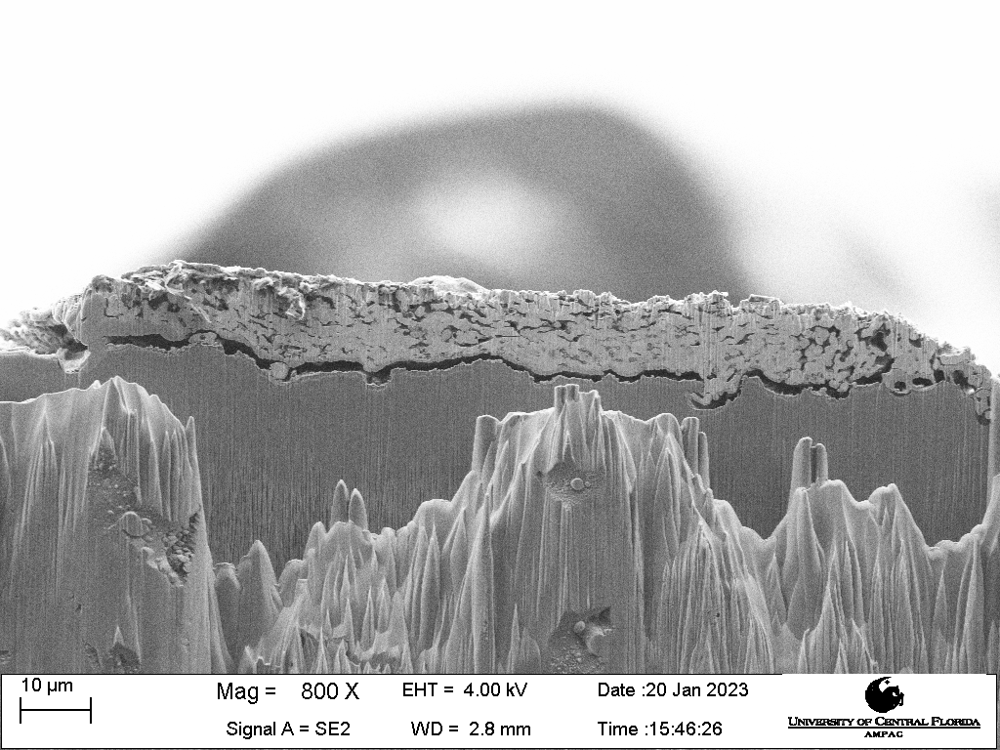

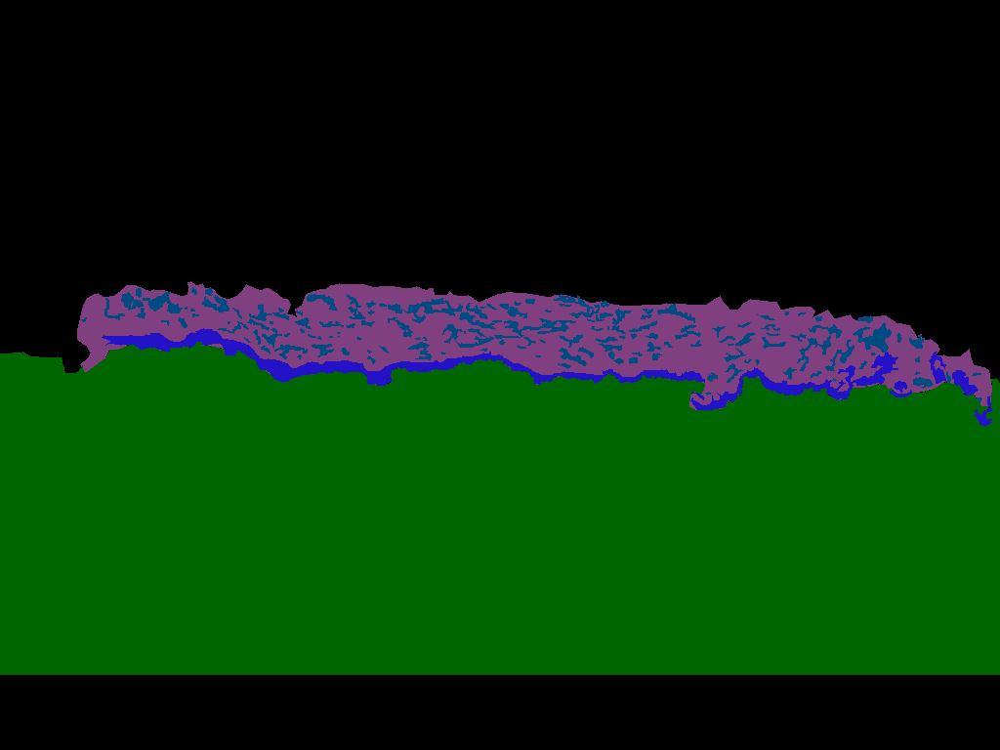

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


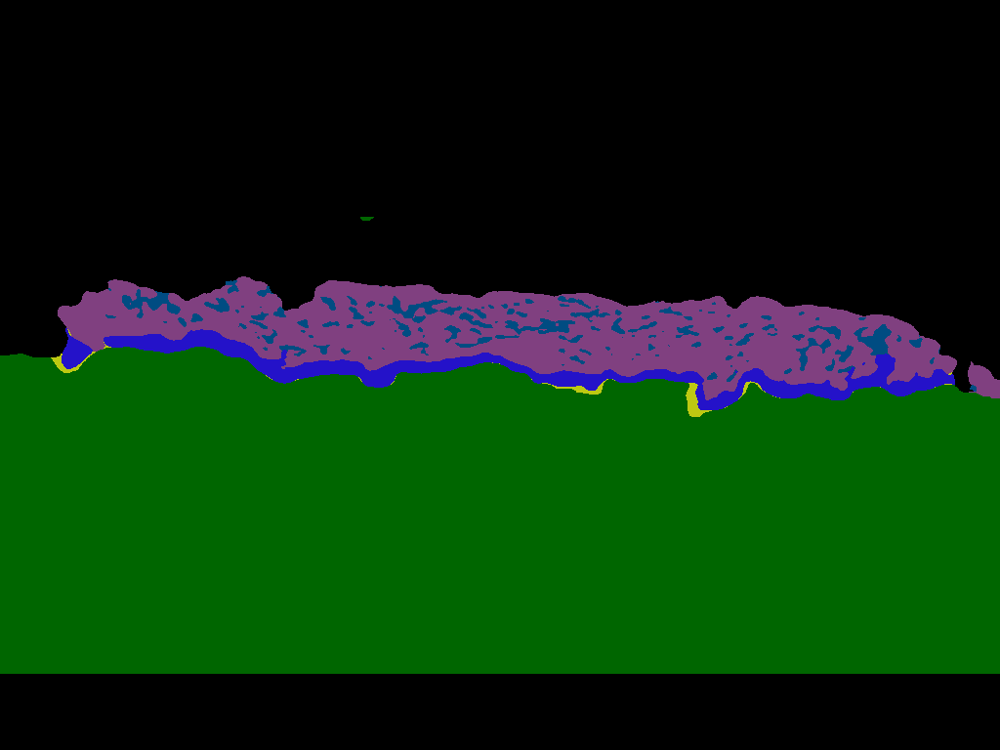

Yingli.C46BB21.w2.5.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


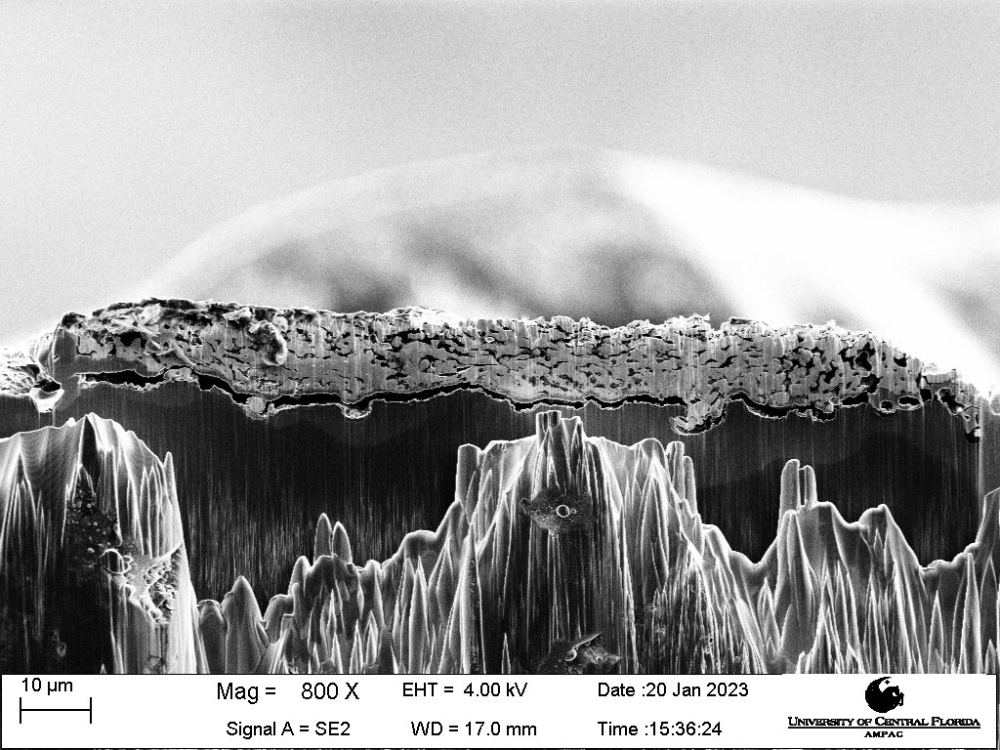

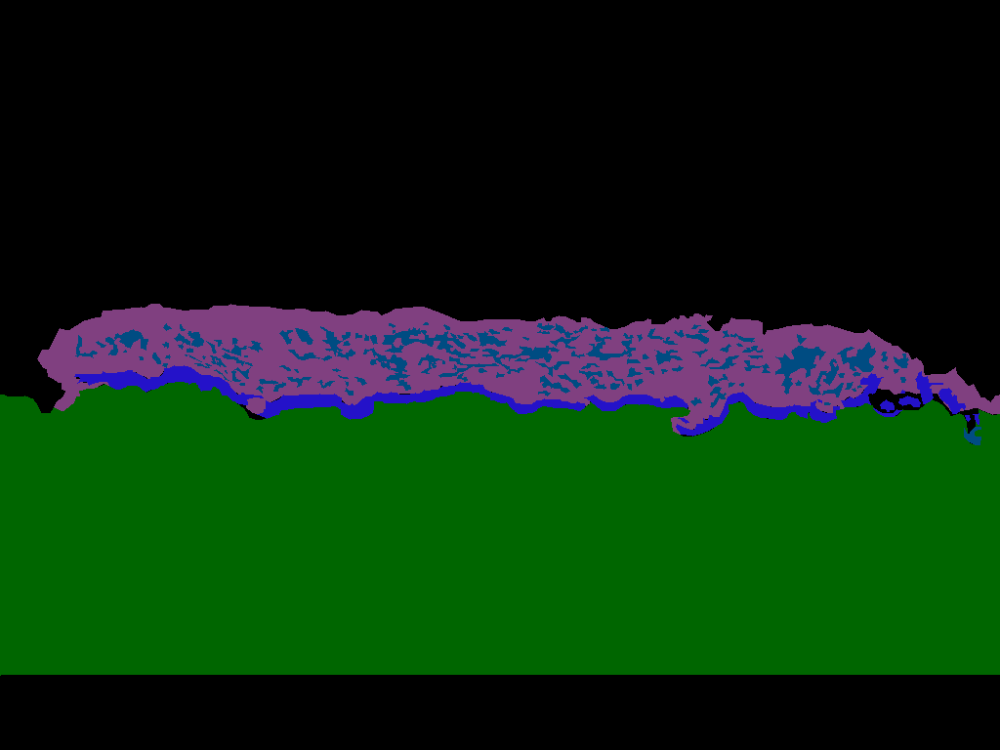

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


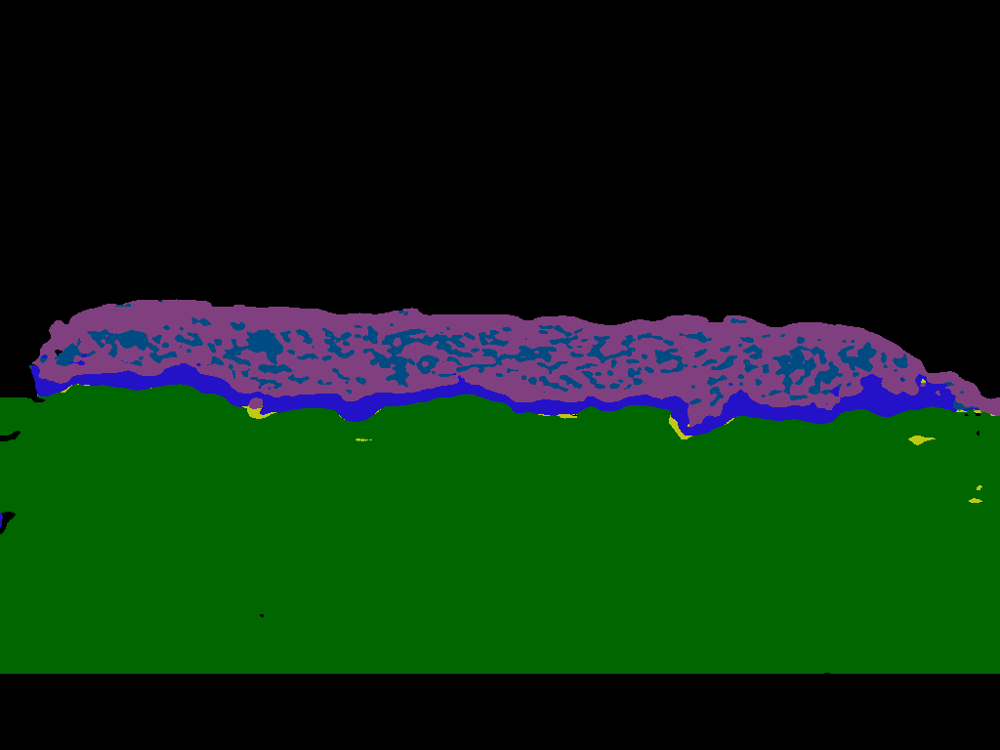

VCADControl.C17BB21.w2.1.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


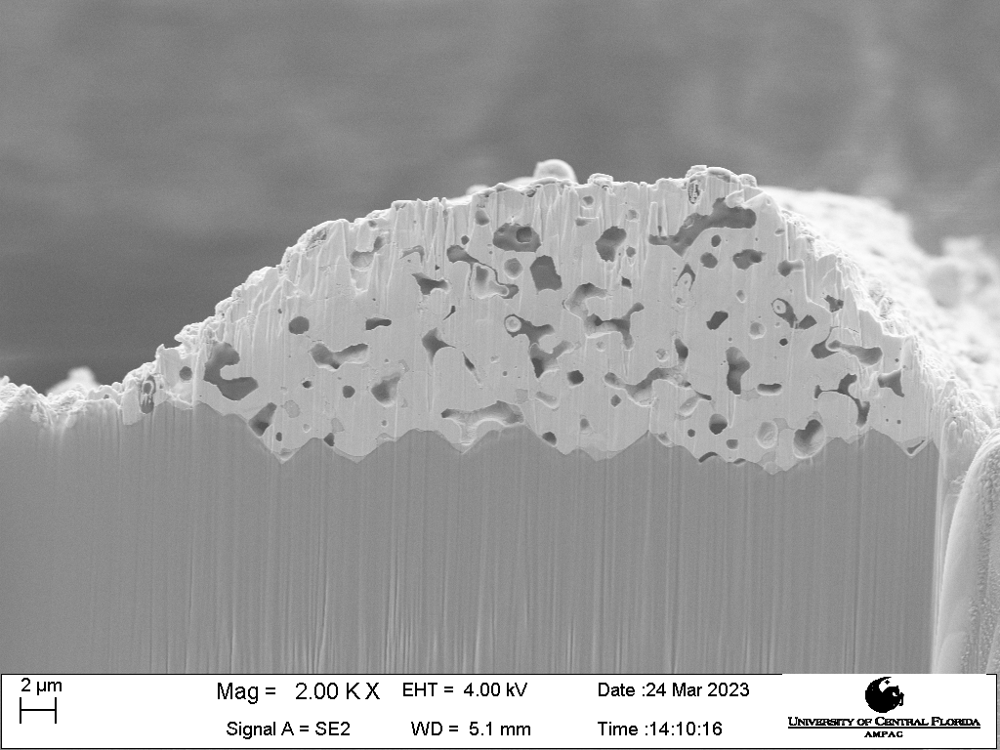

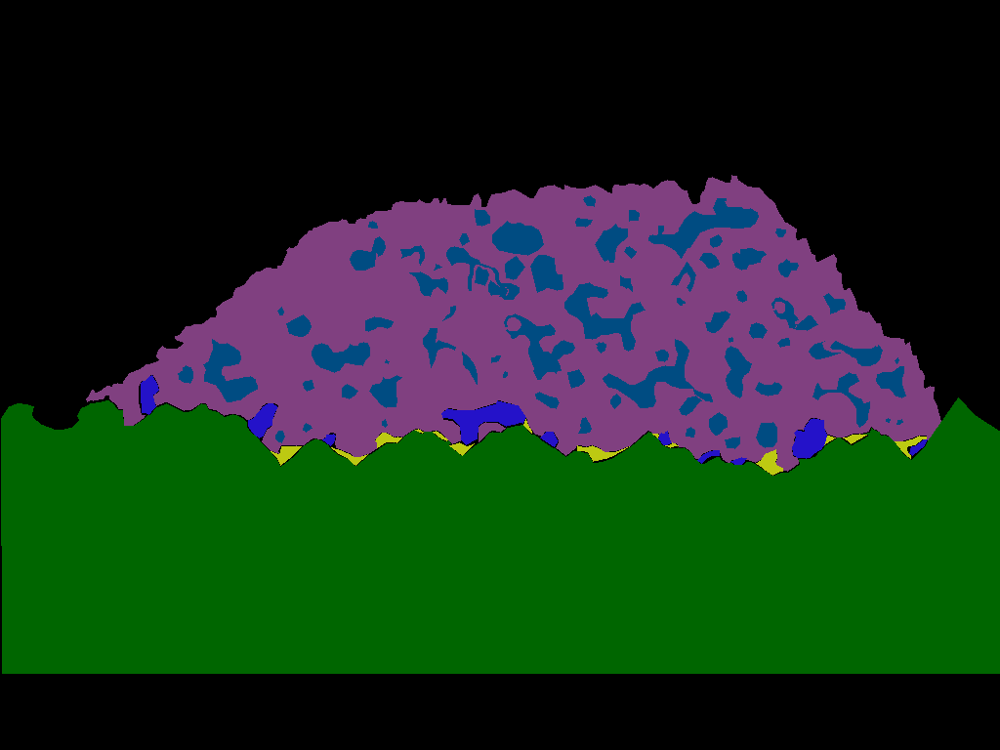

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


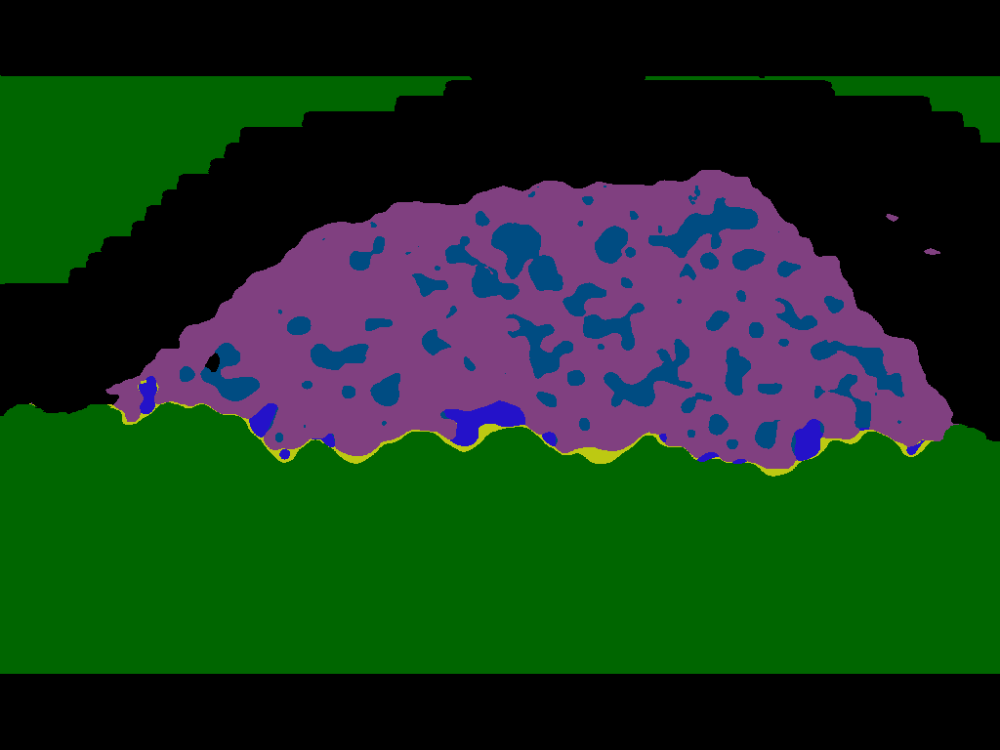

[0.81664099 0.98688525 0.78911565 0.71741935 0.97014925 0.98901099]
VCADControl.C17CR11.w1.1.png


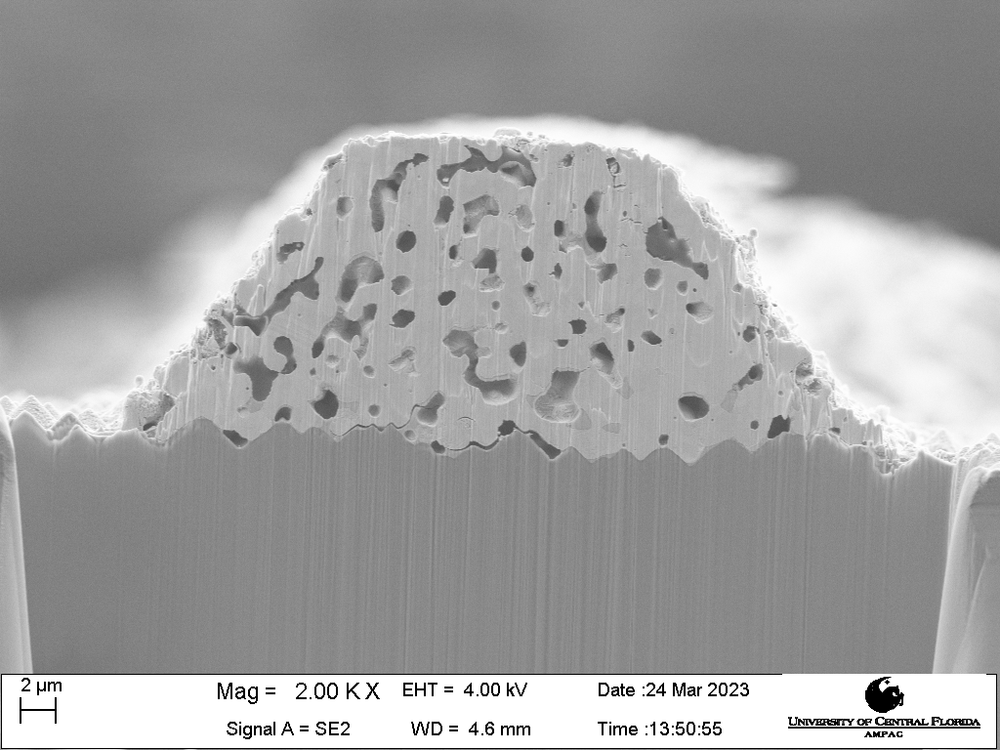

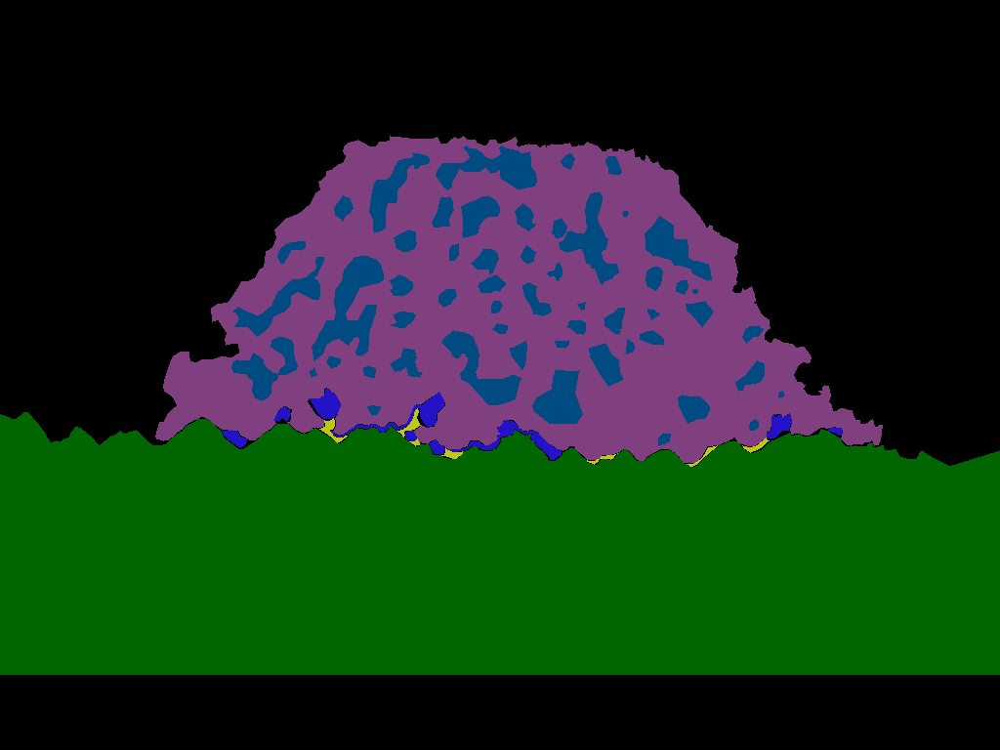

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


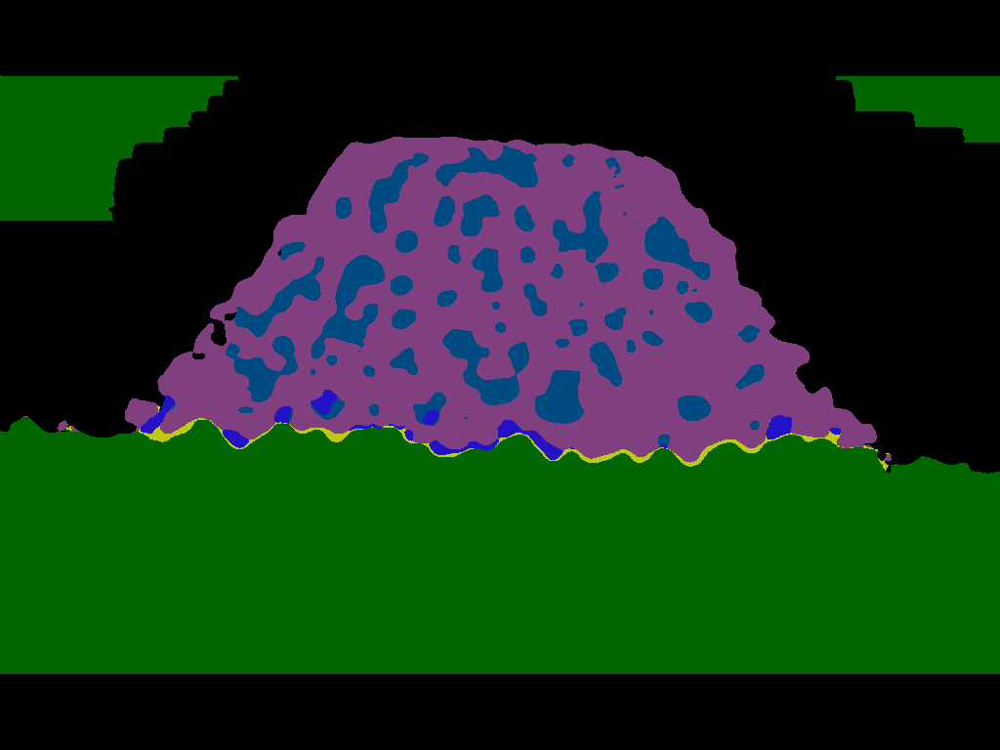

[0.99284436 0.99701493 0.89256198 0.77239354 0.99507389 0.97959184]
VCAD.C33BB21.w2.1.png


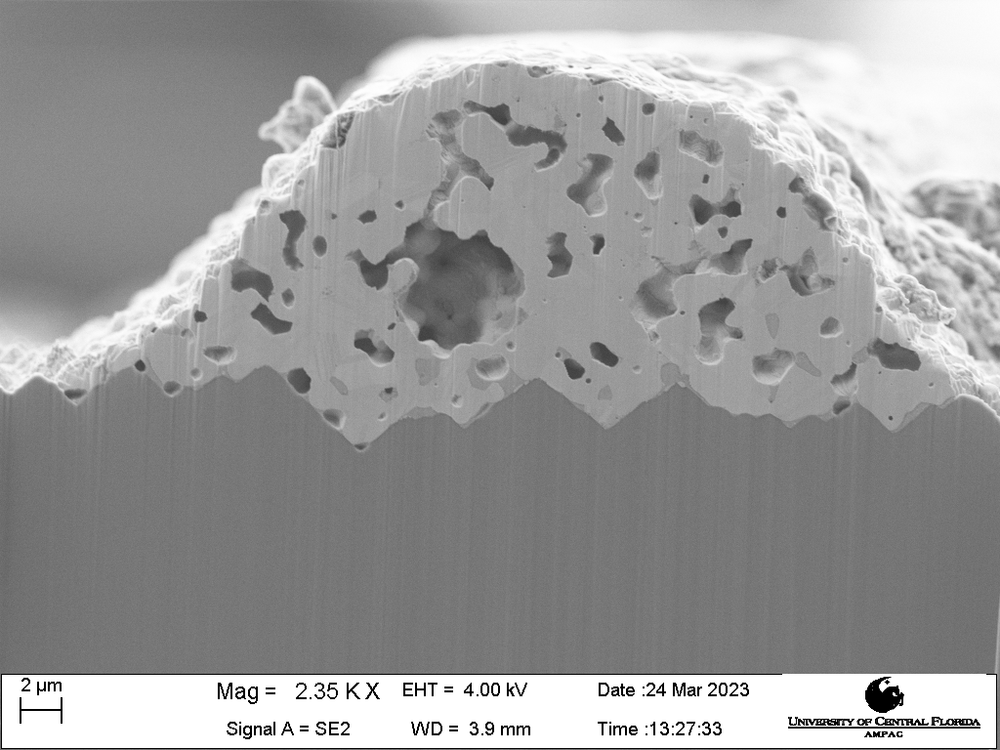

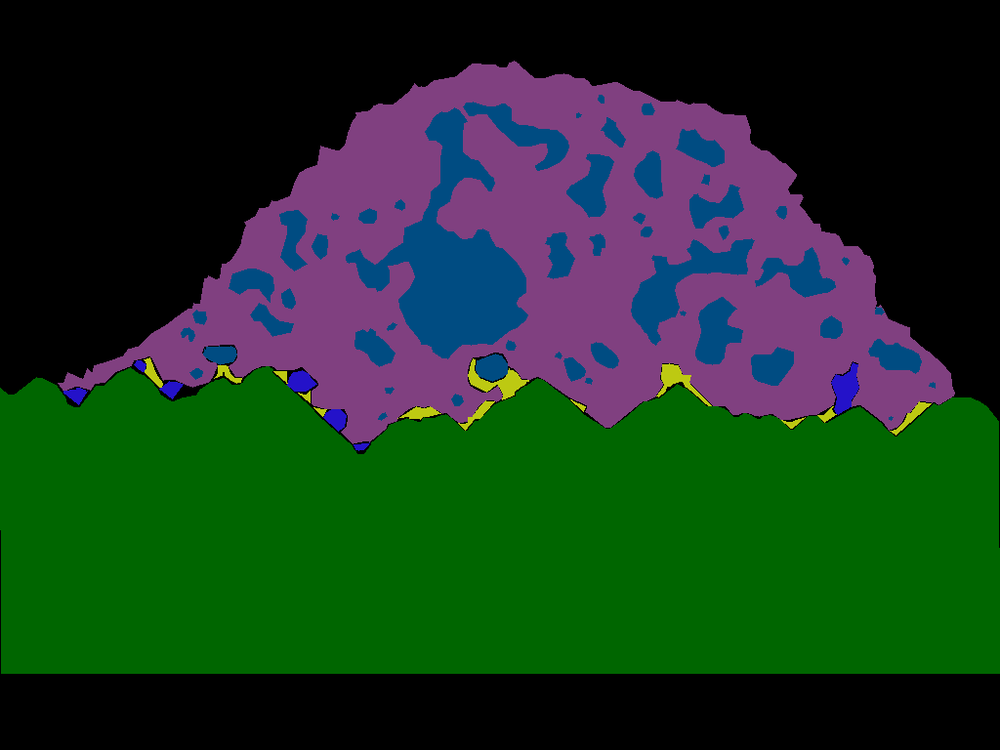

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


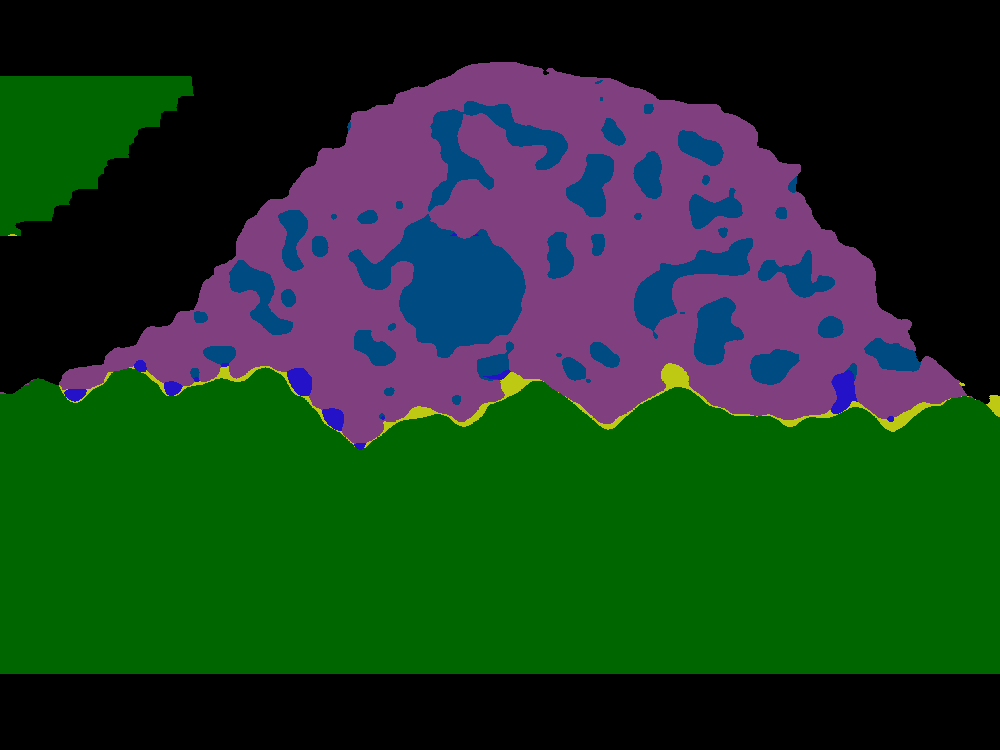

[0.78095238 0.99872611 0.87573964 0.79192938 0.98009188 0.96341463]
VCADControl.C17CR11.c4.1.png


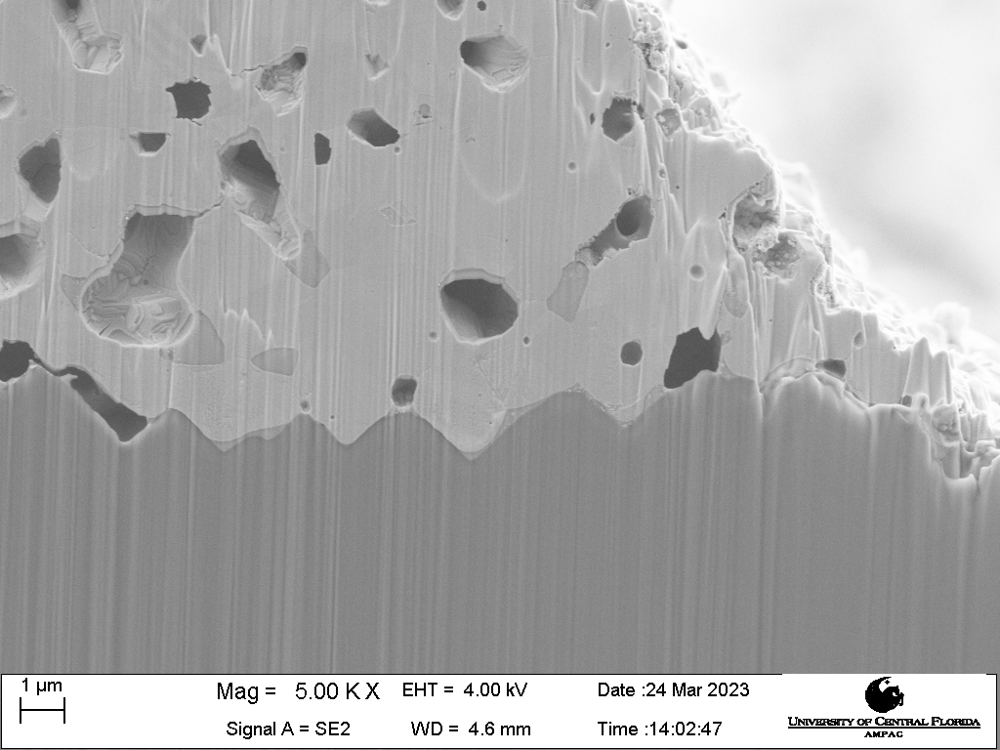

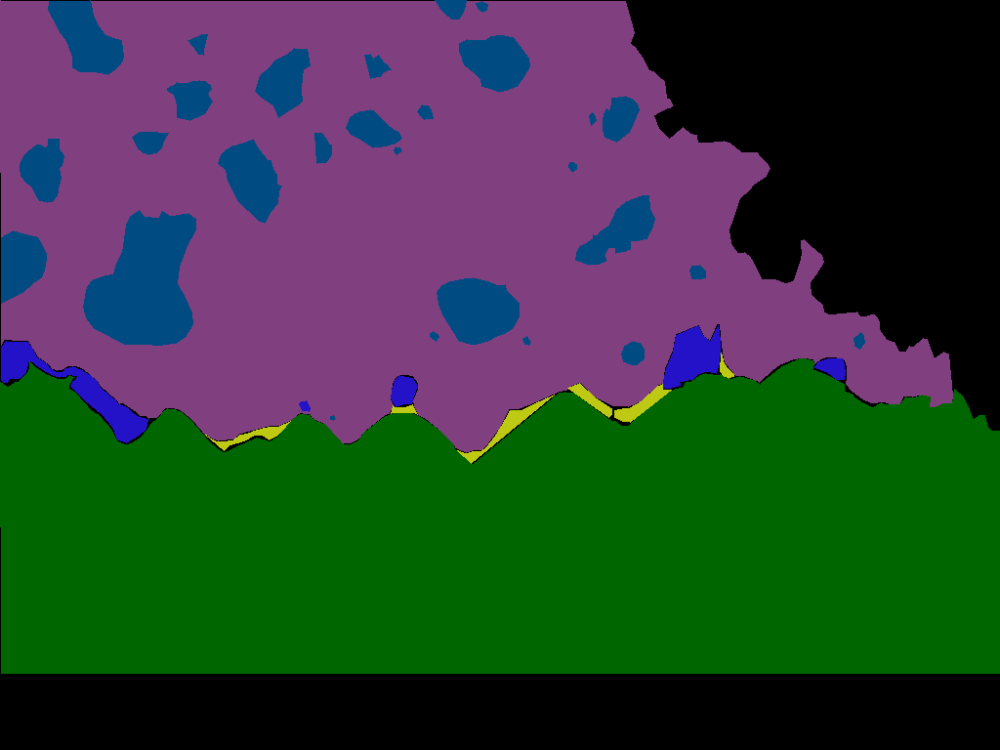

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


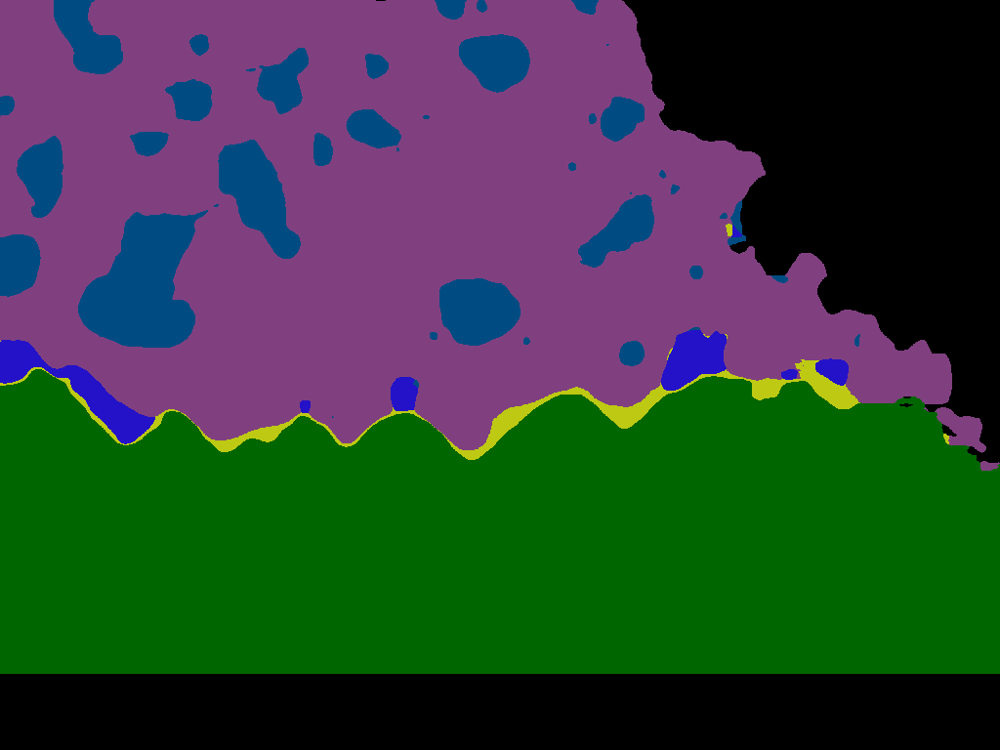

[0.87968127 0.98933902 0.86885246 0.98267717 0.98172324 0.92430279]
VCADControl.C17BB21.c2.1.png


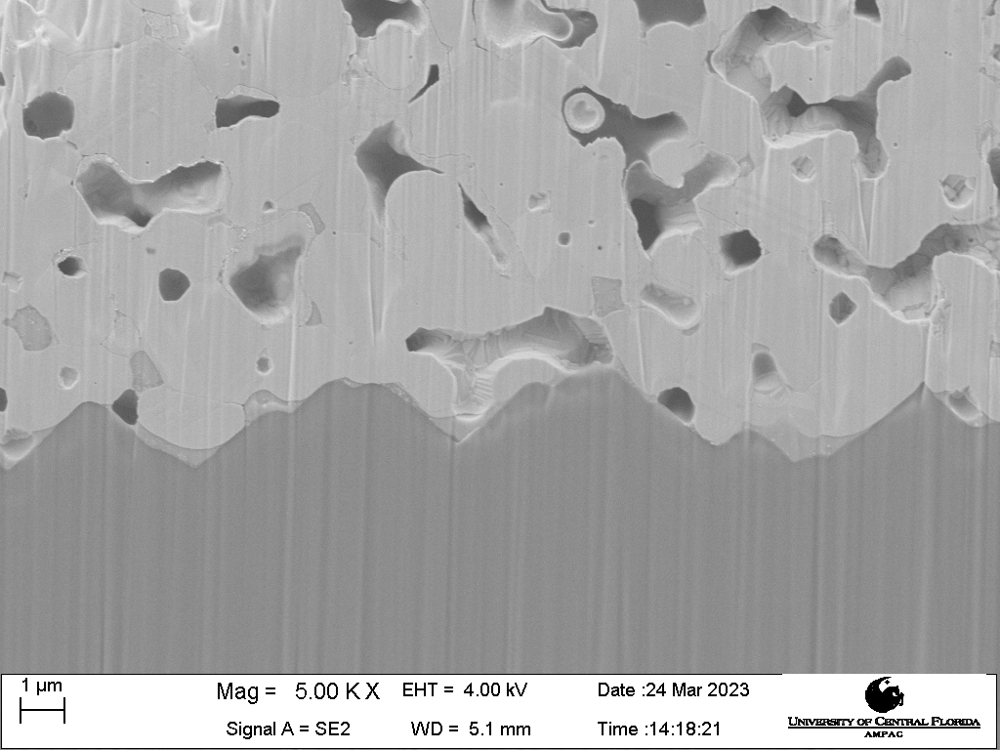

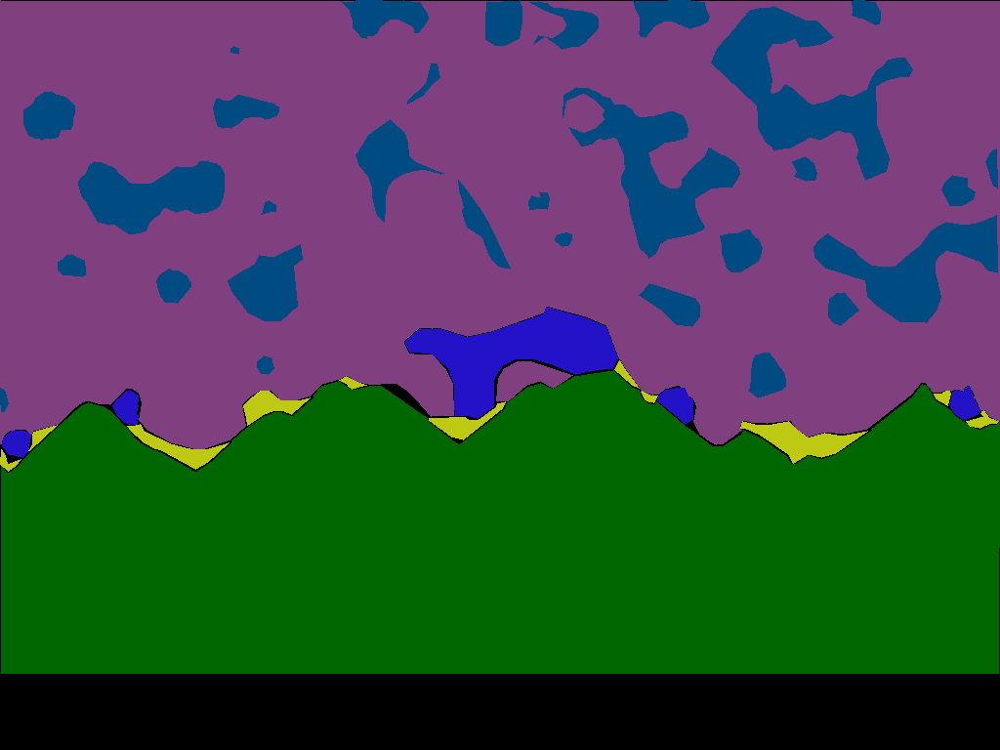

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


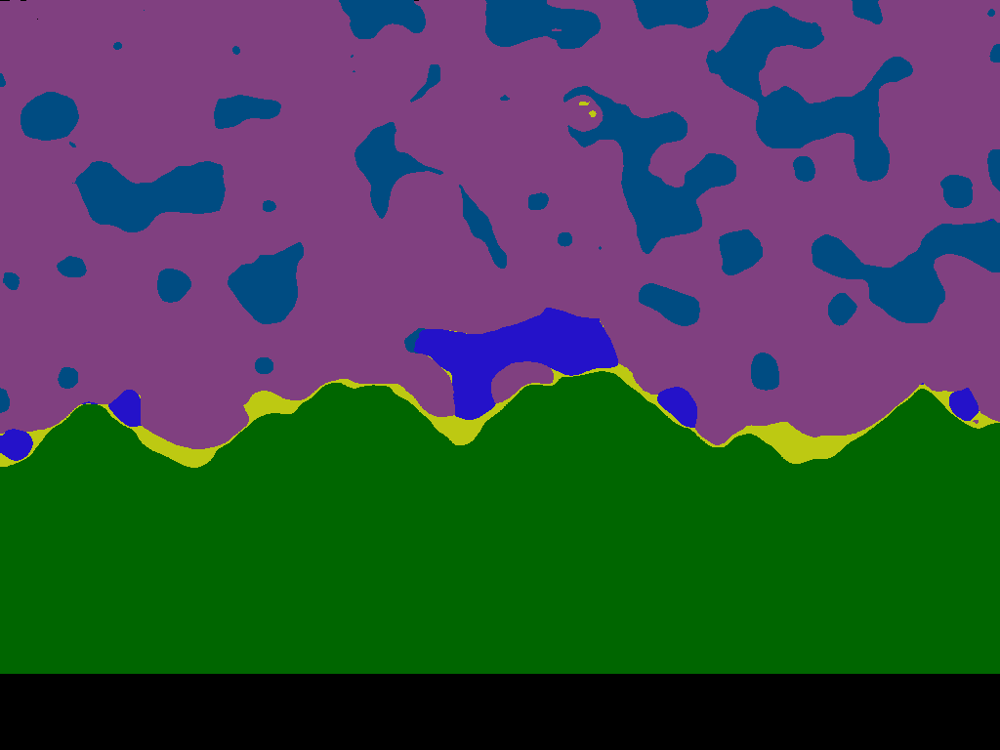

[0.29699248 1.         0.87966805 0.99838969 0.96695226 0.97402597]
VCADControl.C17BB21.c1.1.png


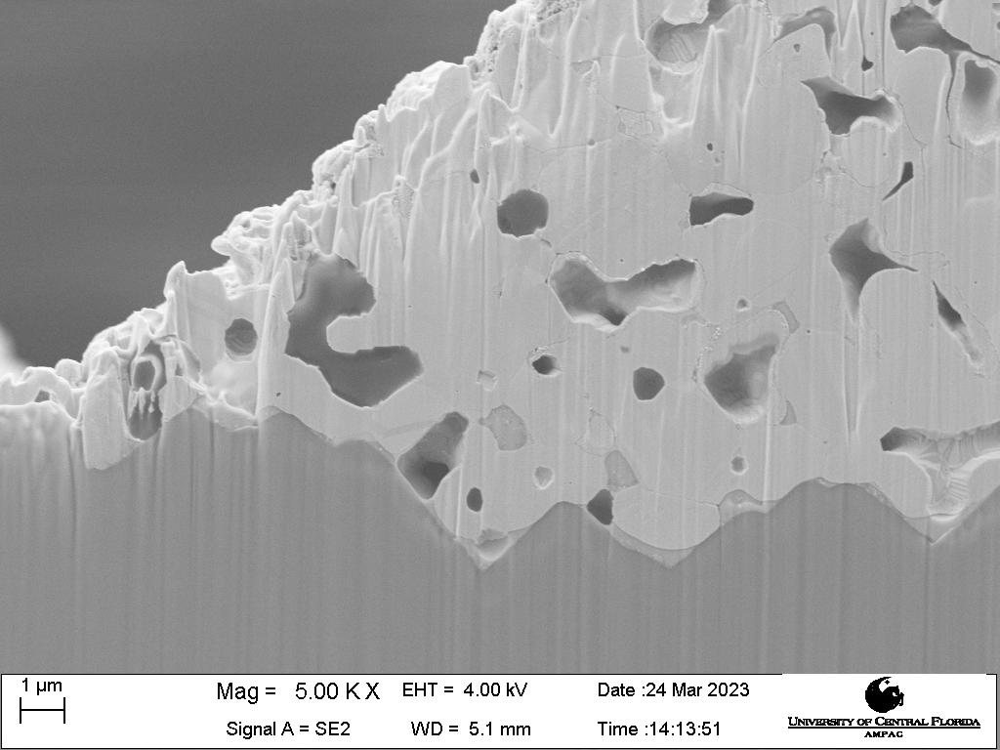

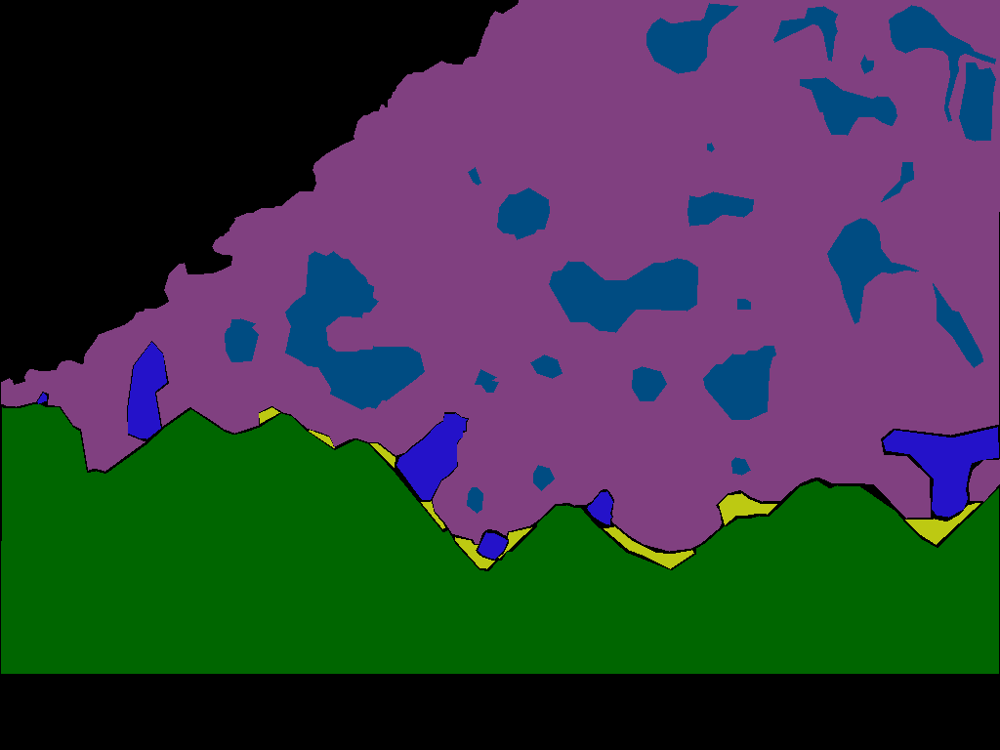

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


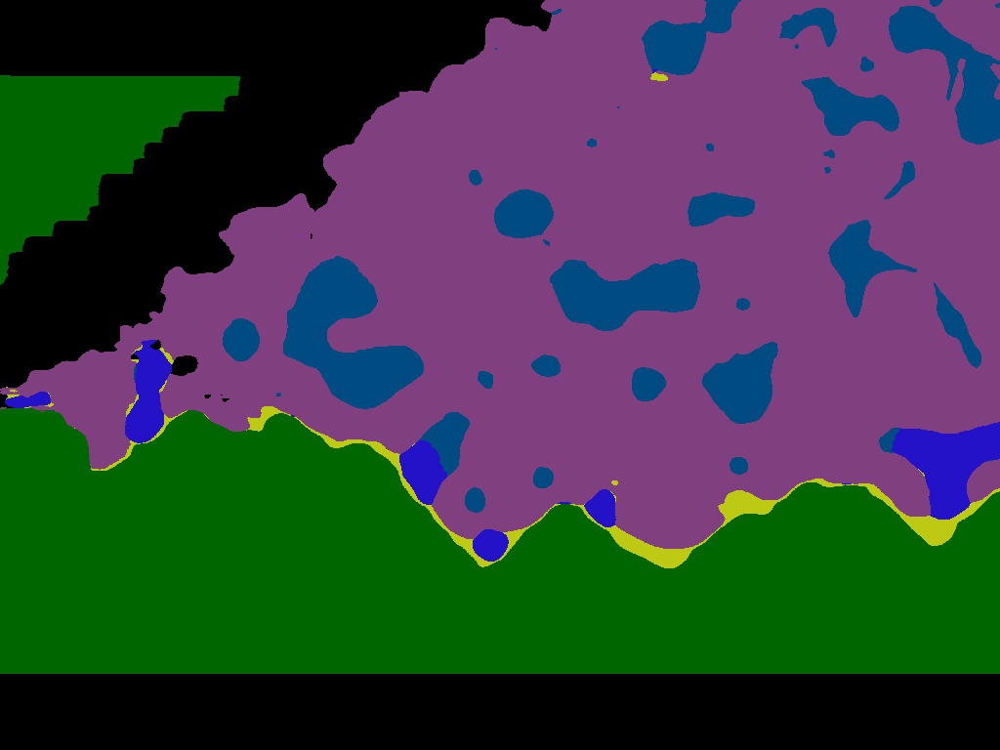

[0.78095238 0.99733807 0.74509804 0.7129751  0.9497992  0.97078652]
VCADPERC.C33CR2.c1.2.png


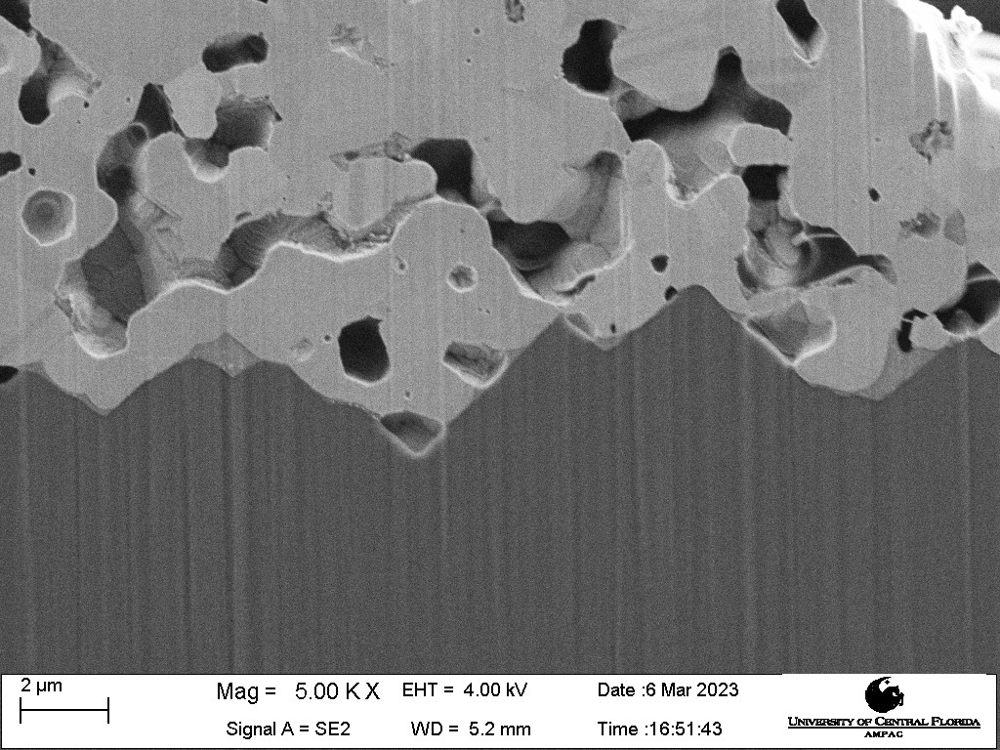

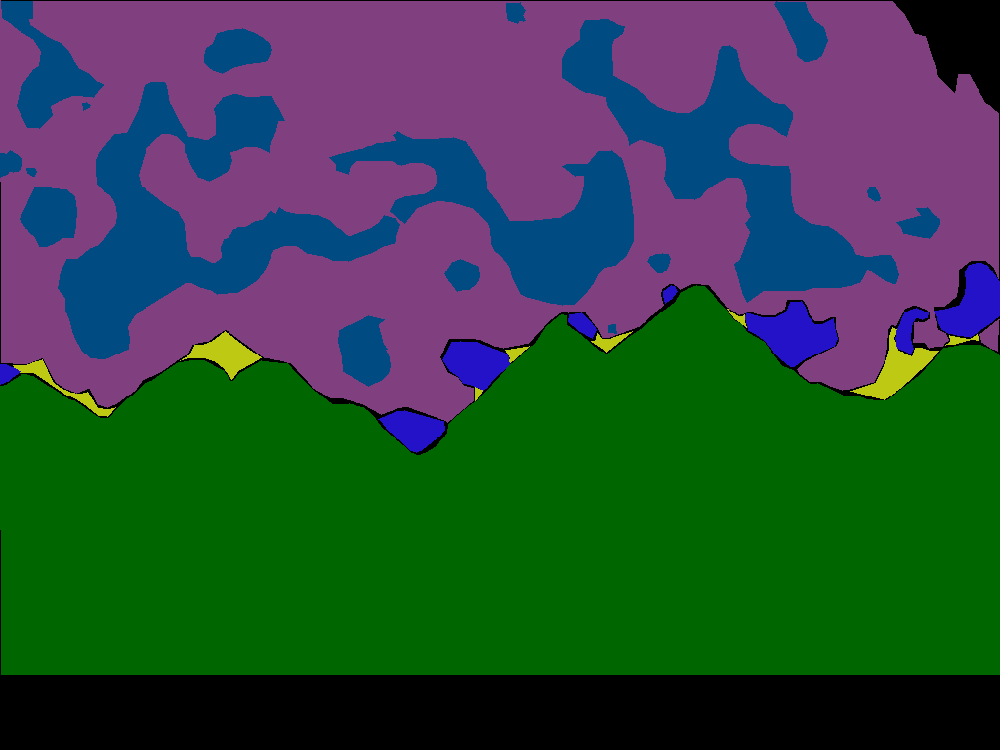

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


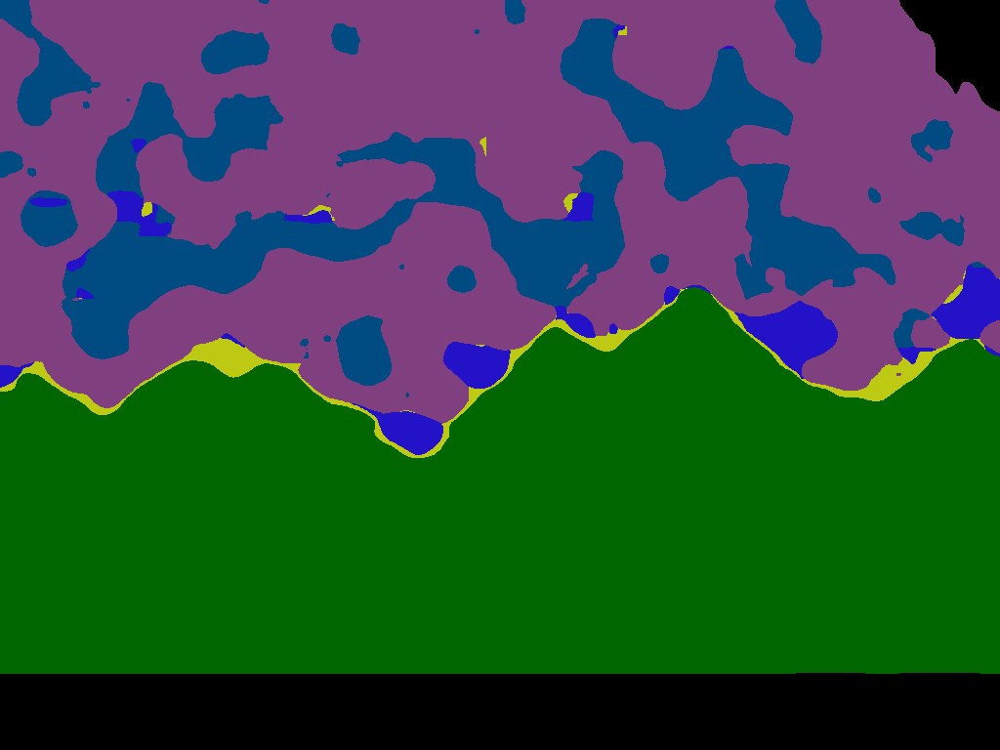

[0.43665158 0.9988466  0.62535211 0.99622642 0.99119497 0.77333333]
VCADPERC.C33CR2.w2.2.png


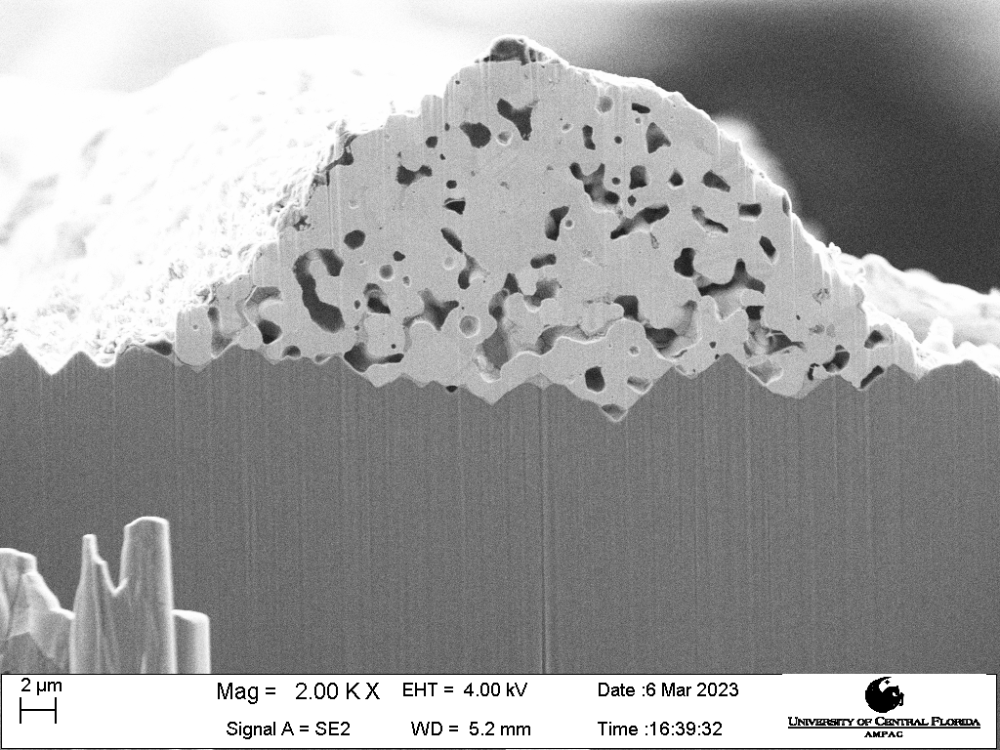

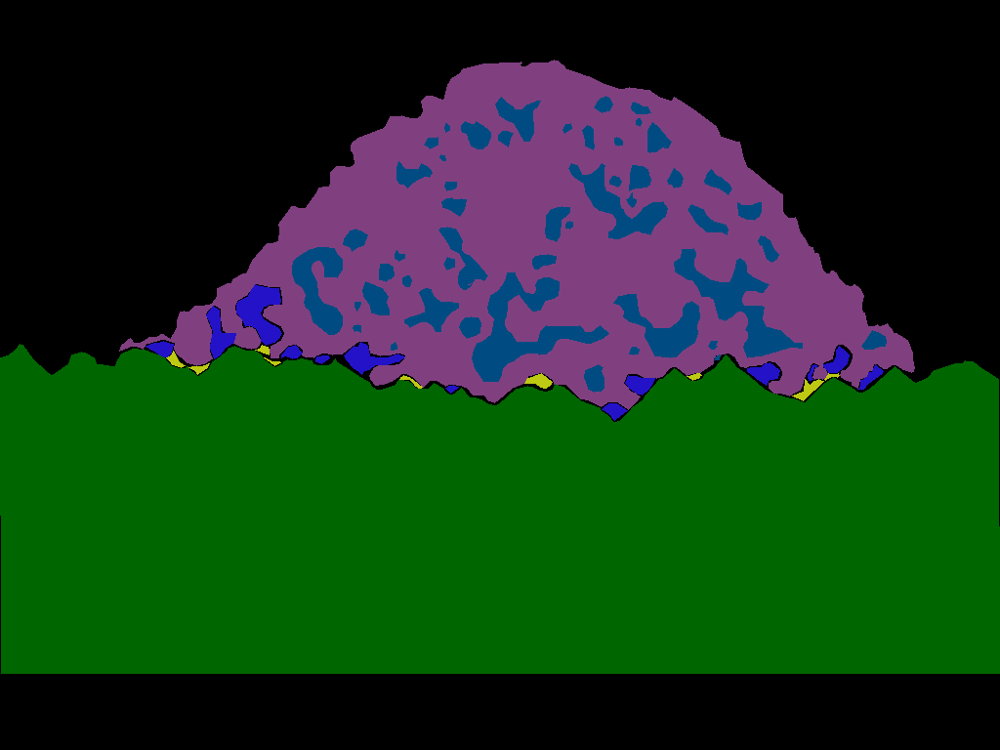

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


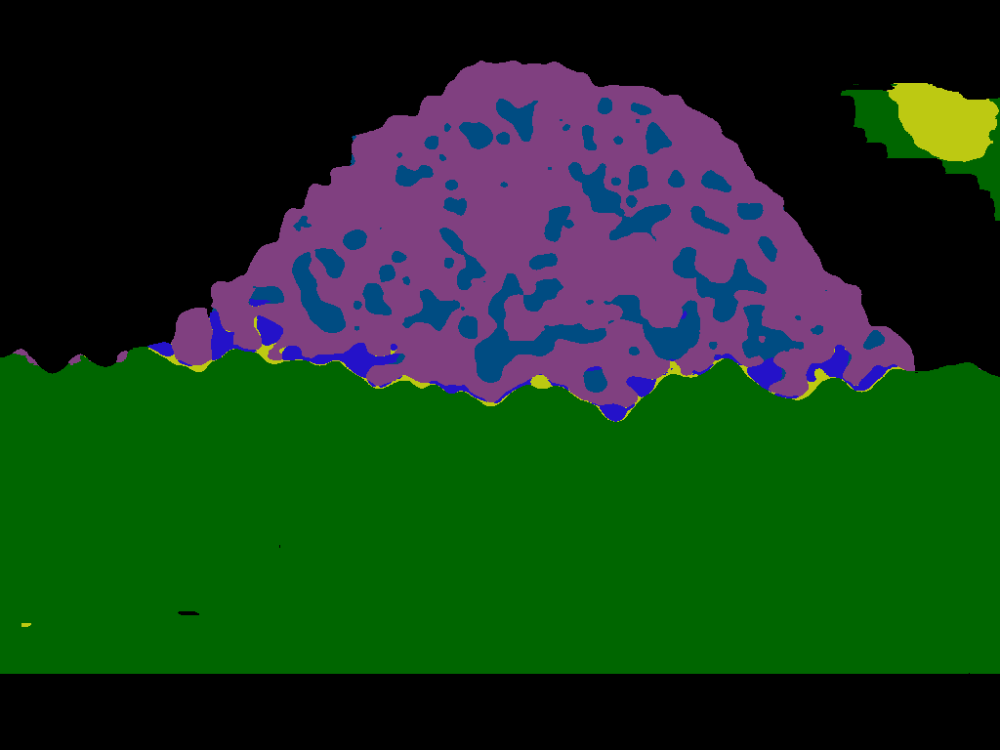

[0.76129032 0.99439776 0.47346939 0.82818294 0.99504132 0.88976378]
VCADControl.C17CR11.c3.1.png


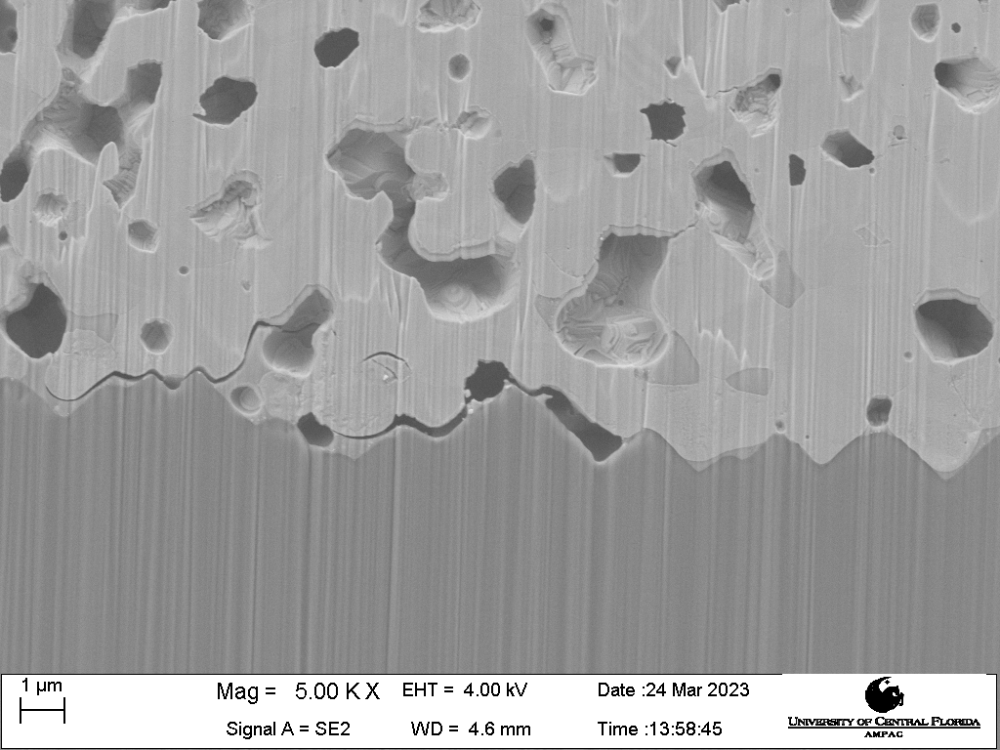

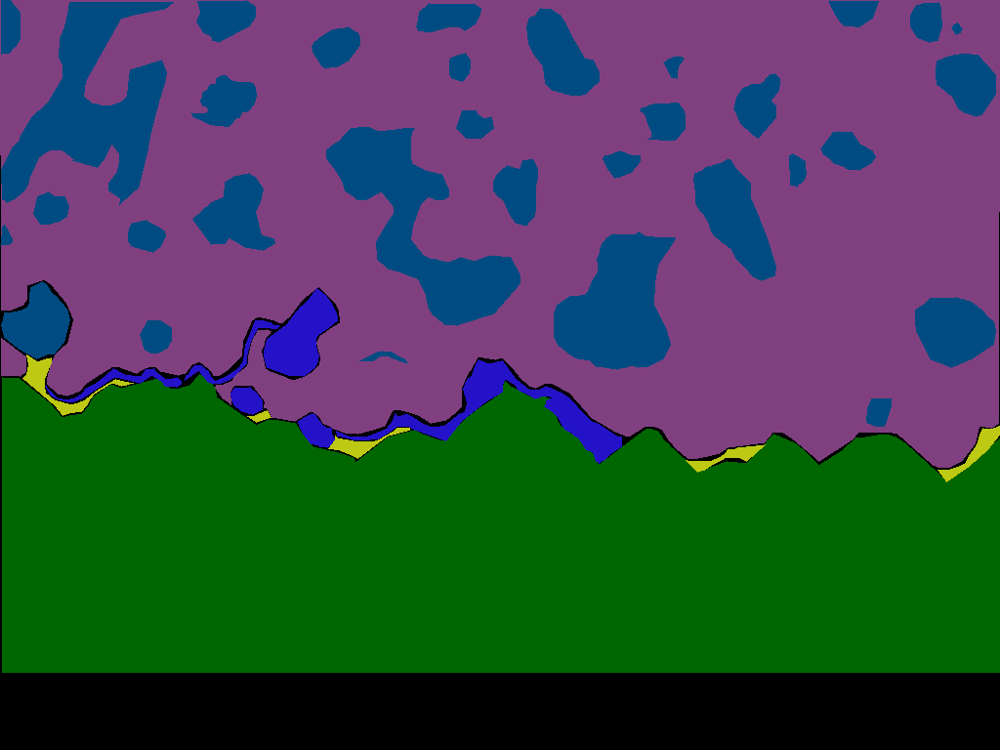

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


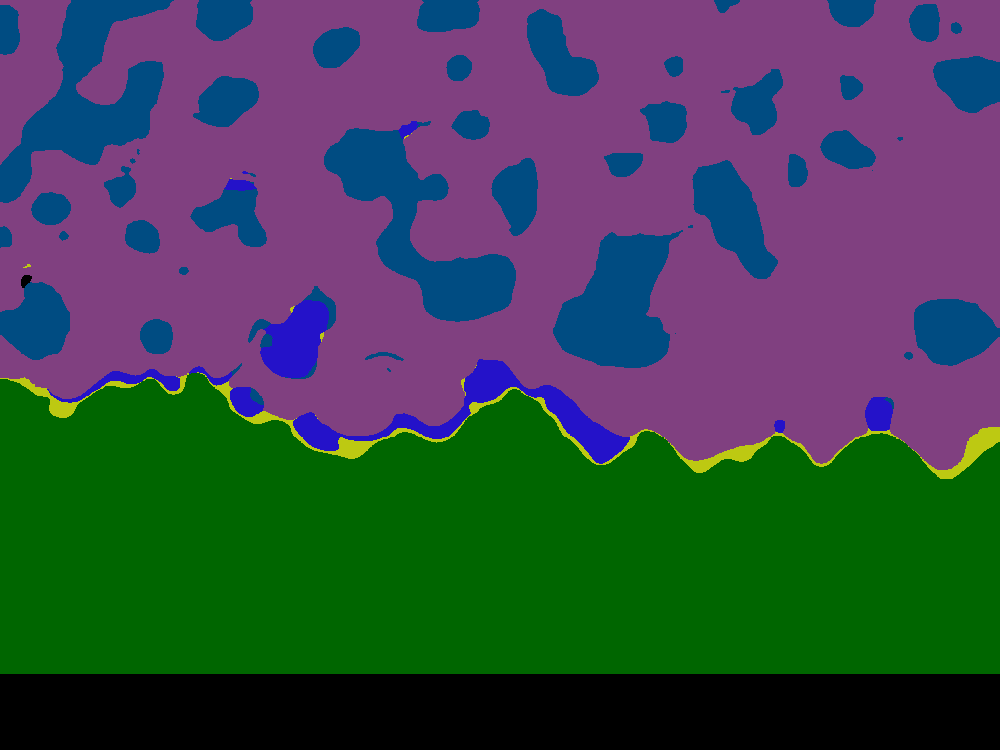

[0.26       0.99791667 0.81343284 0.99674267 0.95121951 0.87958115]
Yingli.C36BB21.w1.5.png


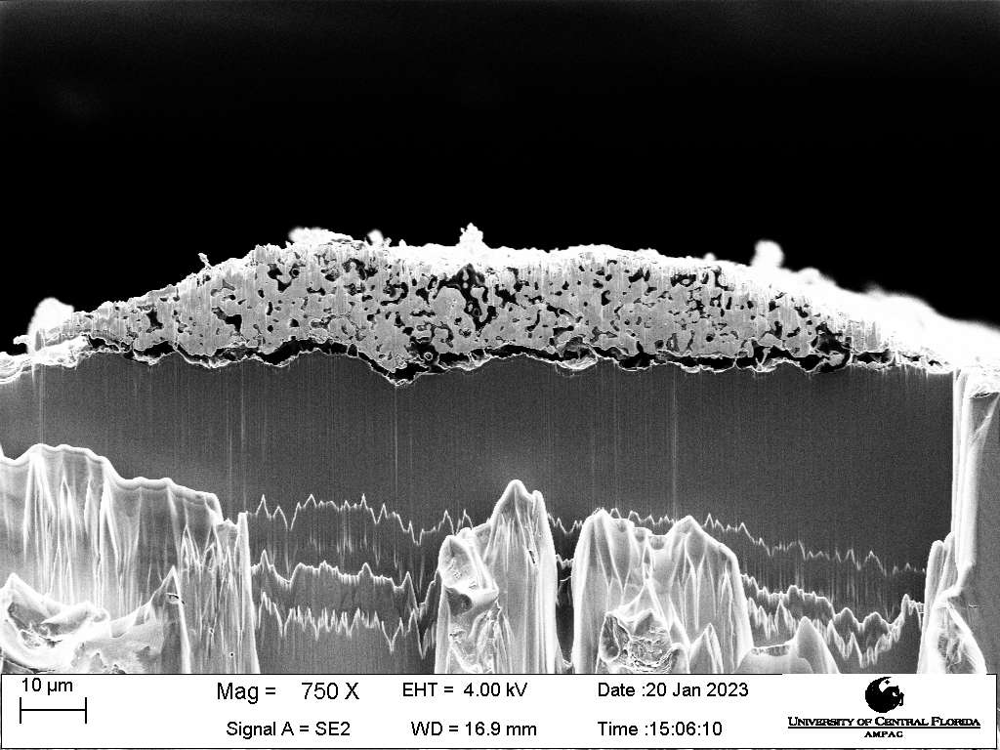

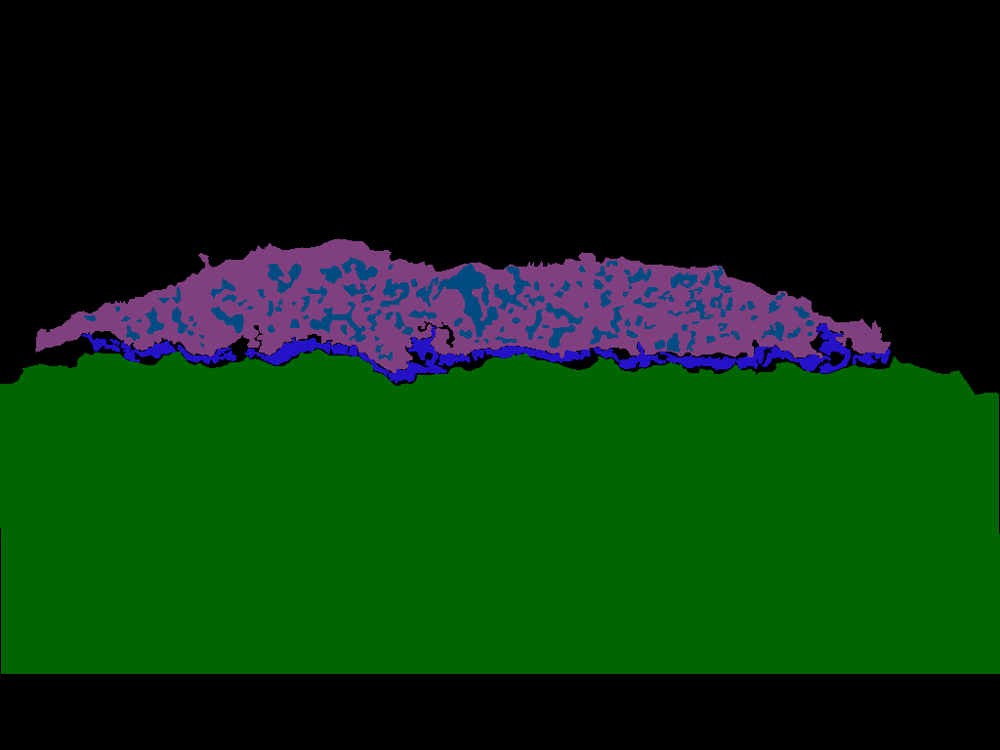

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


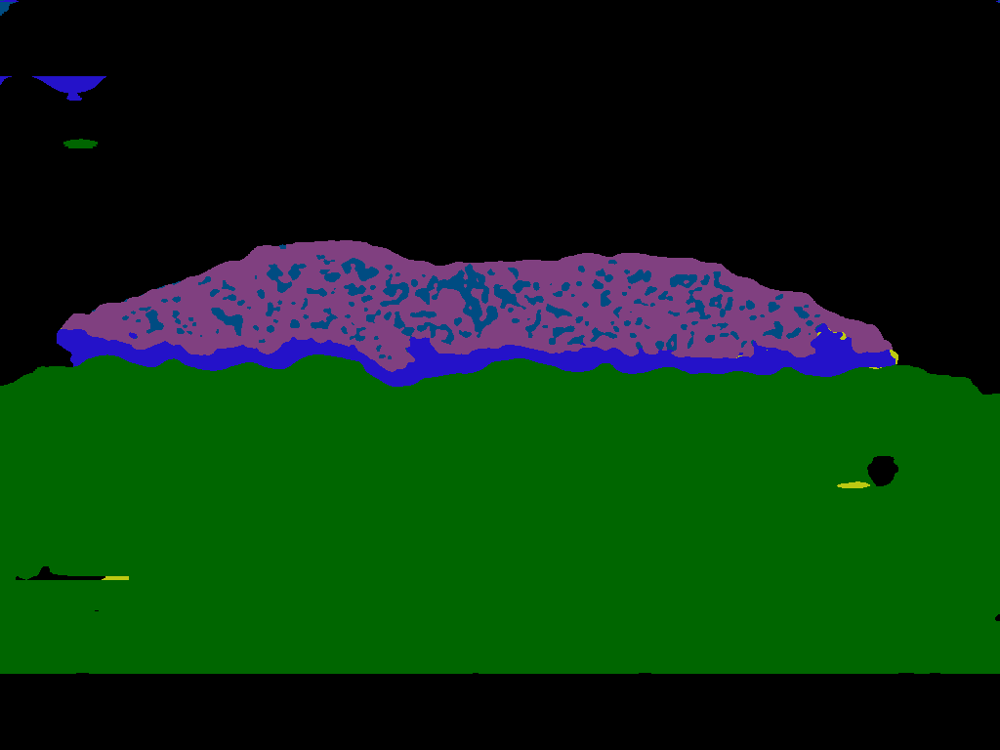

SLTE.C36BB21.w6.2.jpg


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


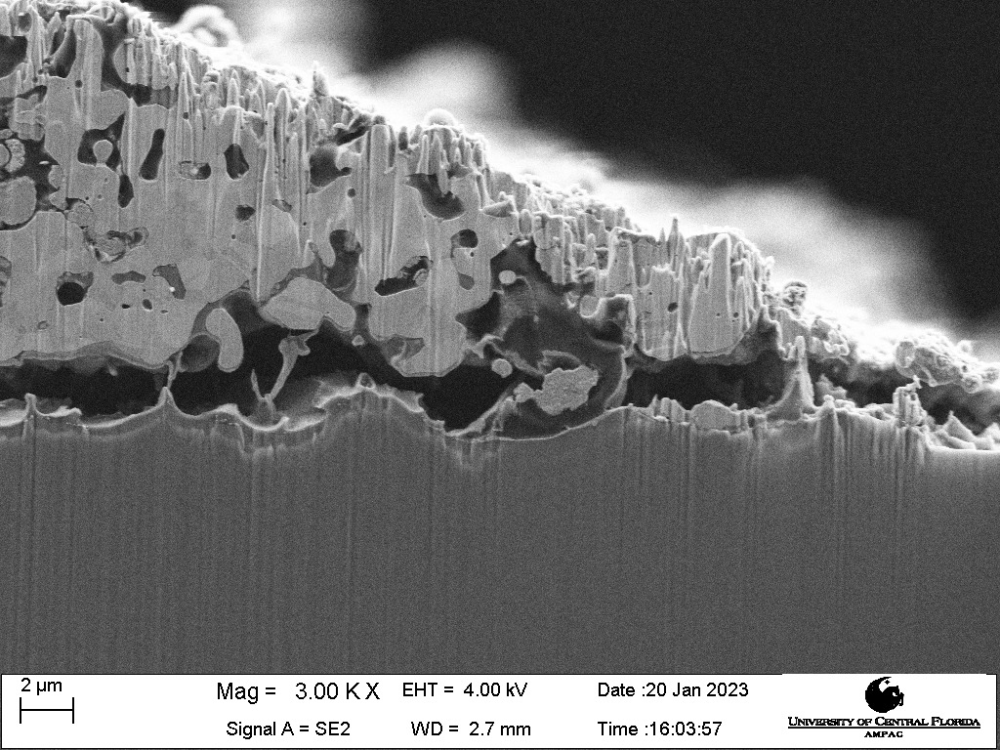

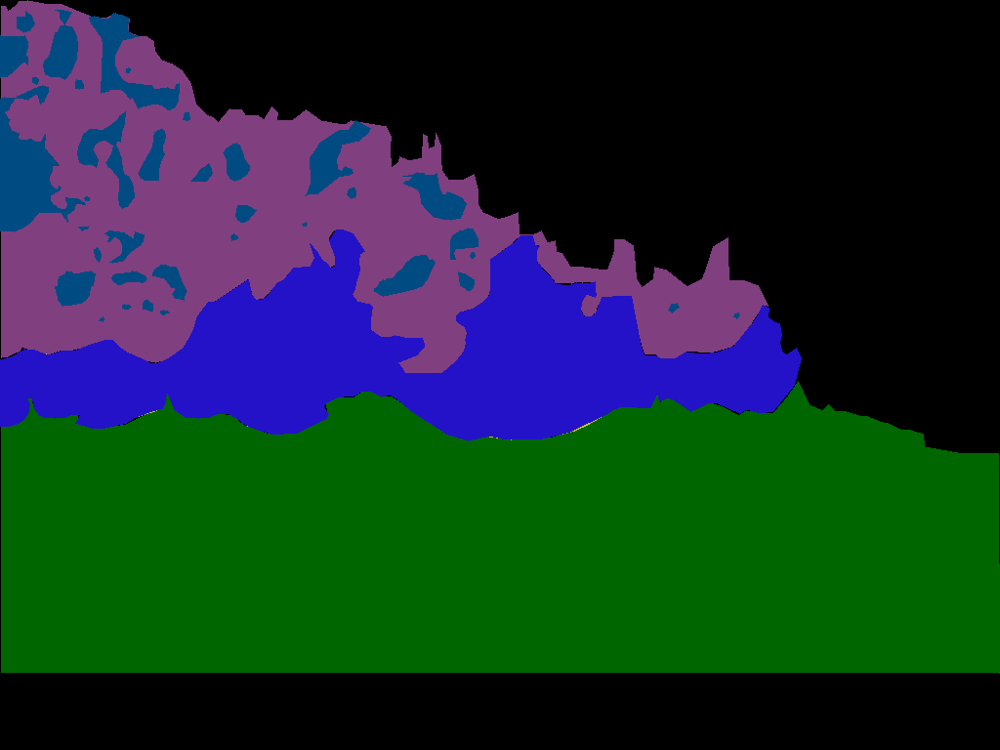

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


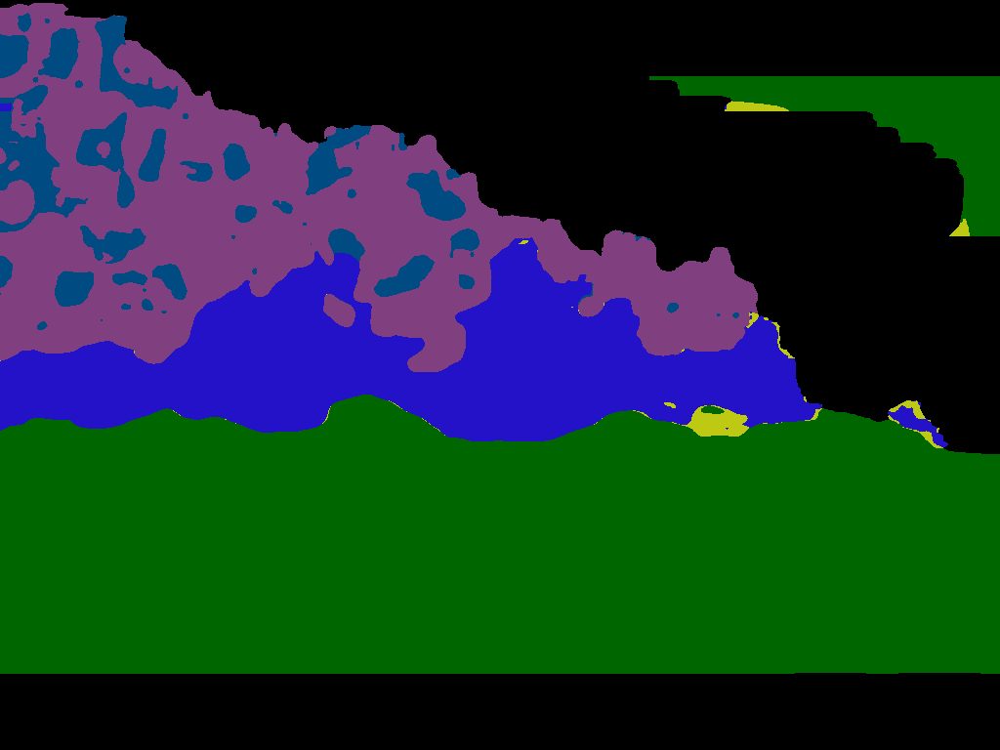

[0.82926829 0.99473684 0.3372093  0.76266667 0.97388633 0.9478458 ]
SLTE.C46CR11.c3.2.png


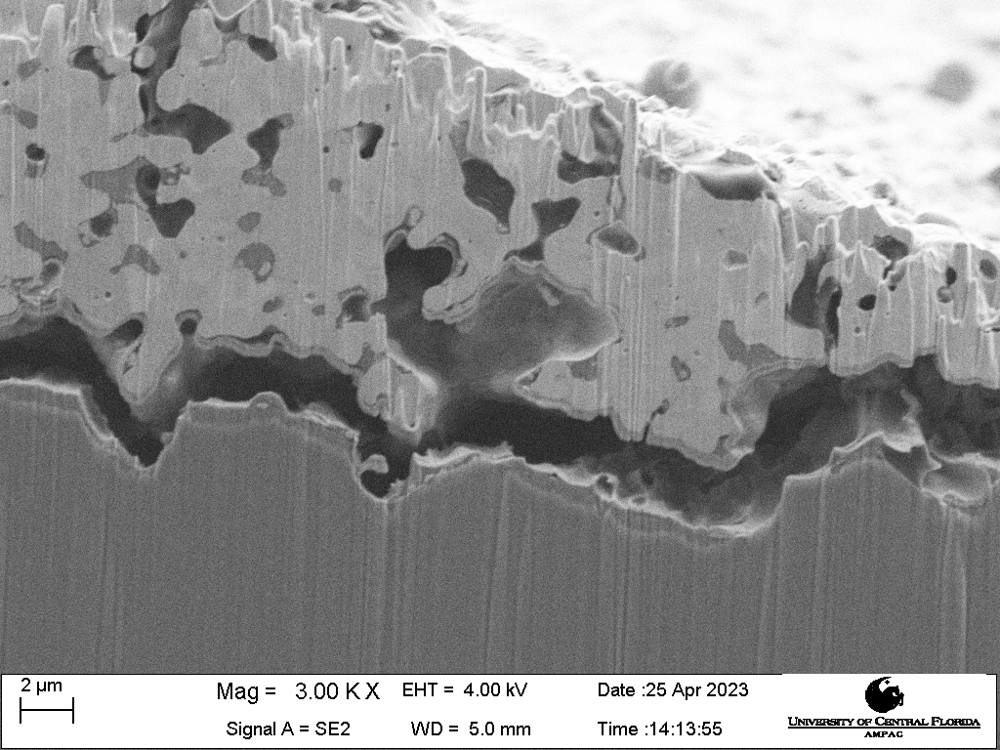

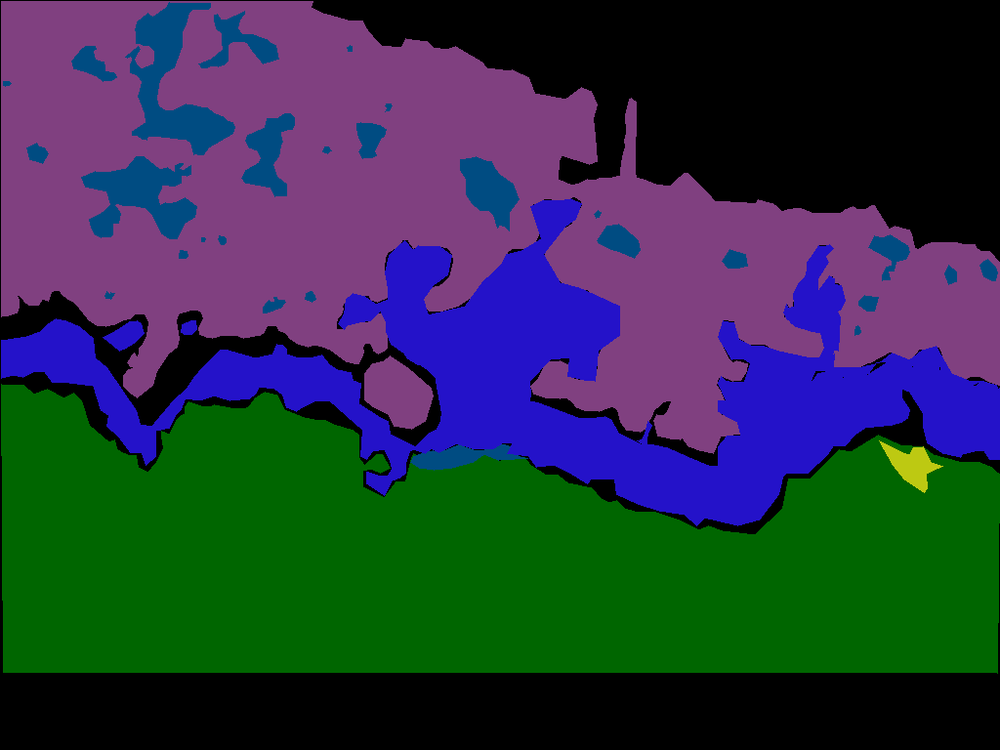

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


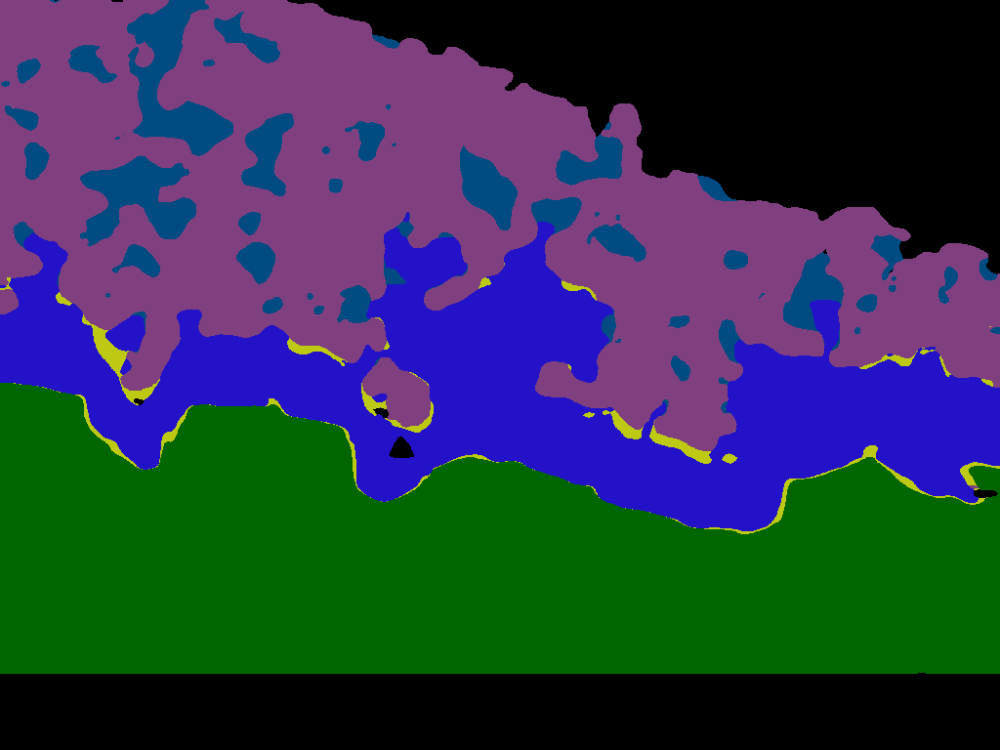

[0.69387755 0.99139785 0.3483871  0.99831933 0.8503937  0.97134238]
SLTE.C36BB21.w4.2.jpg


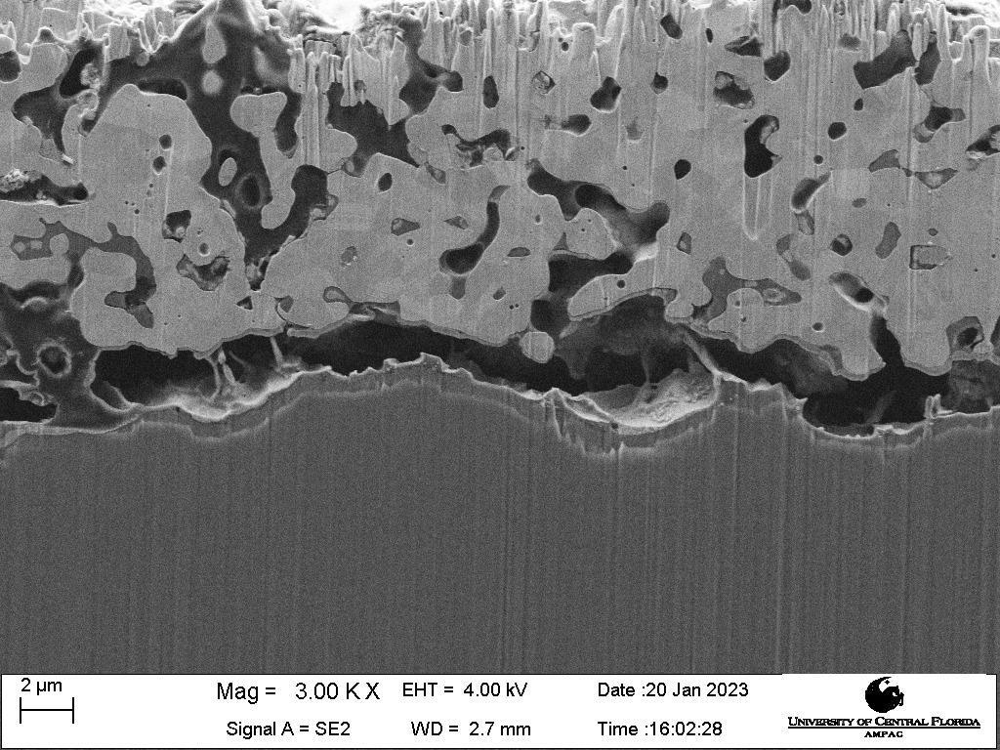

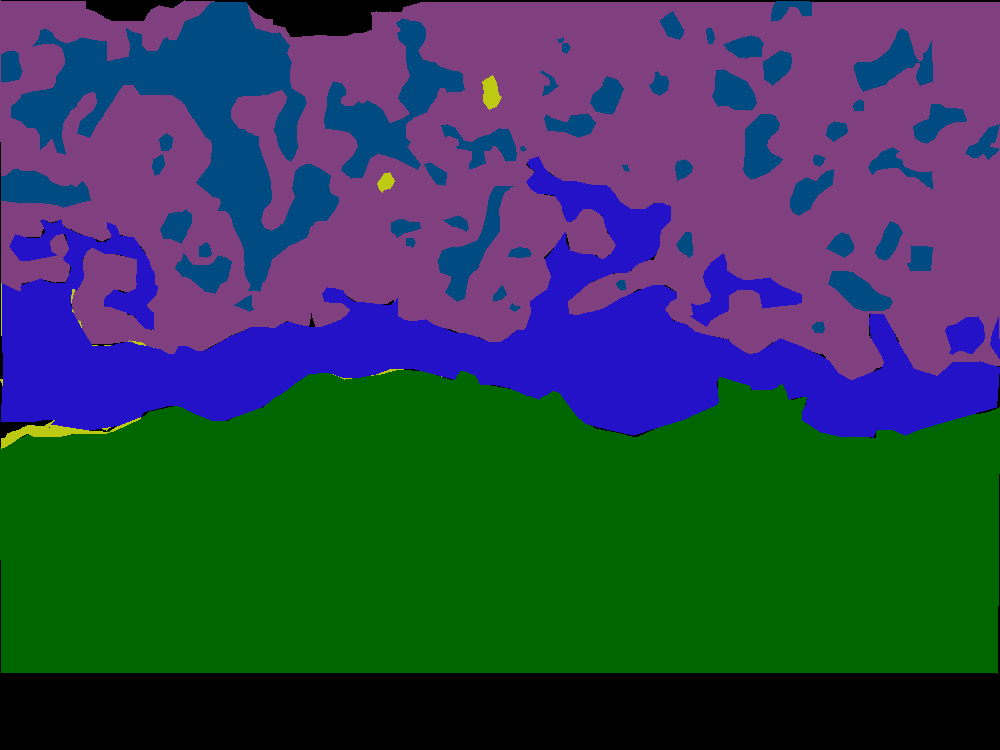

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


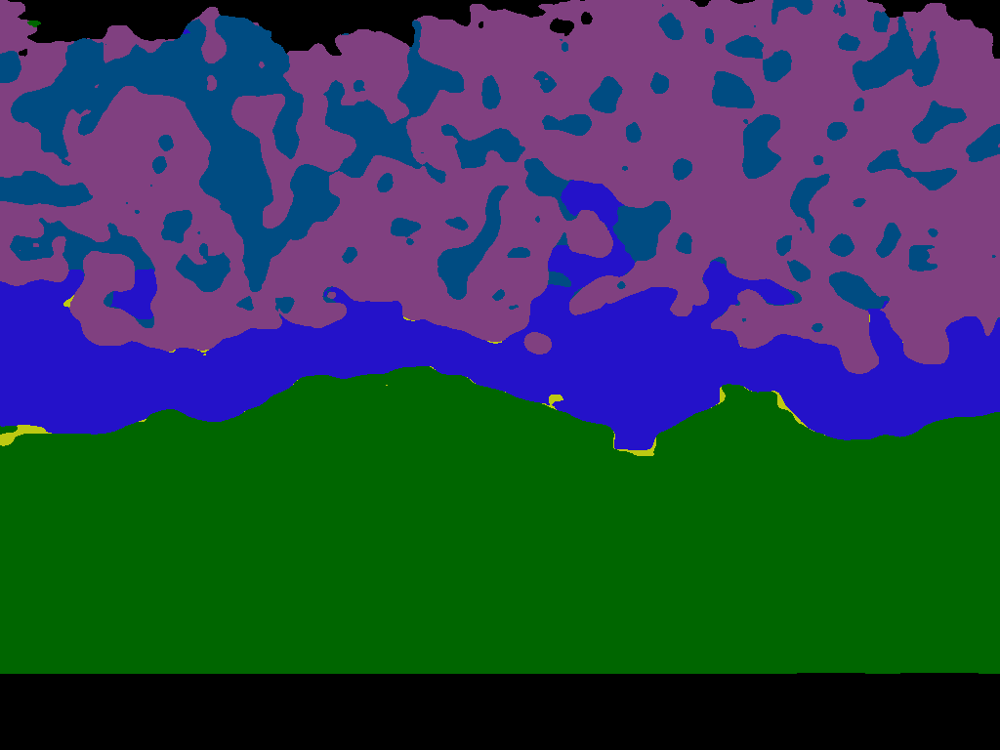

[0.30271669 0.99222798 0.47349823 0.98262243 0.98062593 0.92819615]
SLTE.C46CR11.c1.2.png


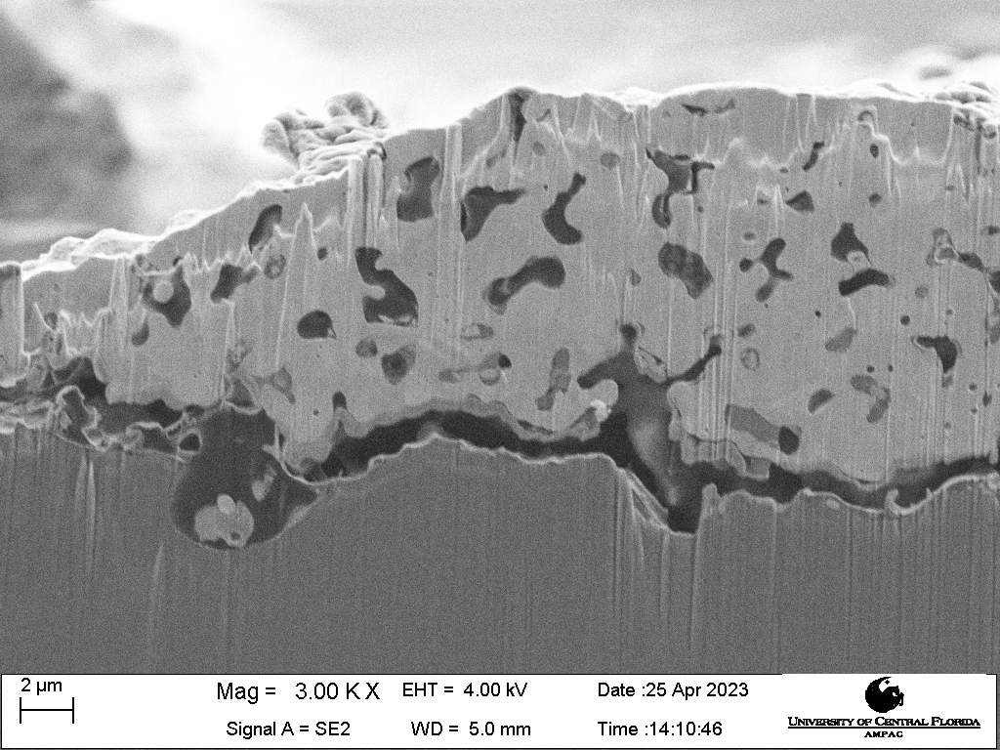

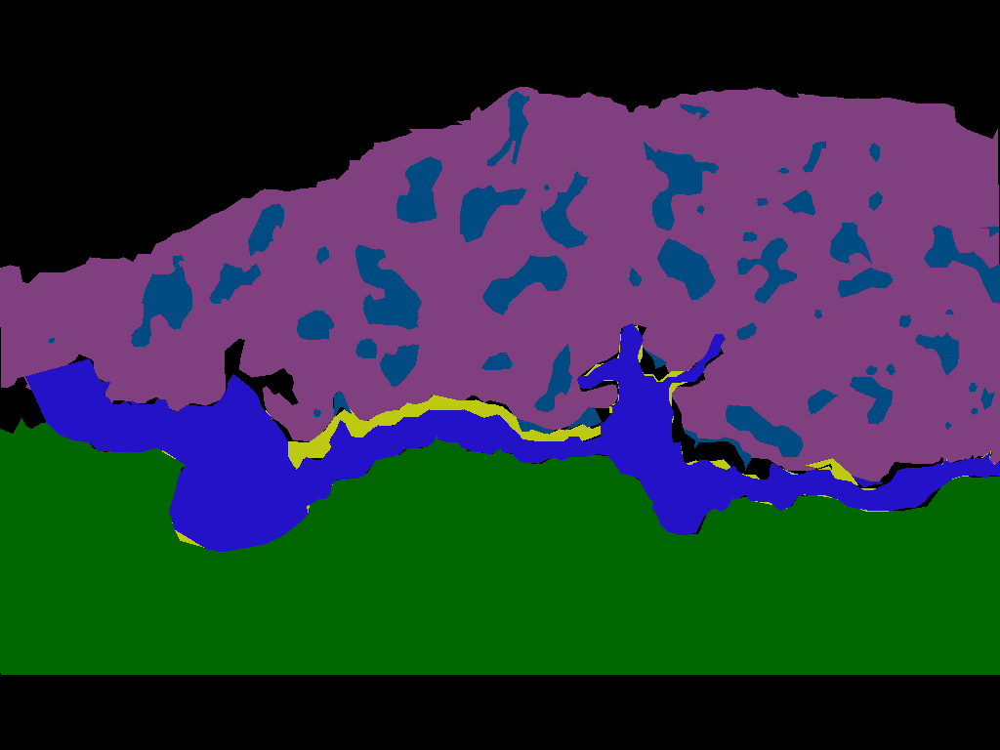

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


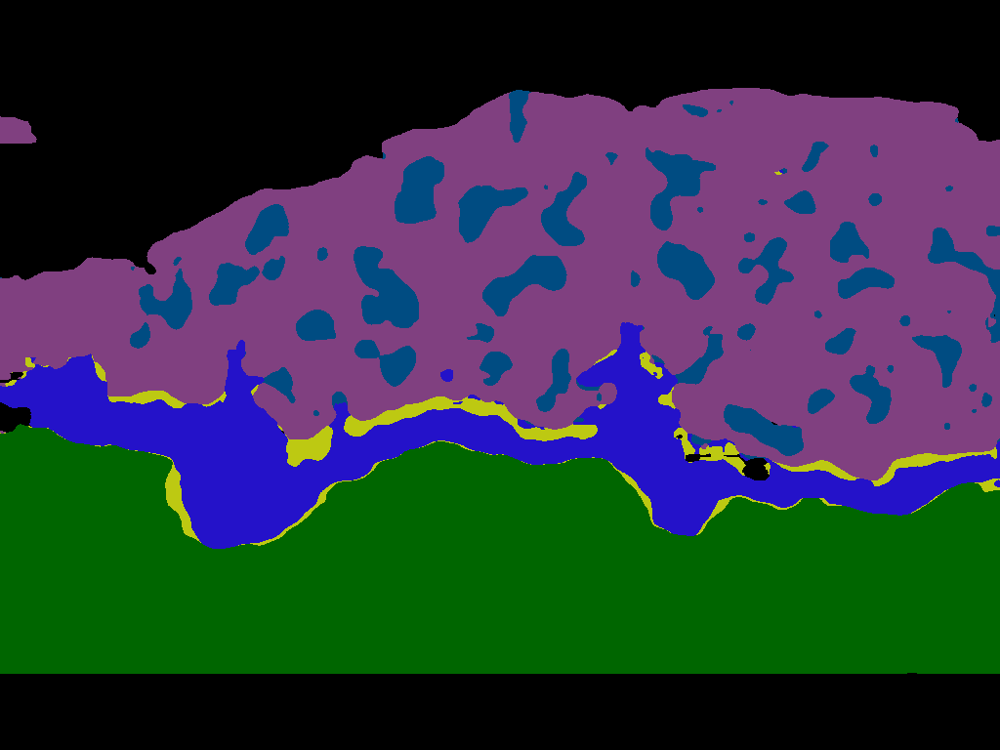

[0.86105675 0.99751861 0.87218045 0.98651252 0.98305085 0.98089172]
SLTE.C17CRA2.c4.1.png


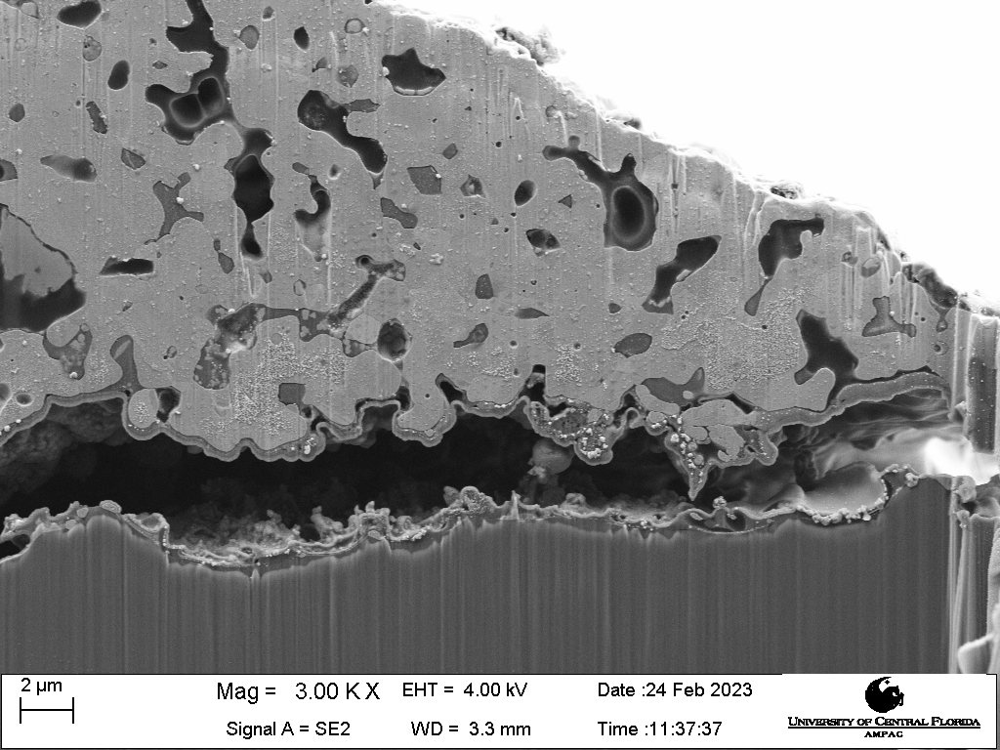

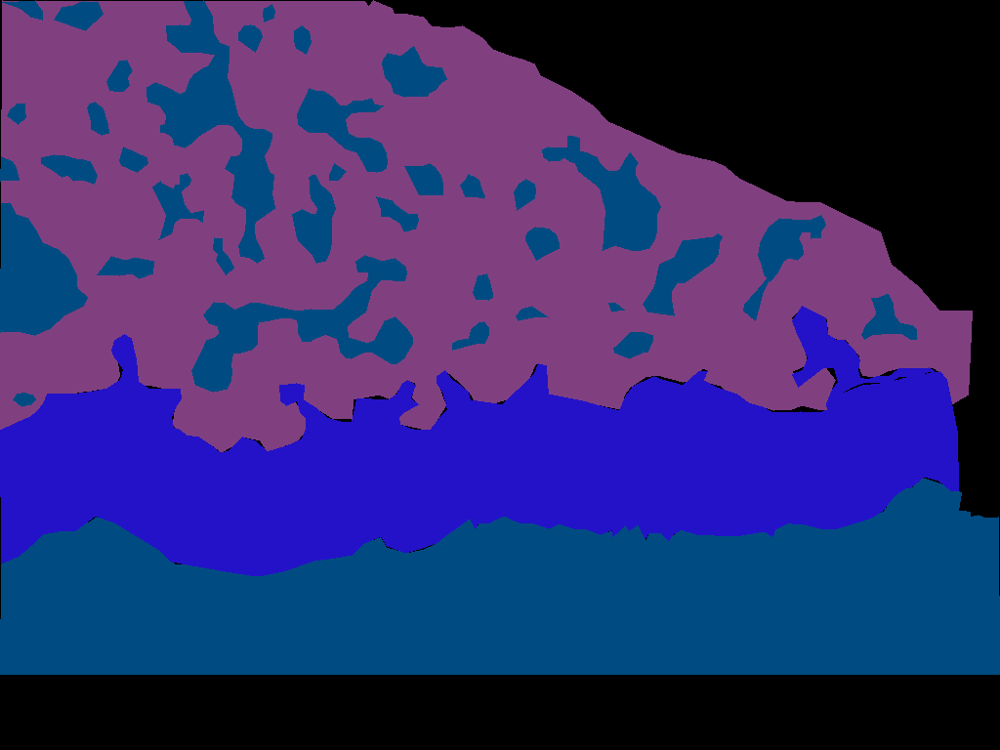

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


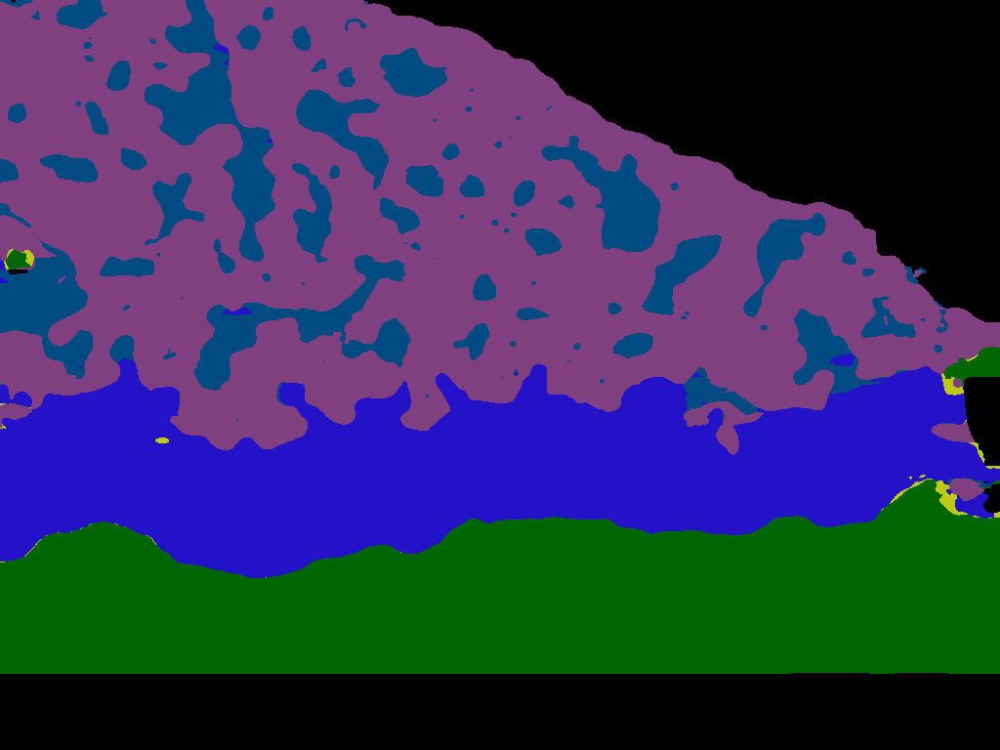

SLTE.C36BB21.w3.2.jpg


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2, 3] will be ignored
  warnings.warn(


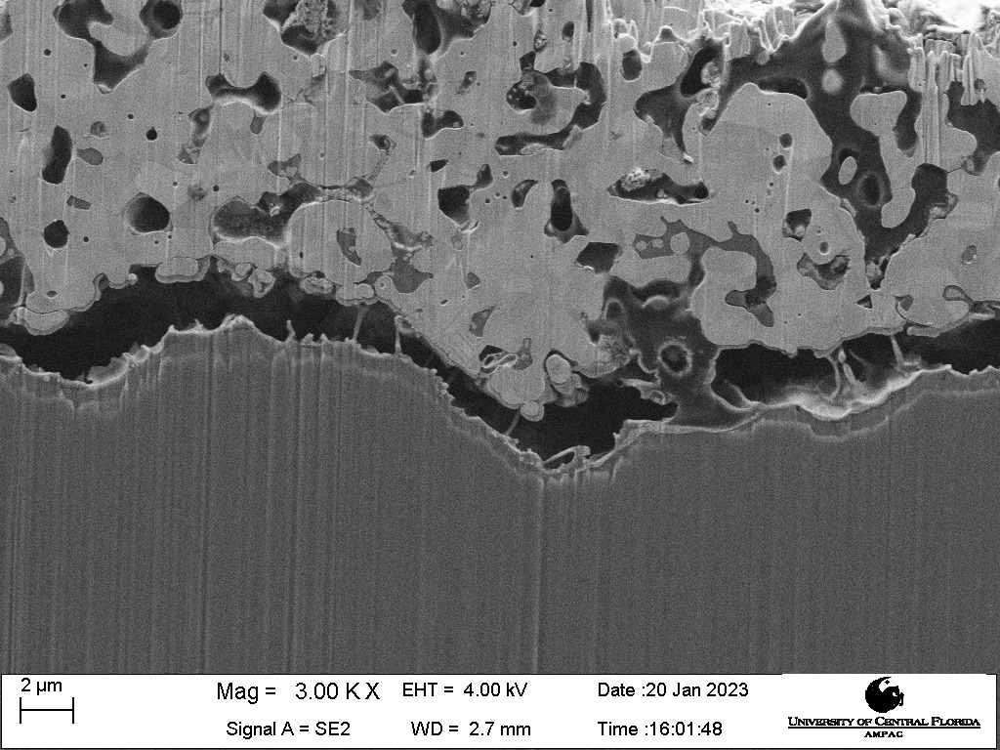

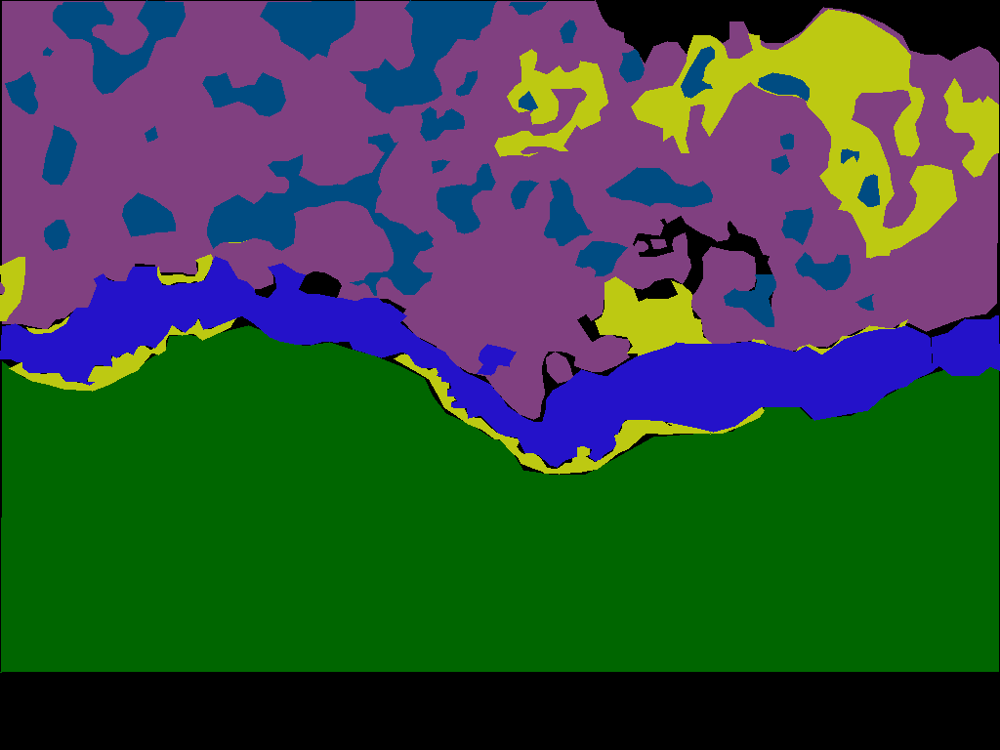

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


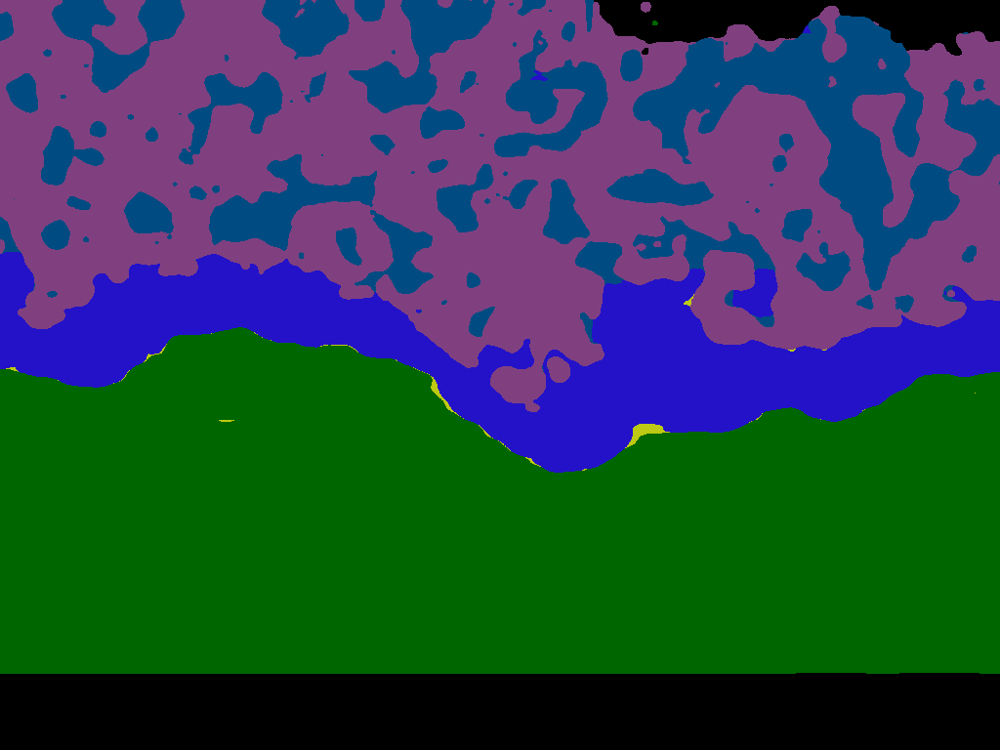

[0.30088496 0.99061033 0.4386252  0.98882682 0.96264368 0.93939394]
VCAD.C33BB21.w1.2.png


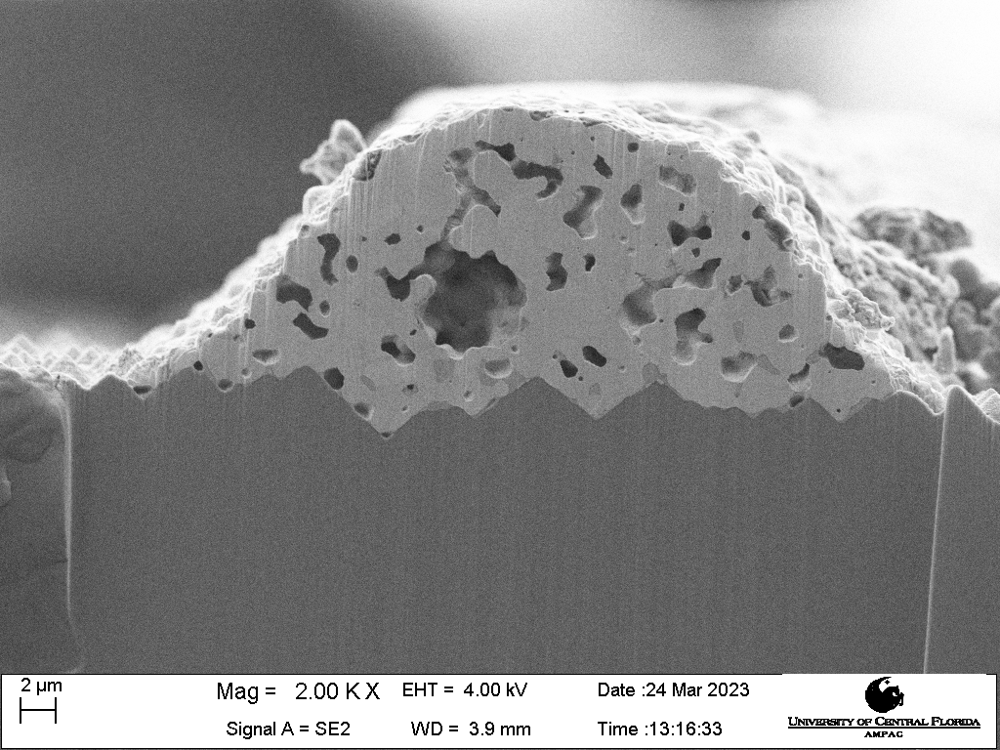

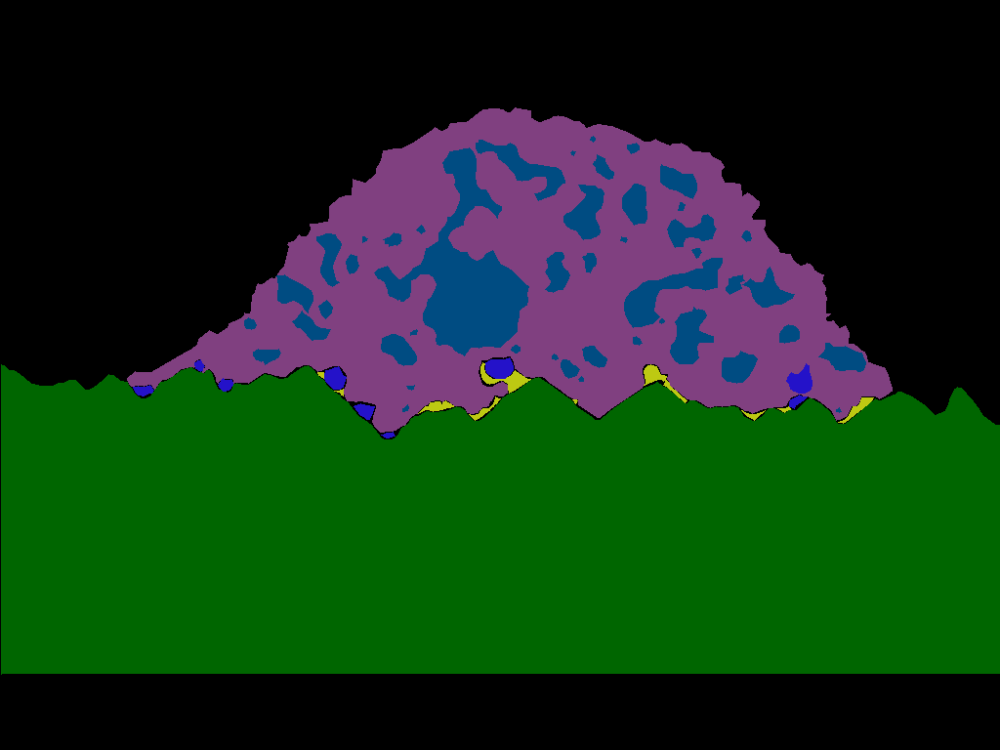

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


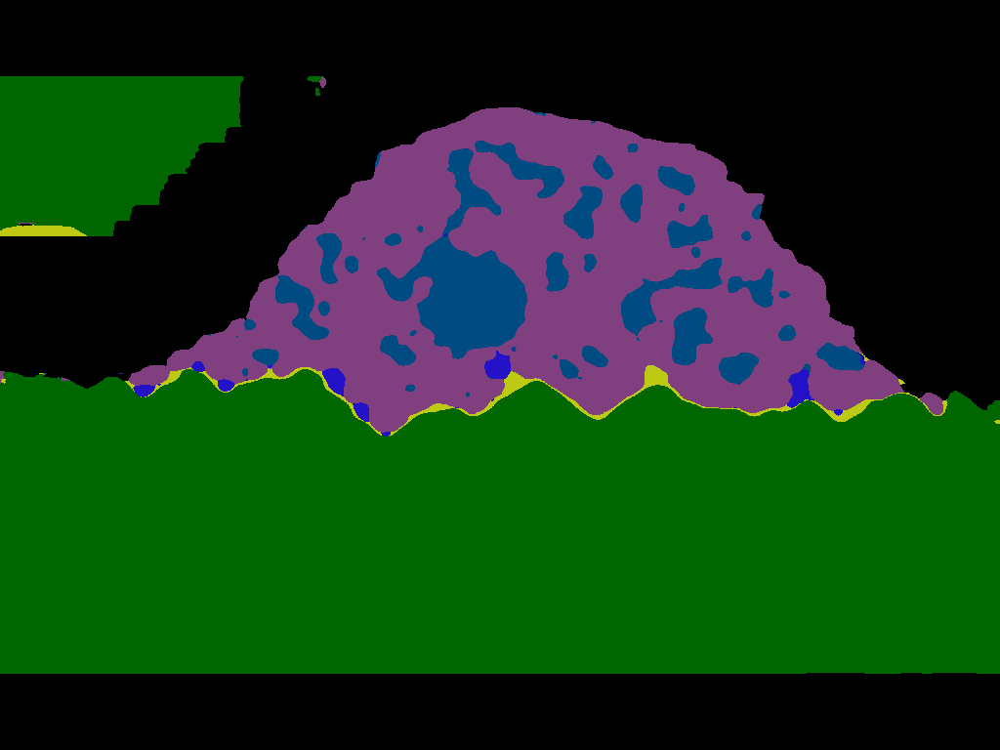

[0.78768745 0.98230088 0.76433121 0.78589421 0.94814815 0.89032258]
SLTE.C36BB21.w1.2.jpg


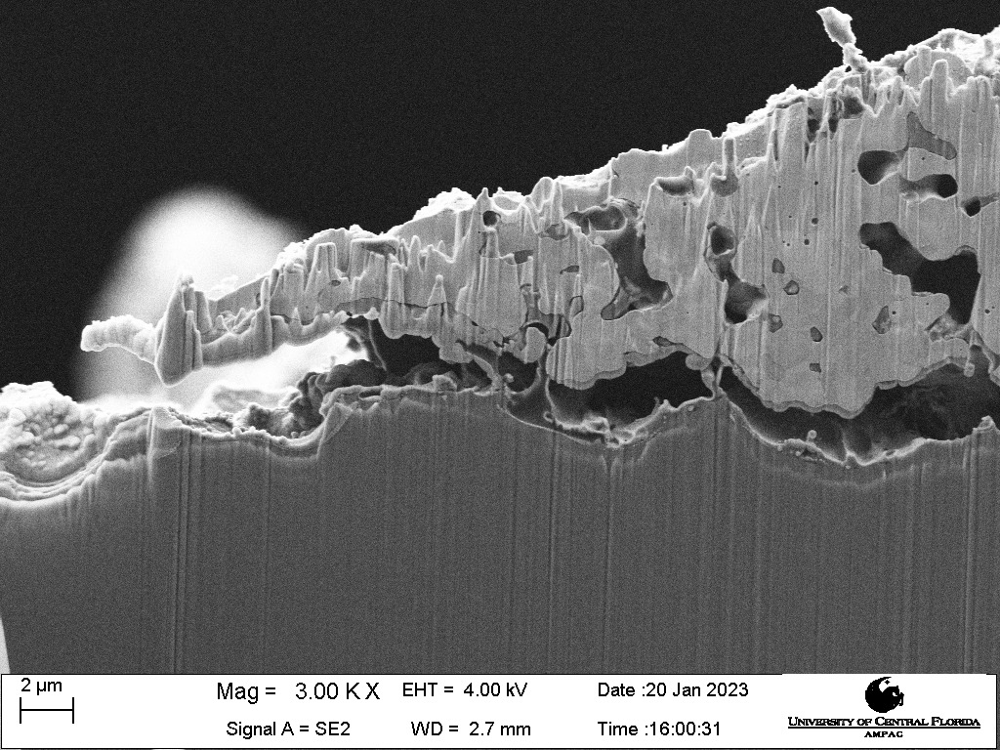

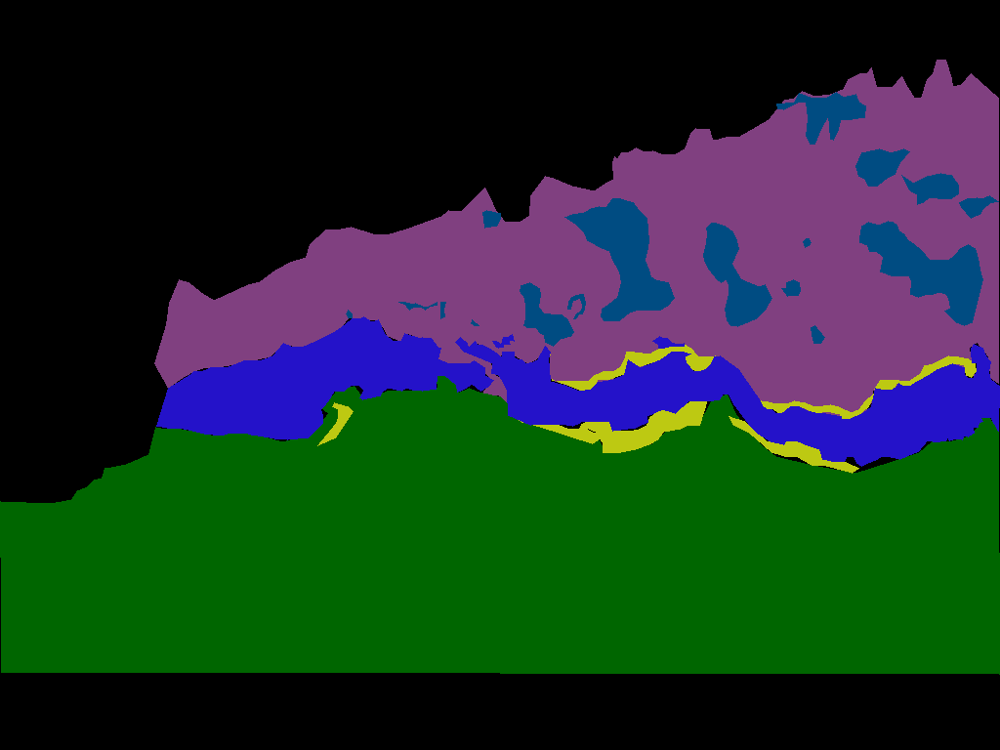

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


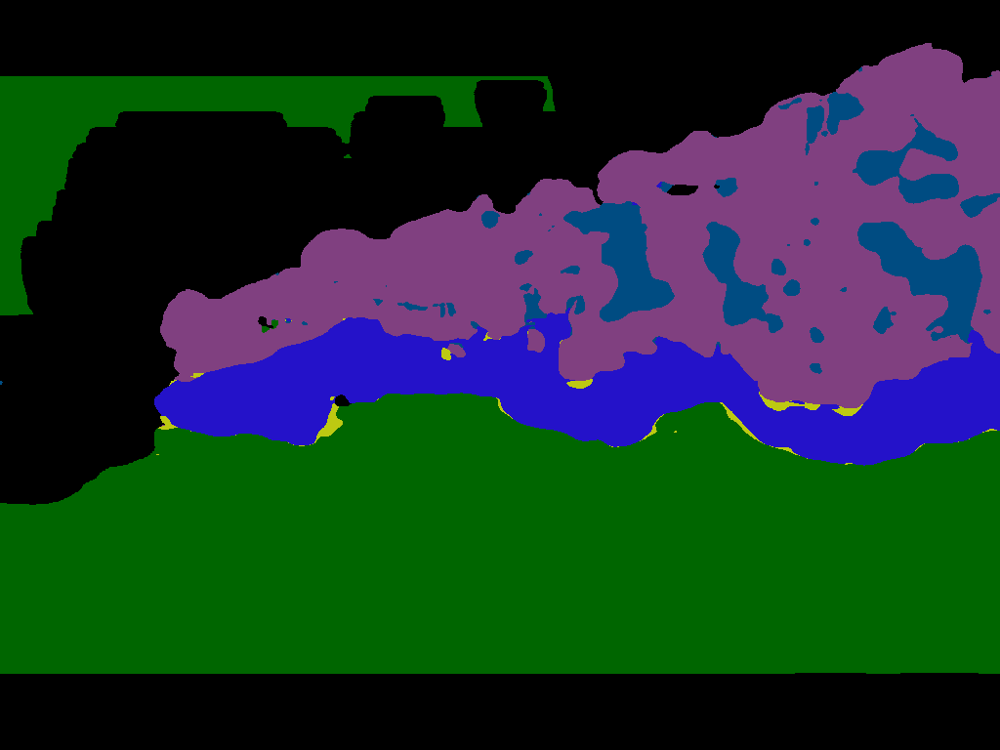

[0.87711553 0.96356275 0.78512397 0.67526377 0.94311927 0.94153846]
SLTE.C17CRA2.w1.3.png


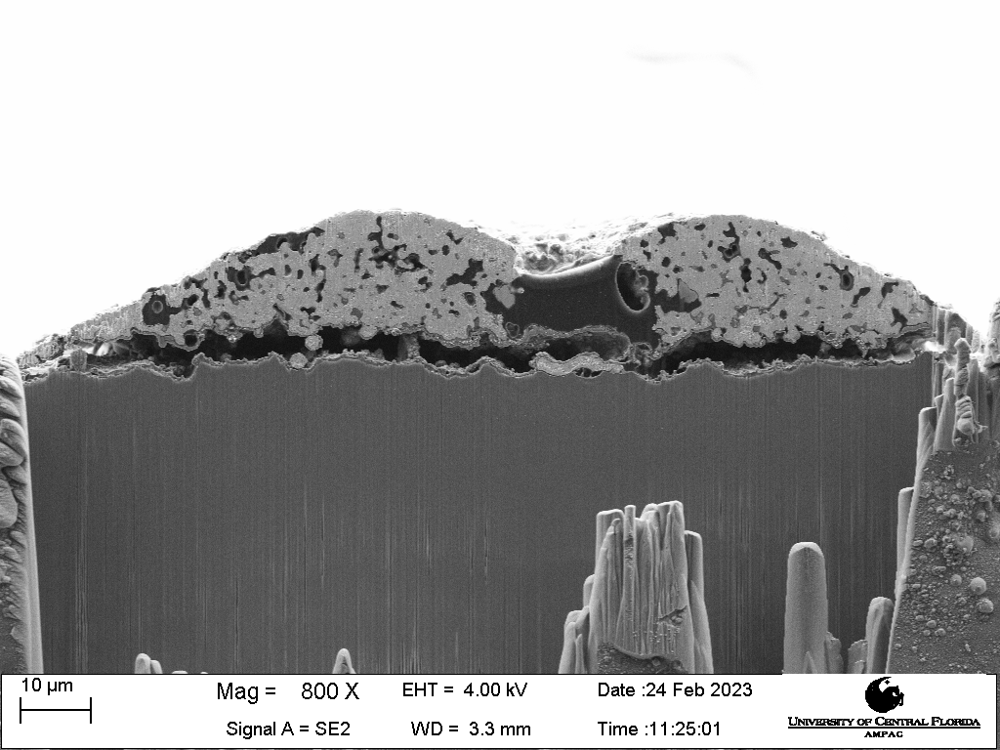

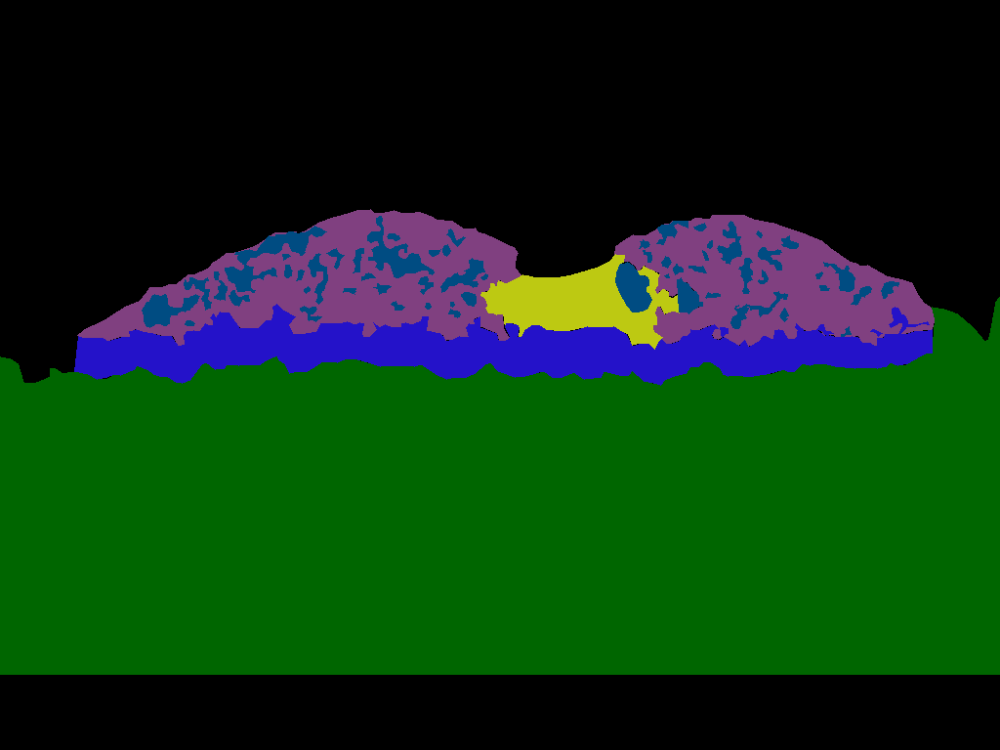

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


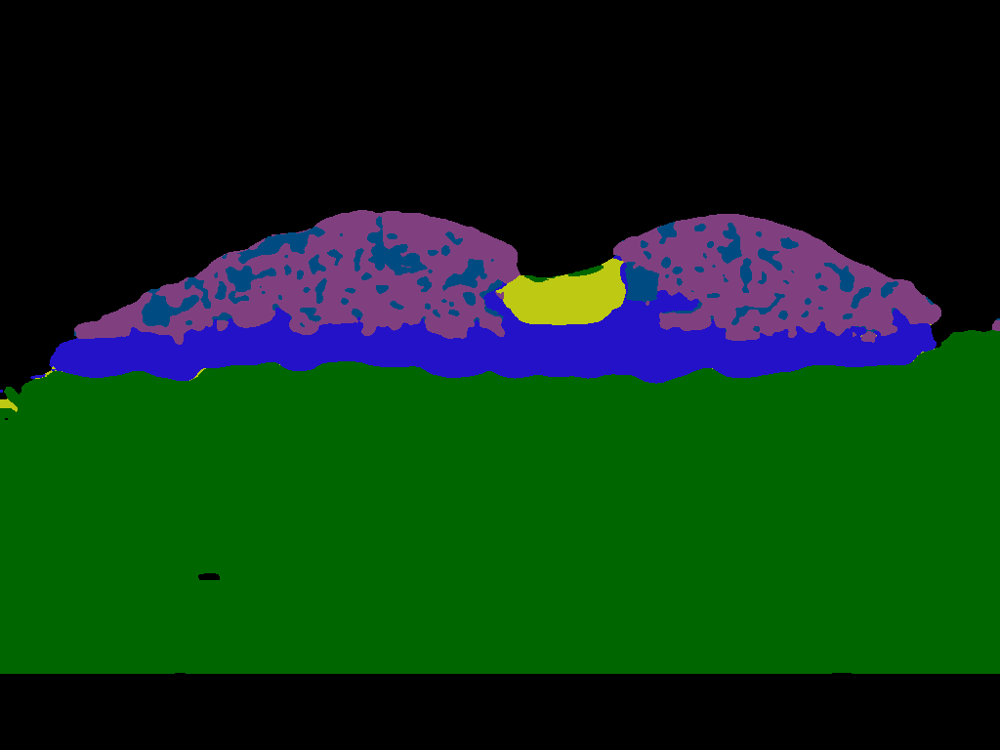

[0.97207859 0.98924731 0.70588235 0.92998679 0.99595142 0.75925926]
SLTE.C36BB21.w5.2.jpg


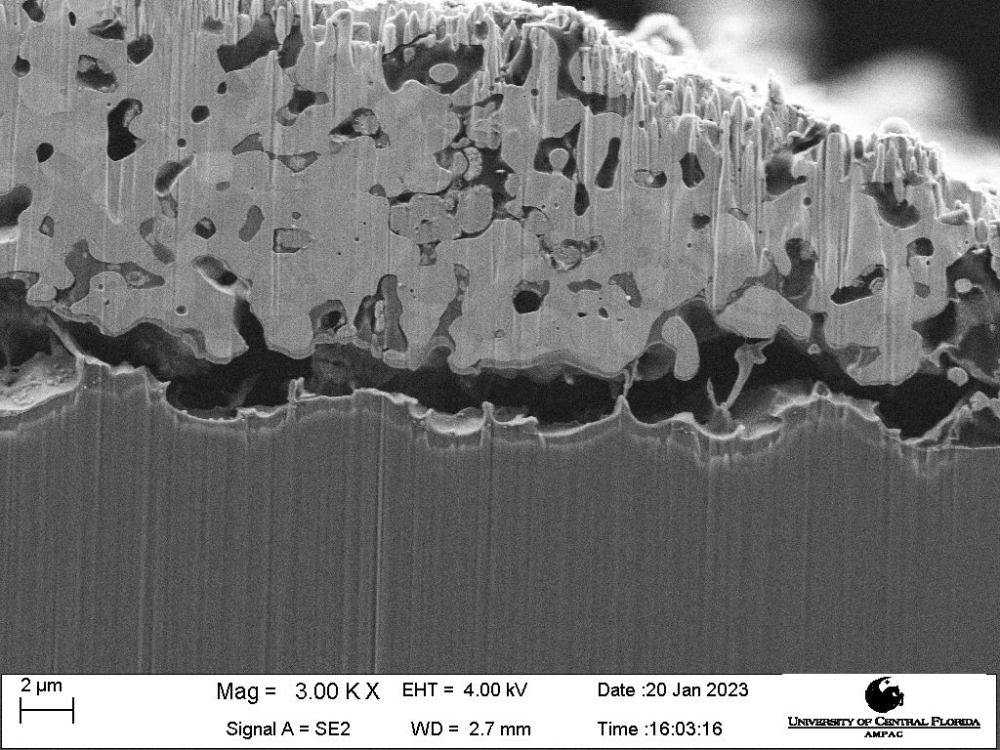

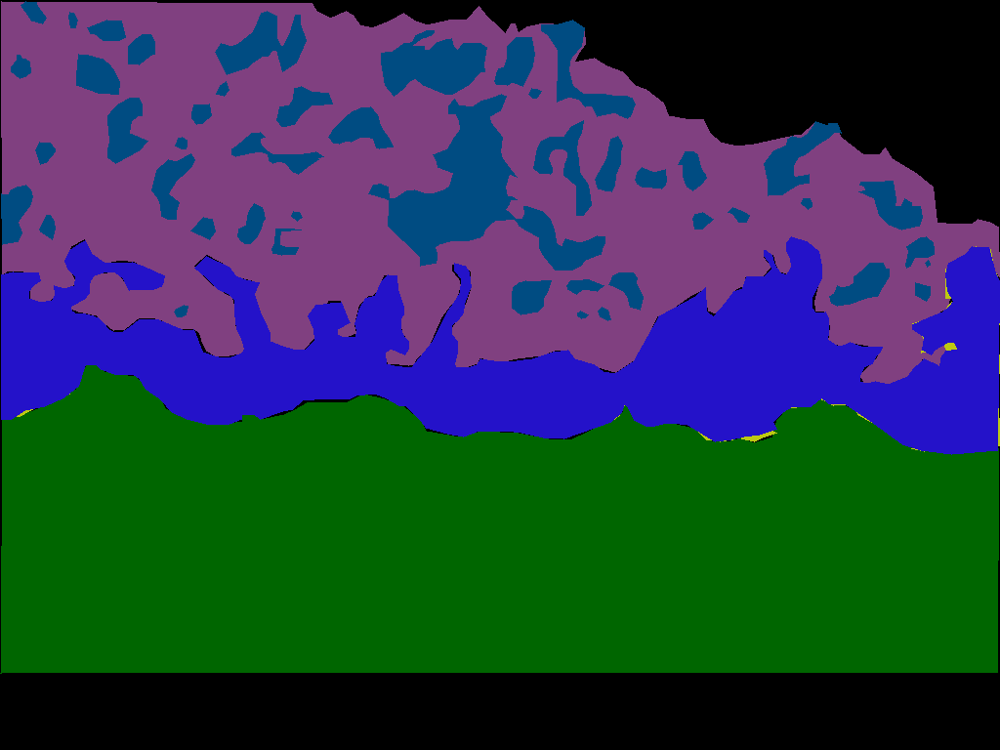

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


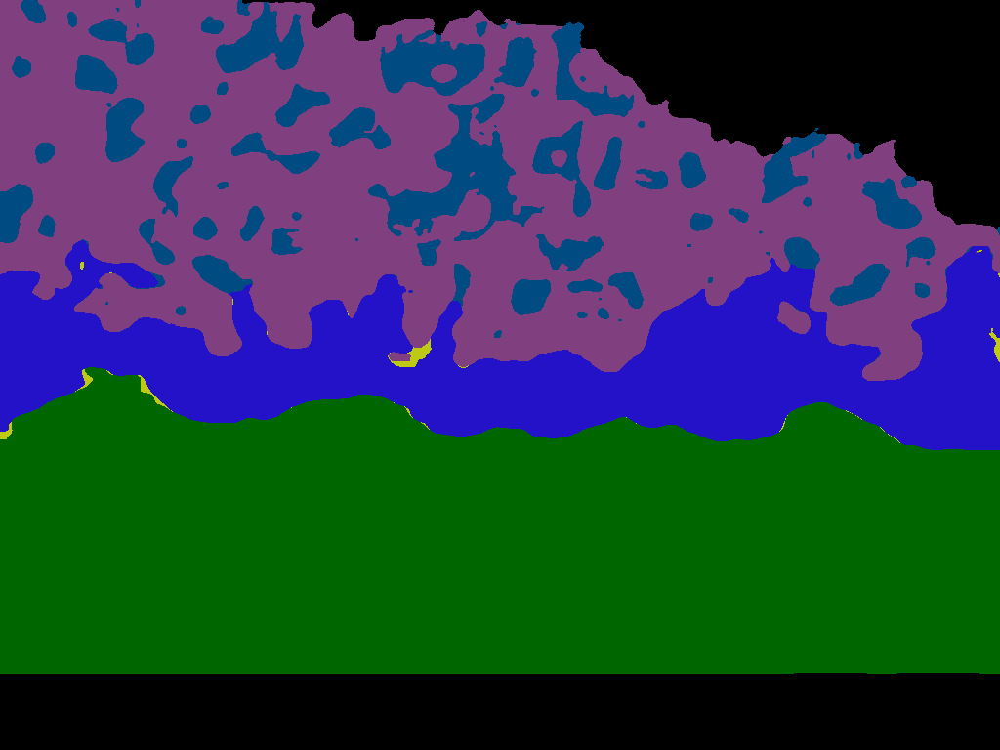

[0.58040665 0.99488491 0.61090909 0.9968254  0.9704142  0.97949886]
SLTE.C17CRA2.c1.2.png


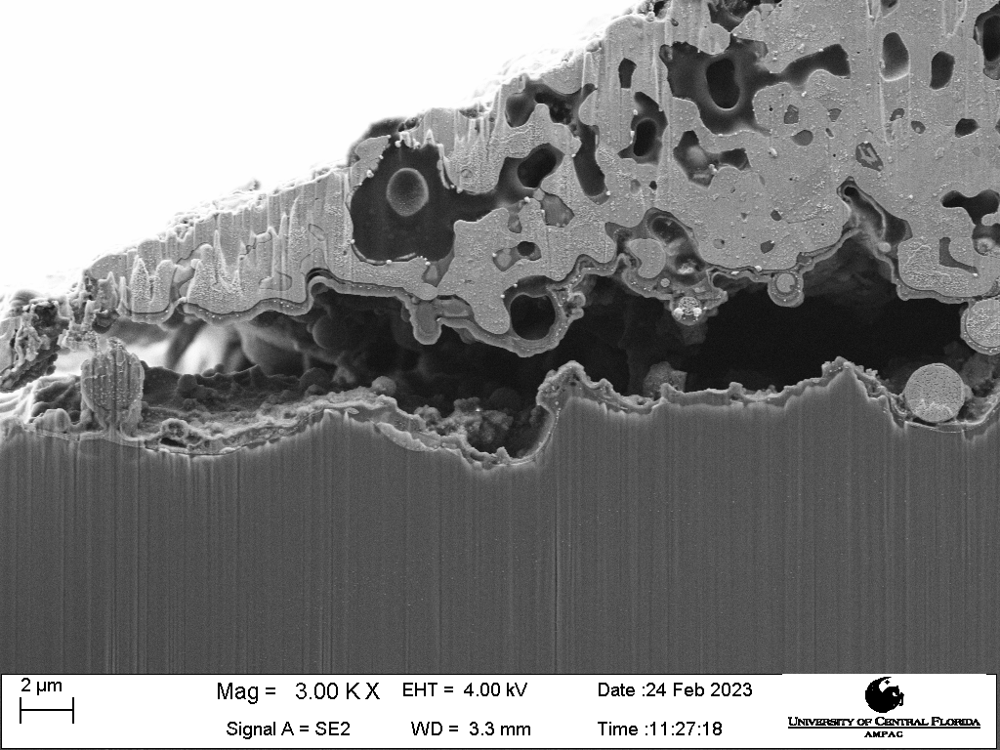

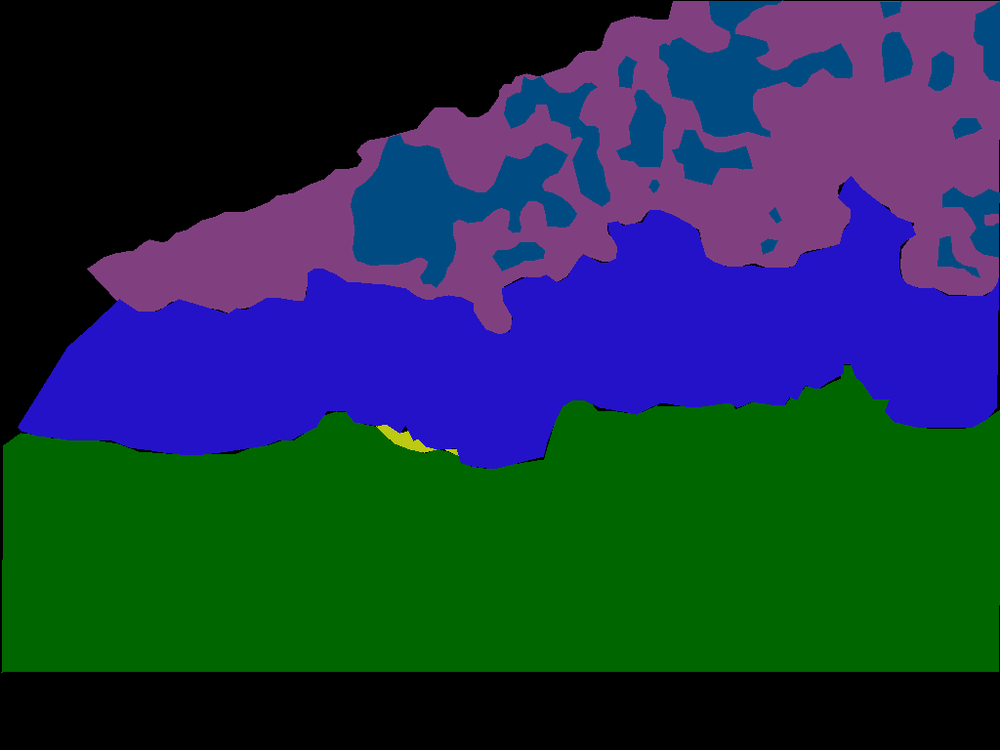

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


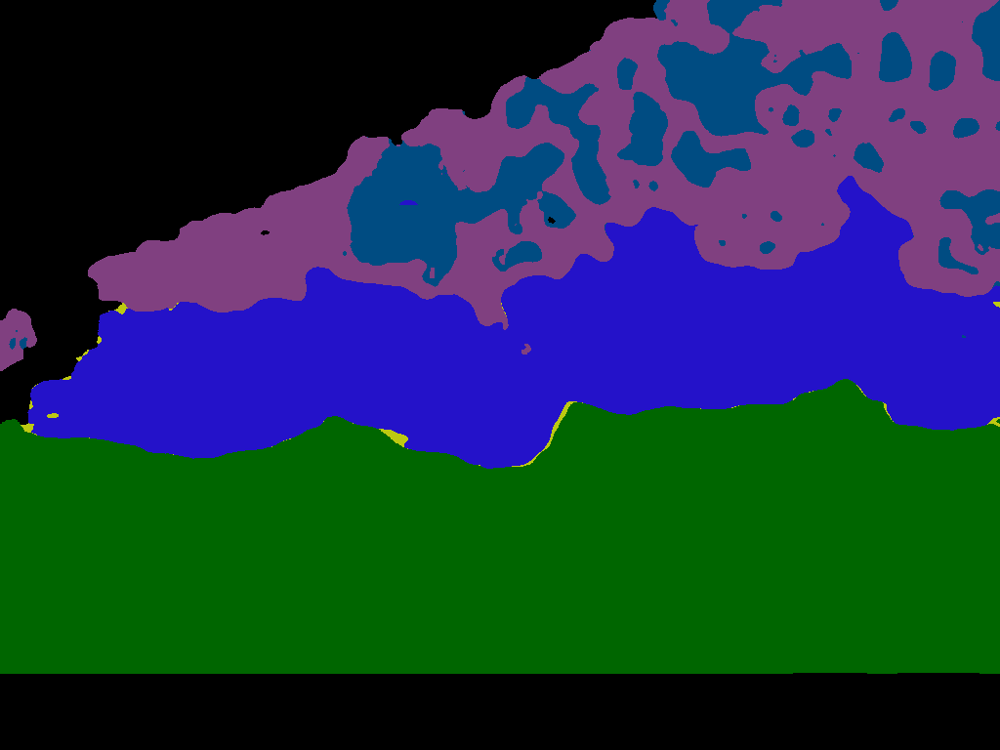

[0.80187207 0.94590846 0.41830065 0.97568882 0.97199341 0.99667774]
SLTE.C17BB11.w1.1.jpg


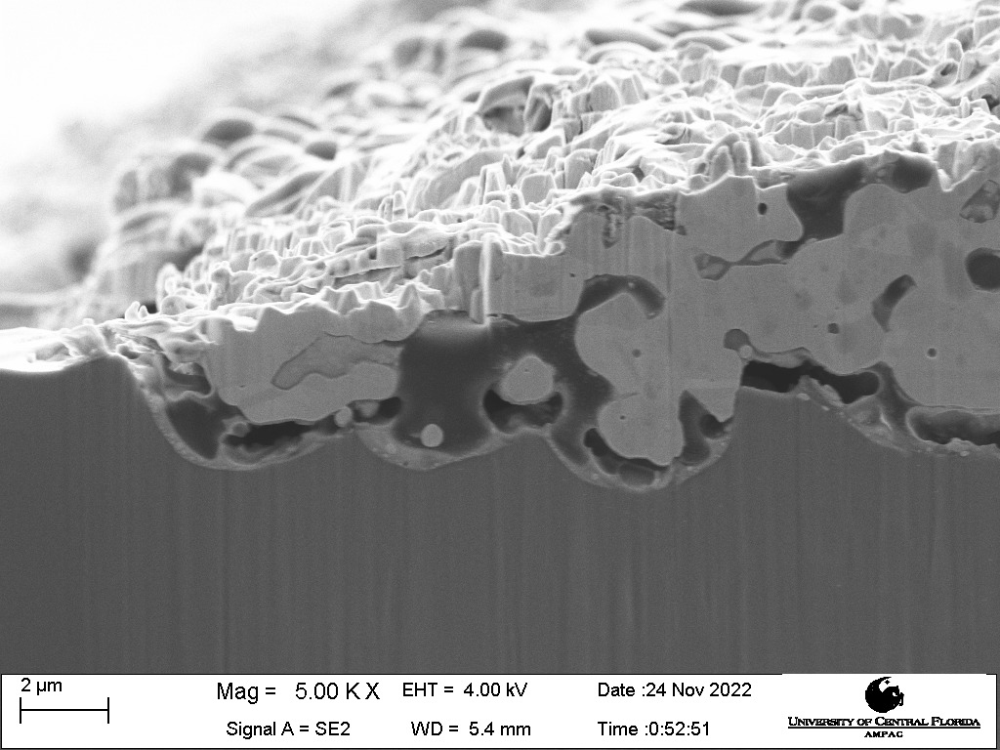

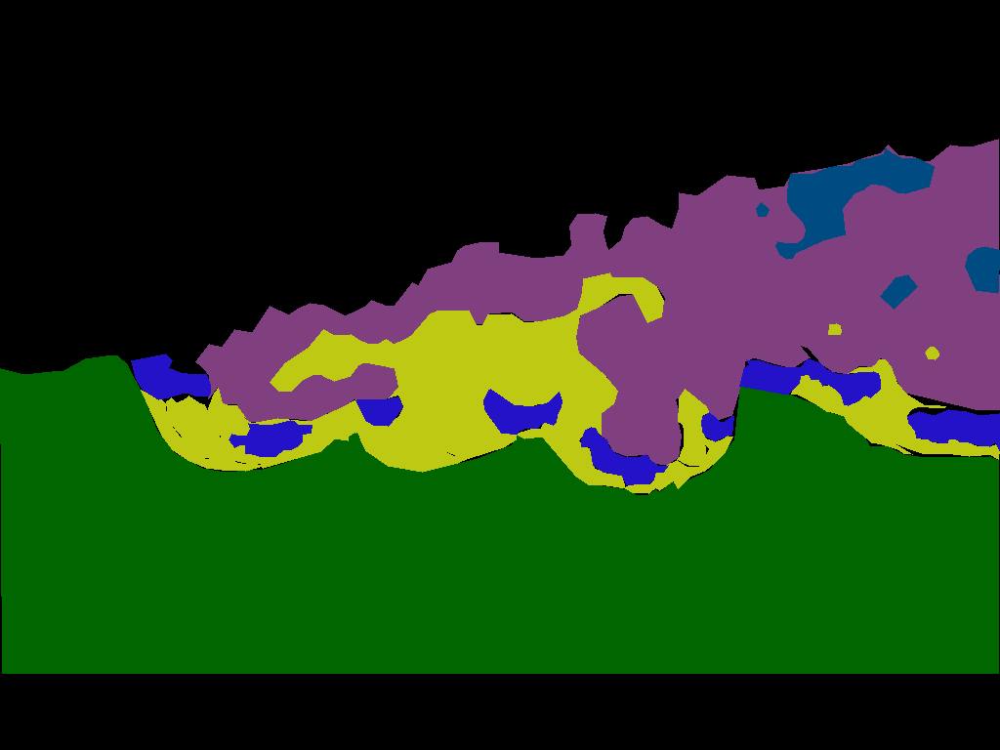

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


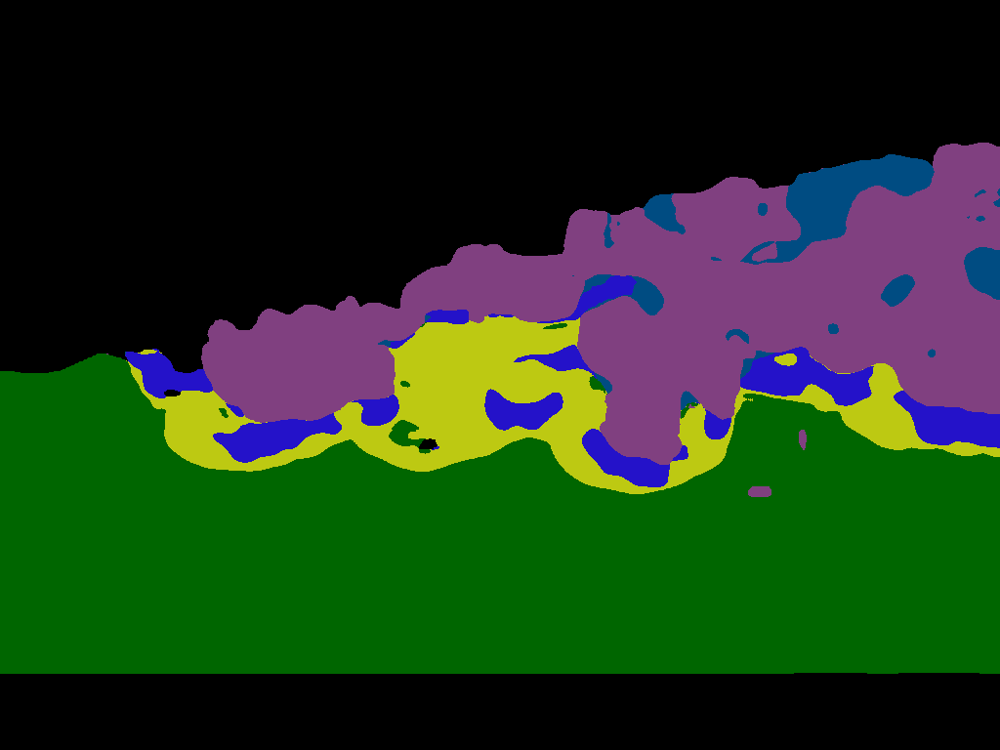

[0.76824379 0.97633136 0.89268293 0.98638427 0.74823529 0.78717201]
SLTE.C17BB11.c4.1.jpg


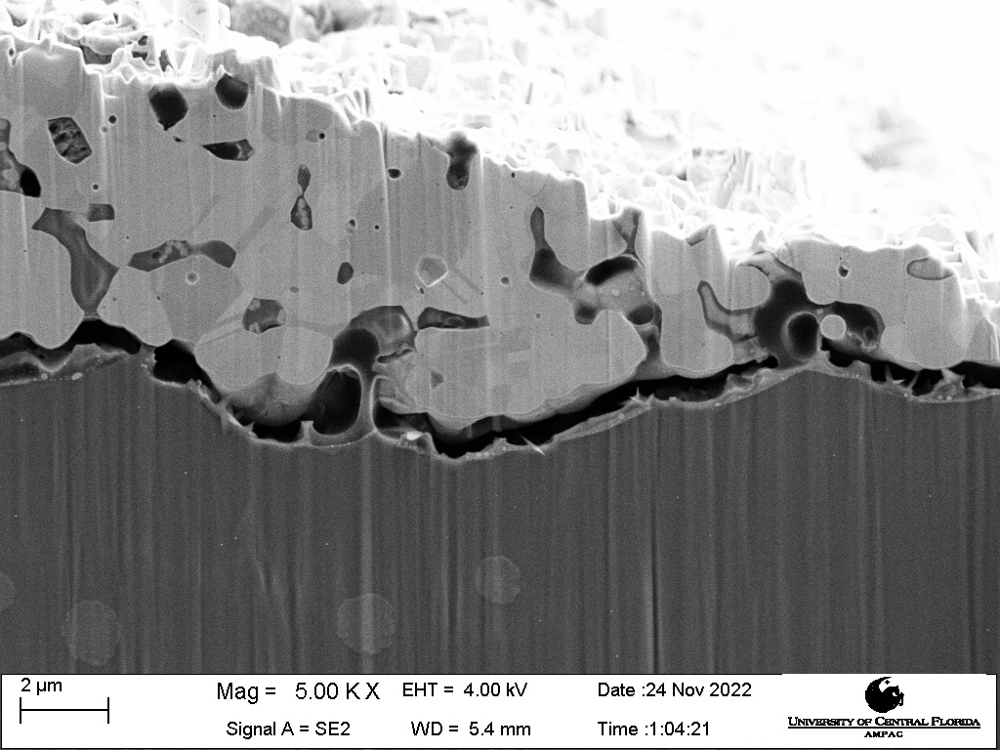

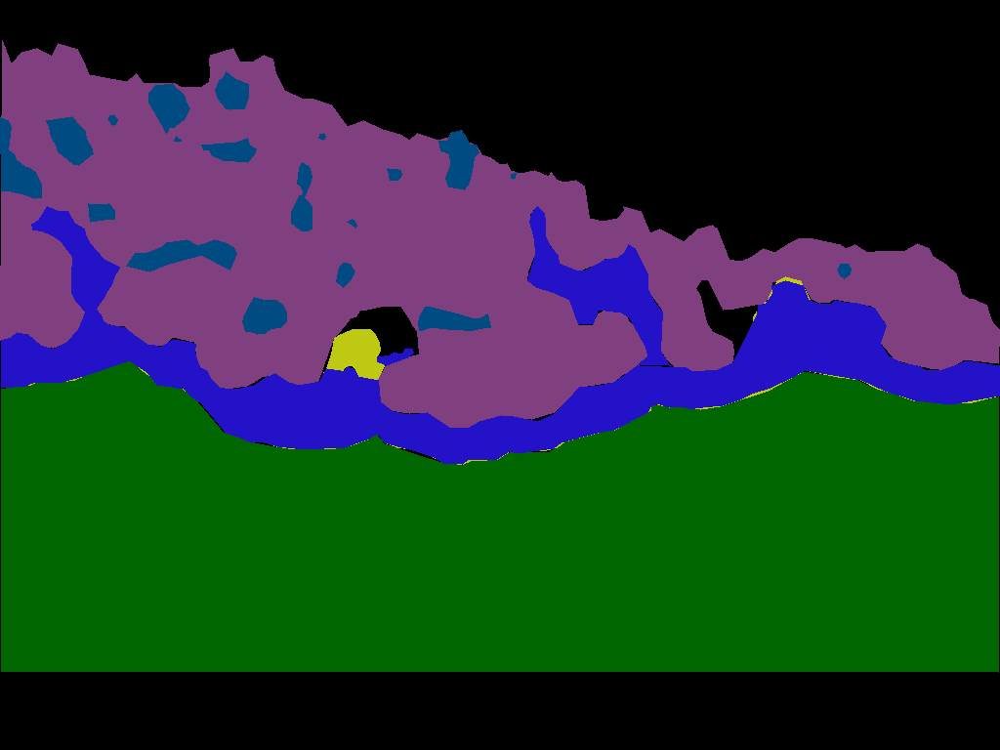

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


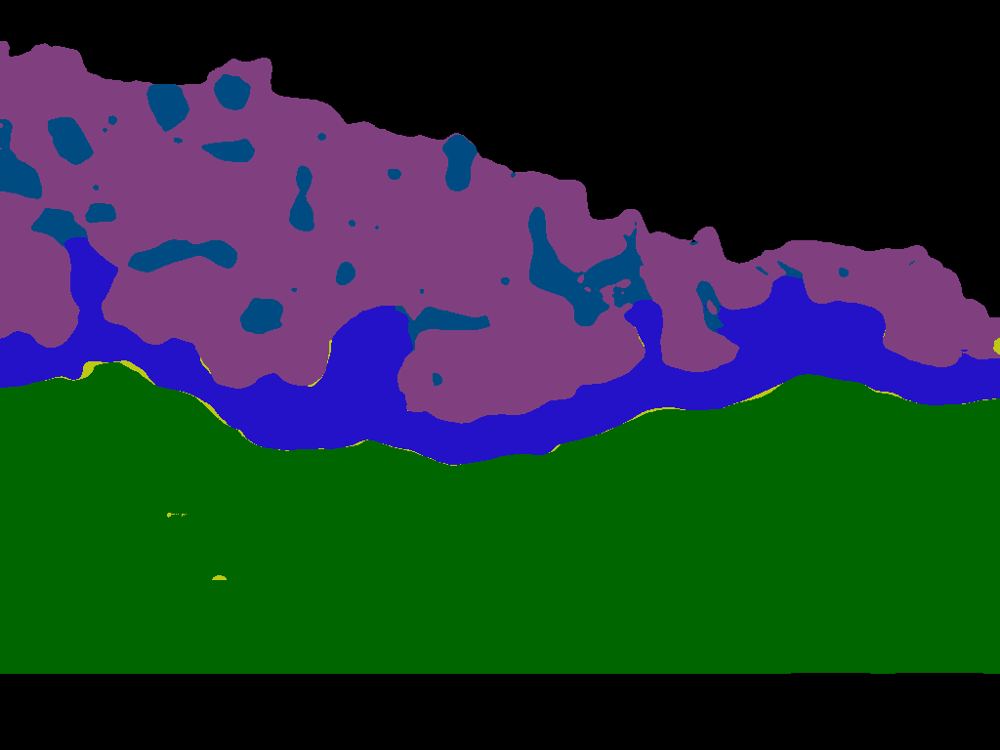

[0.6894198  0.99366286 0.77027027 0.9968652  0.9057971  0.93574297]
SLTE.C17CRA2.c2.2.png


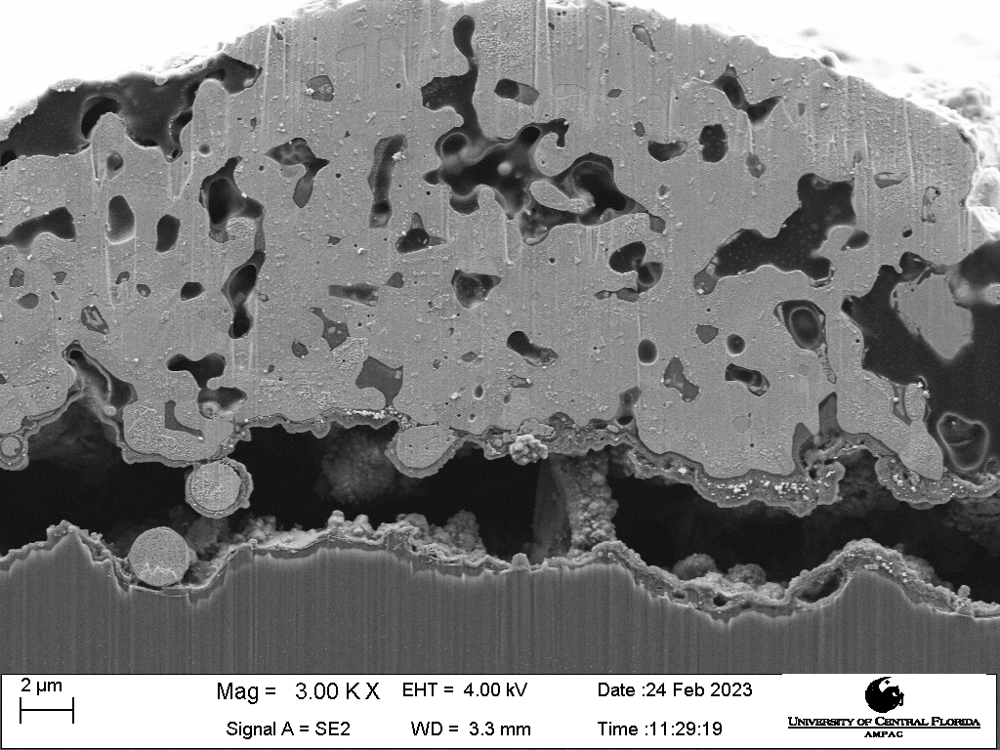

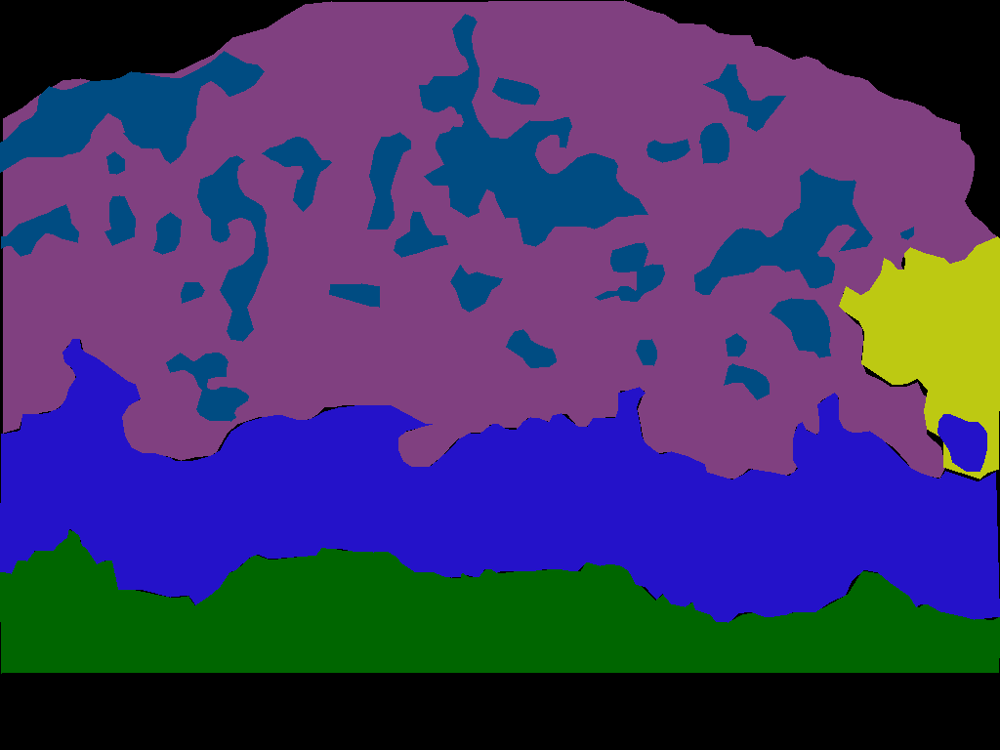

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


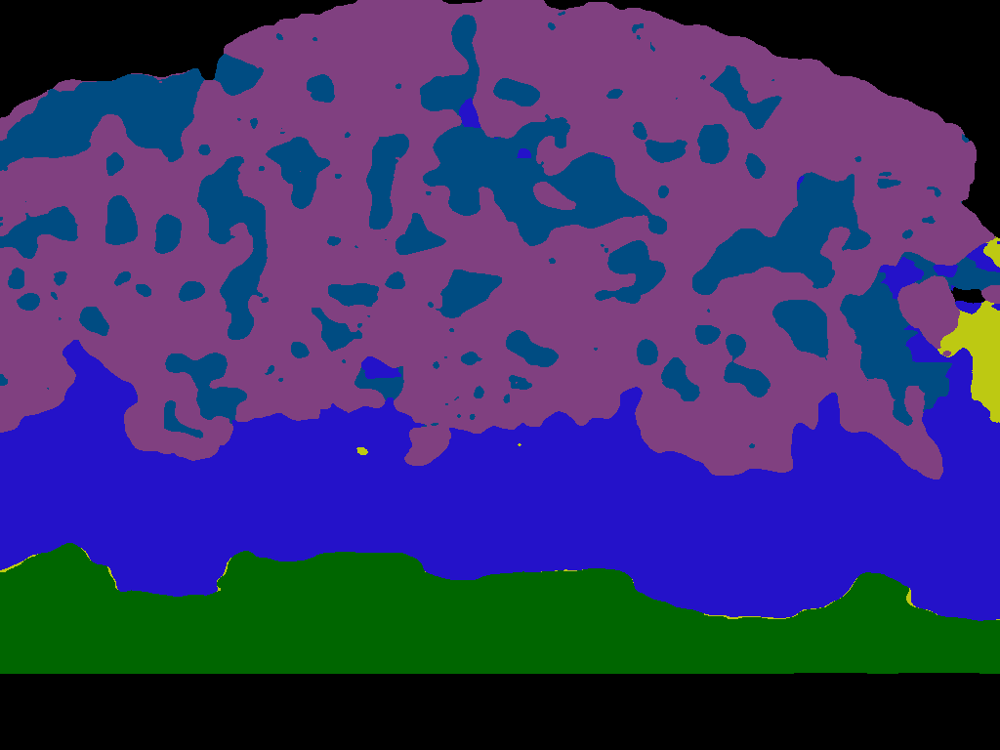

[0.61705989 1.         0.68571429 0.95373665 0.970964   0.79834254]
SLTE.C17CRA1.c5.1.png


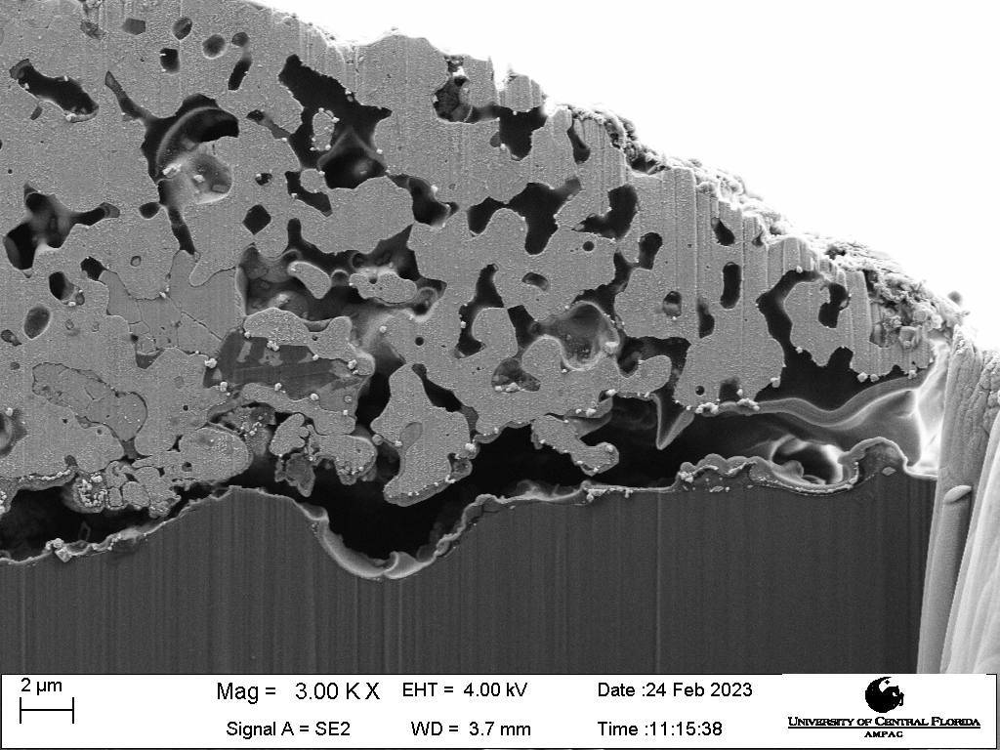

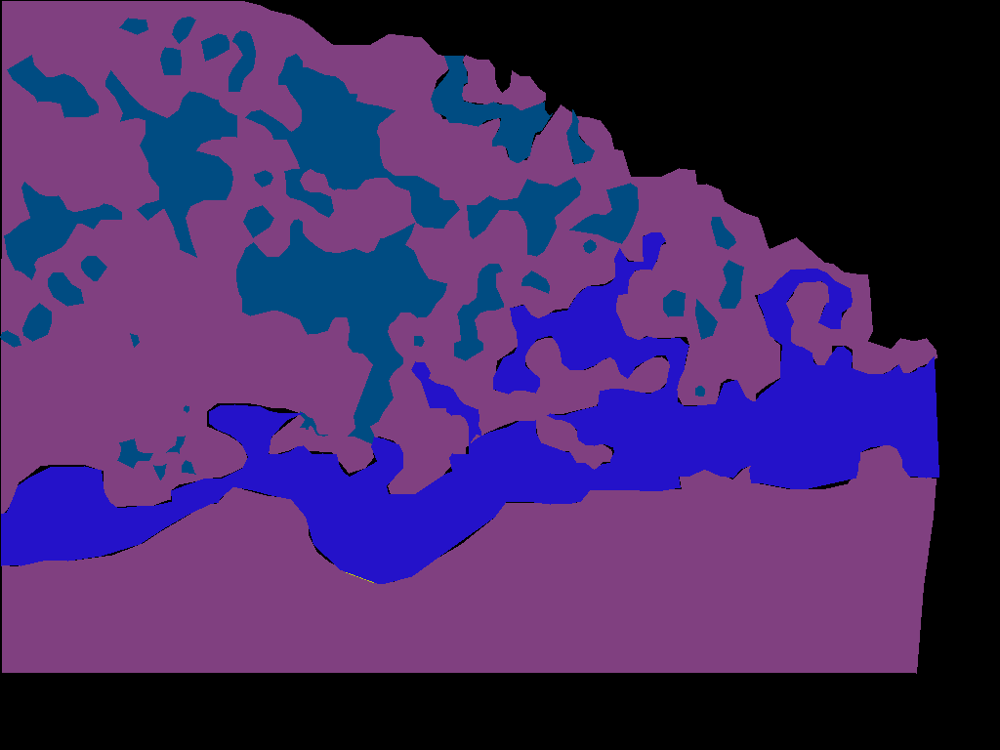

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


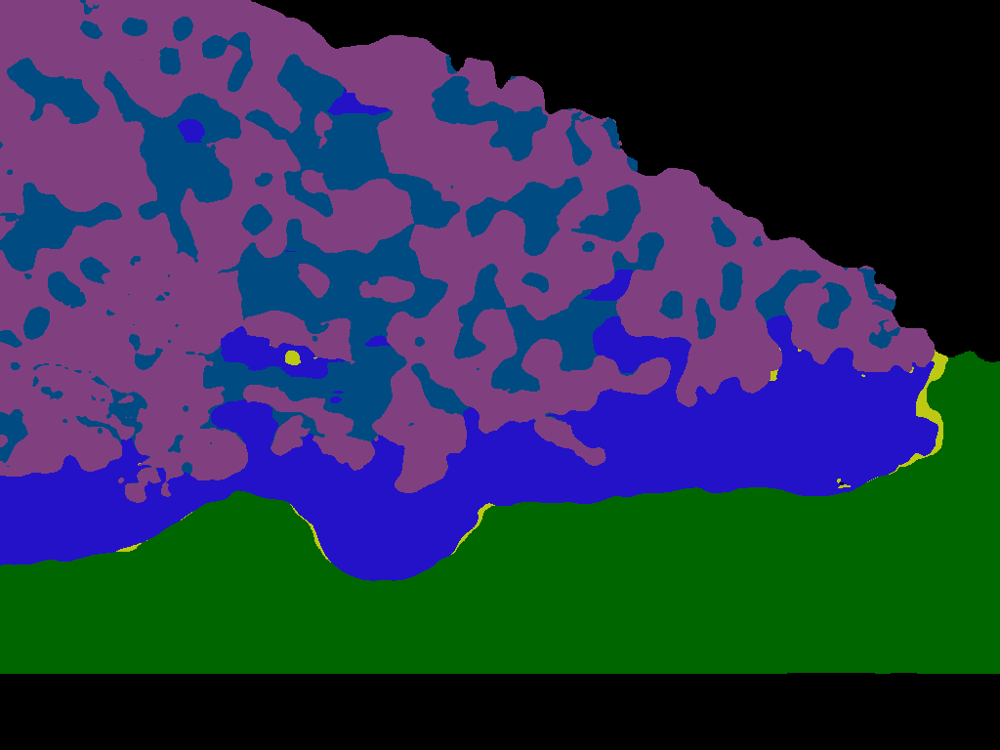

SLTE.C17CRA2.c3.2.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [3] will be ignored
  warnings.warn(


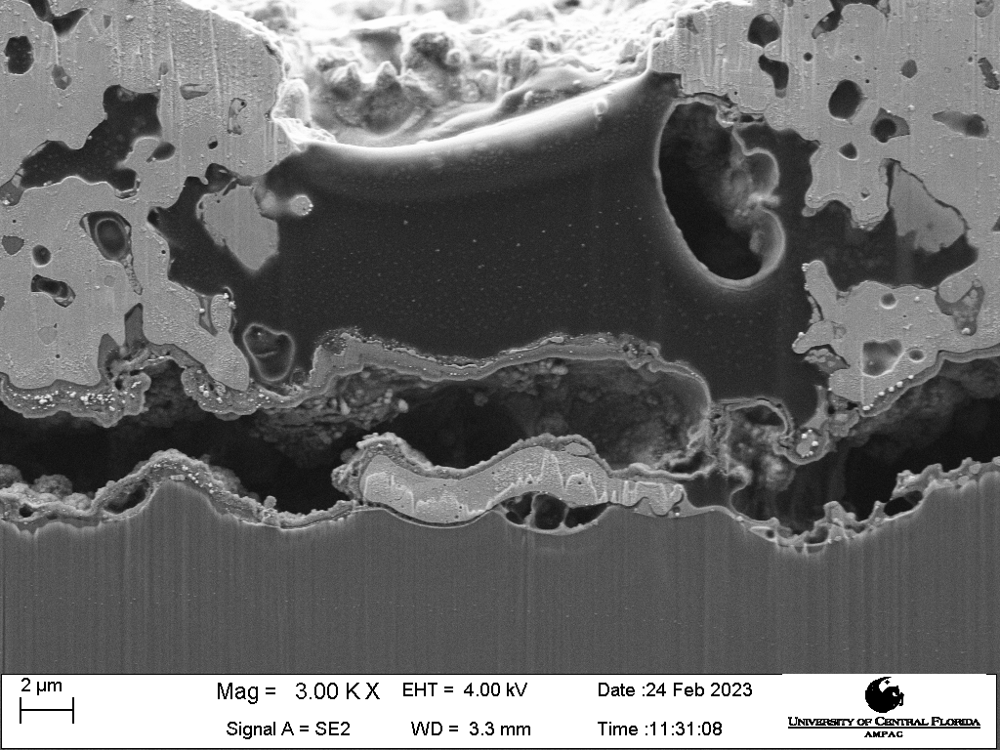

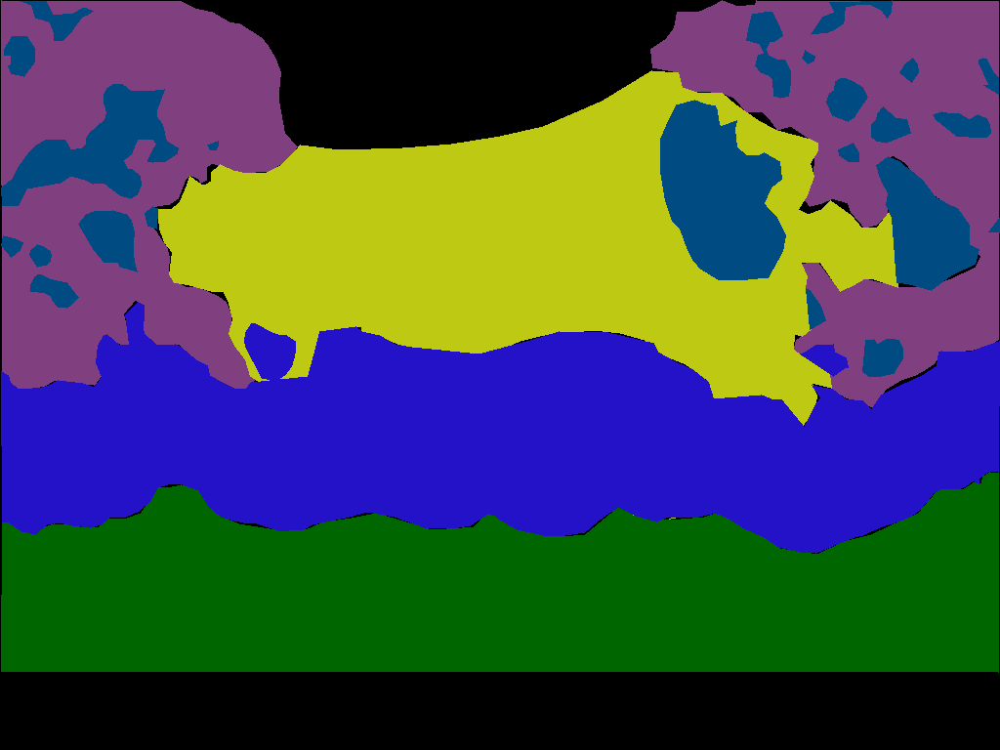

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


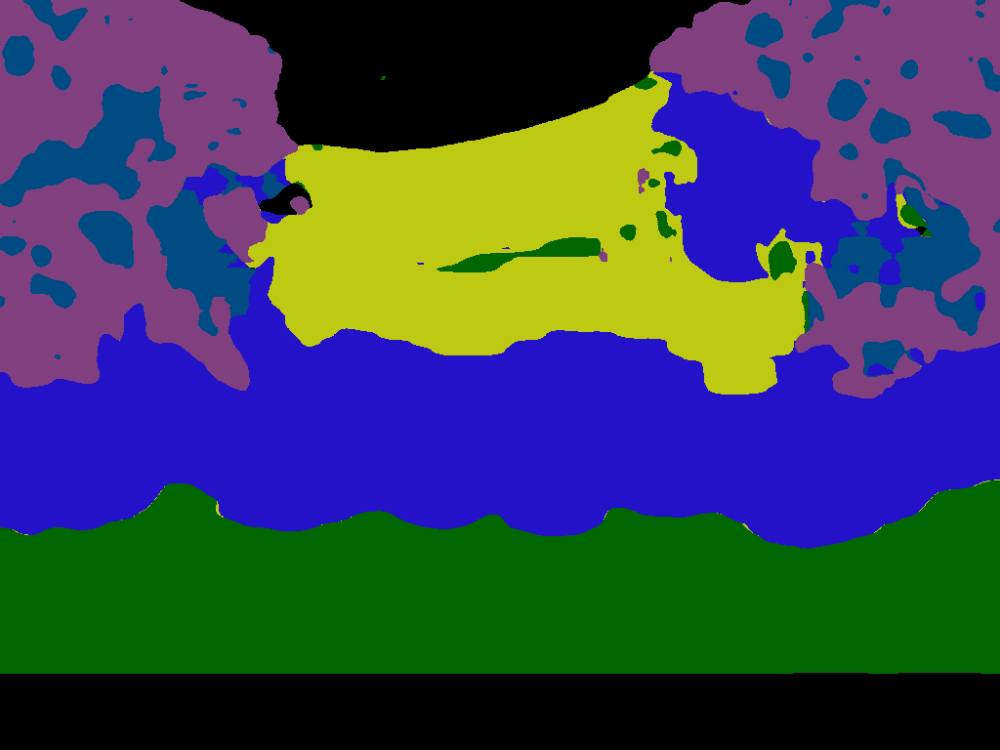

[0.53014354 0.98909091 0.88918558 0.69001751 0.99077734 0.67737617]
SLTE.C17BB11.w2.4.png


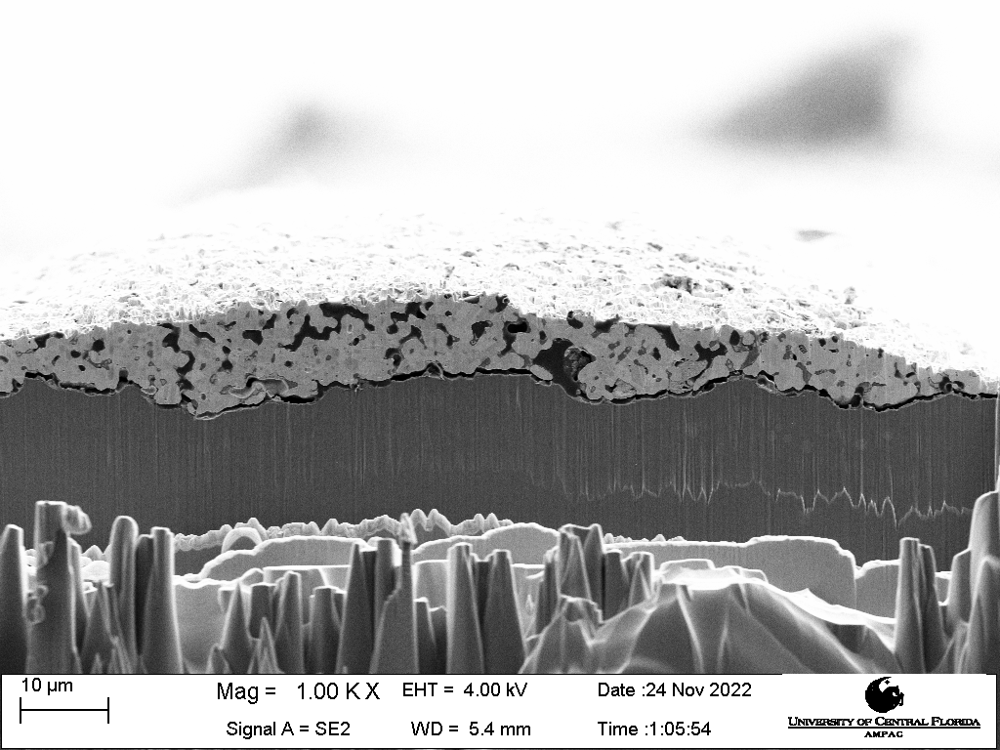

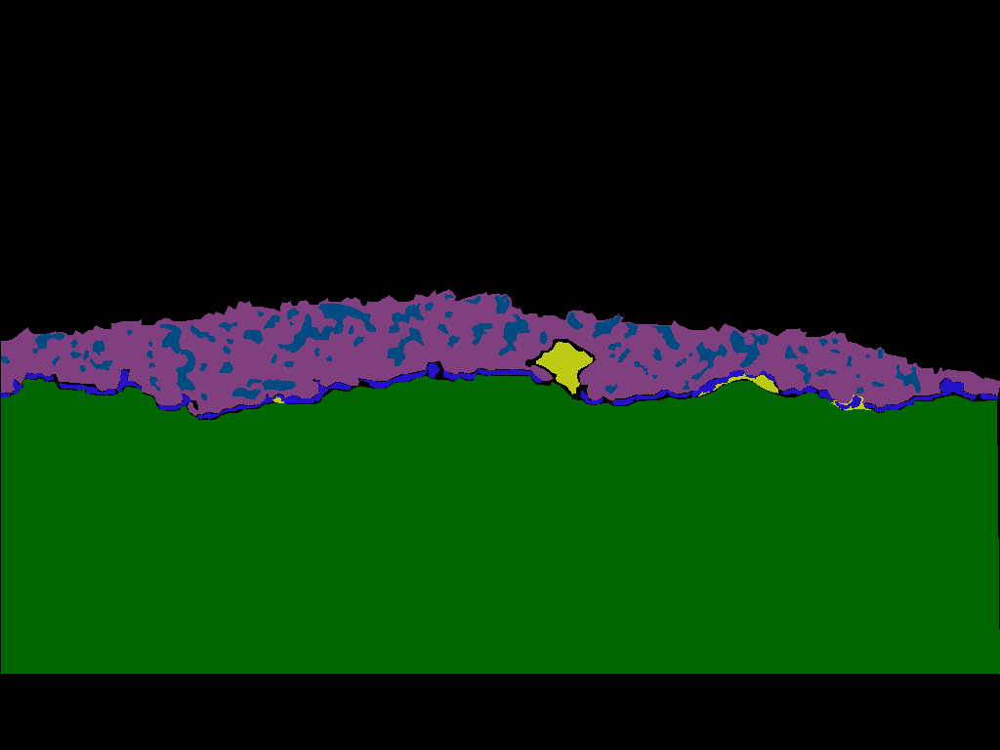

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


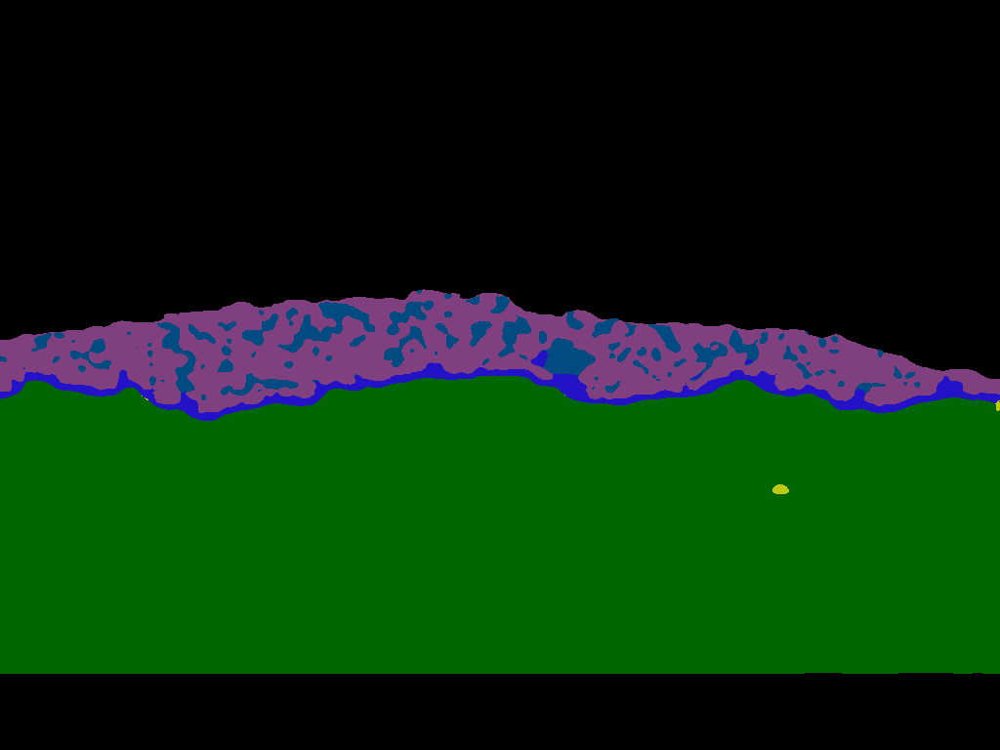

[0.7562753  0.98832685 0.32989691 0.99674267 0.97757848 0.90076336]
SLTE.C17CRA1.c2.1.png


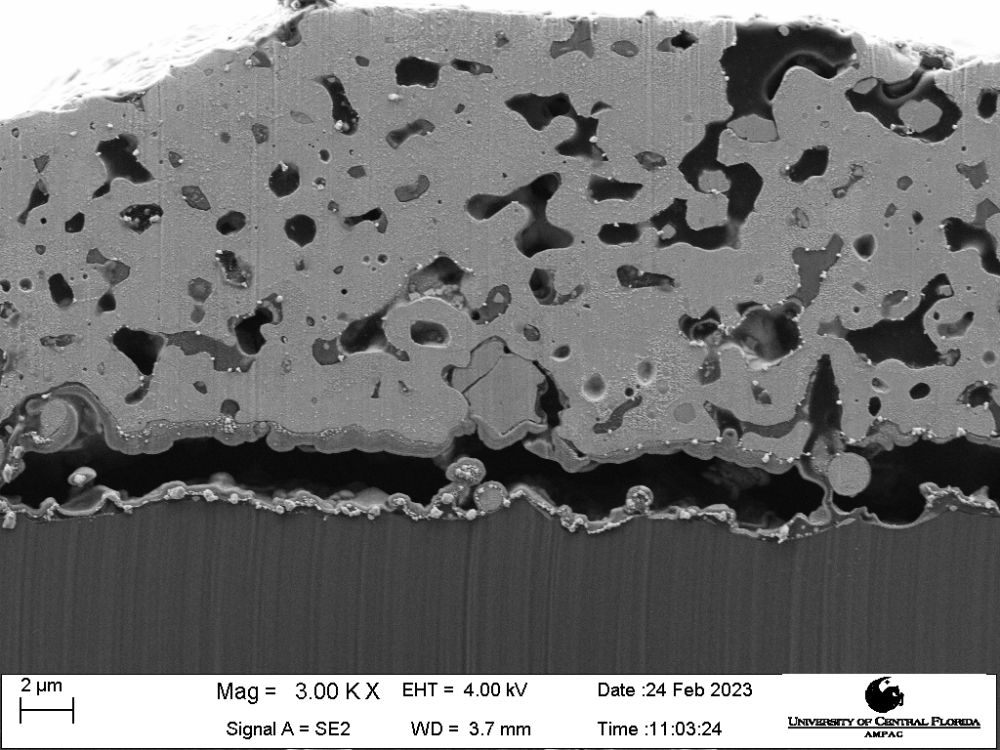

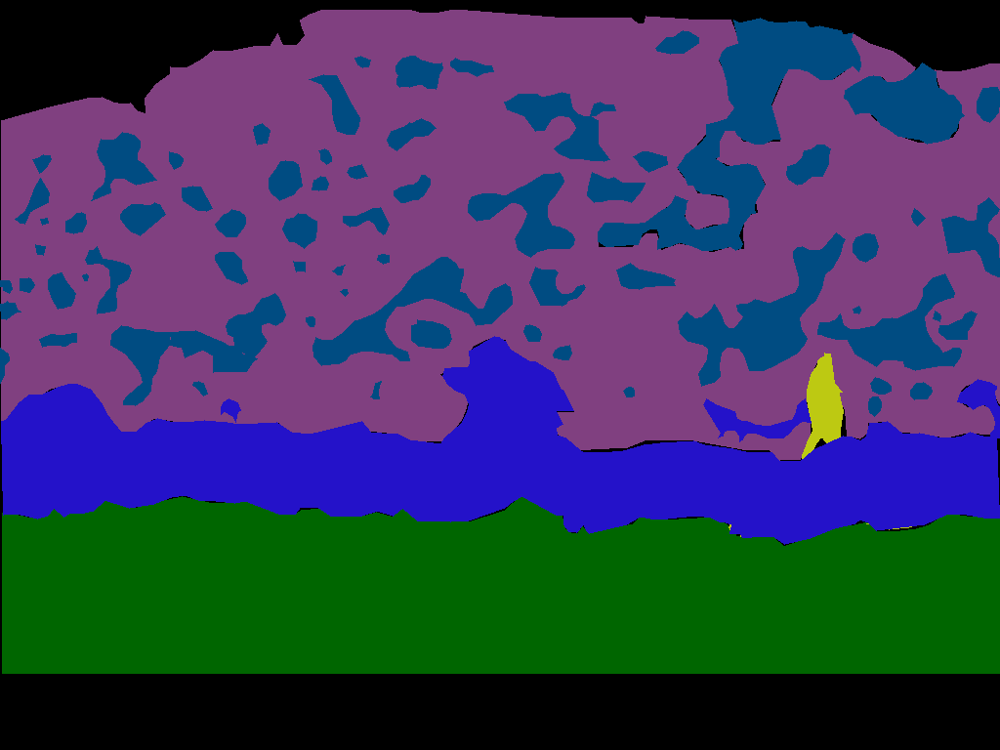

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


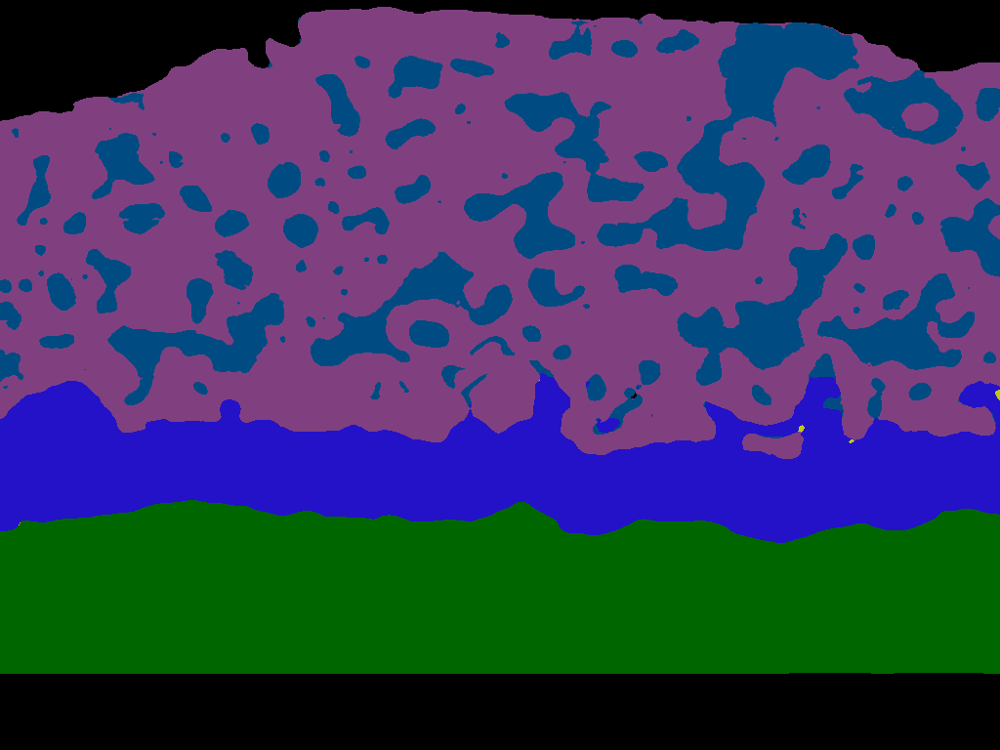

[0.44705882 0.99459459 0.34722222 0.98888889 0.9749702  0.89690722]
SLTE.C17CRA1.c3.1.png


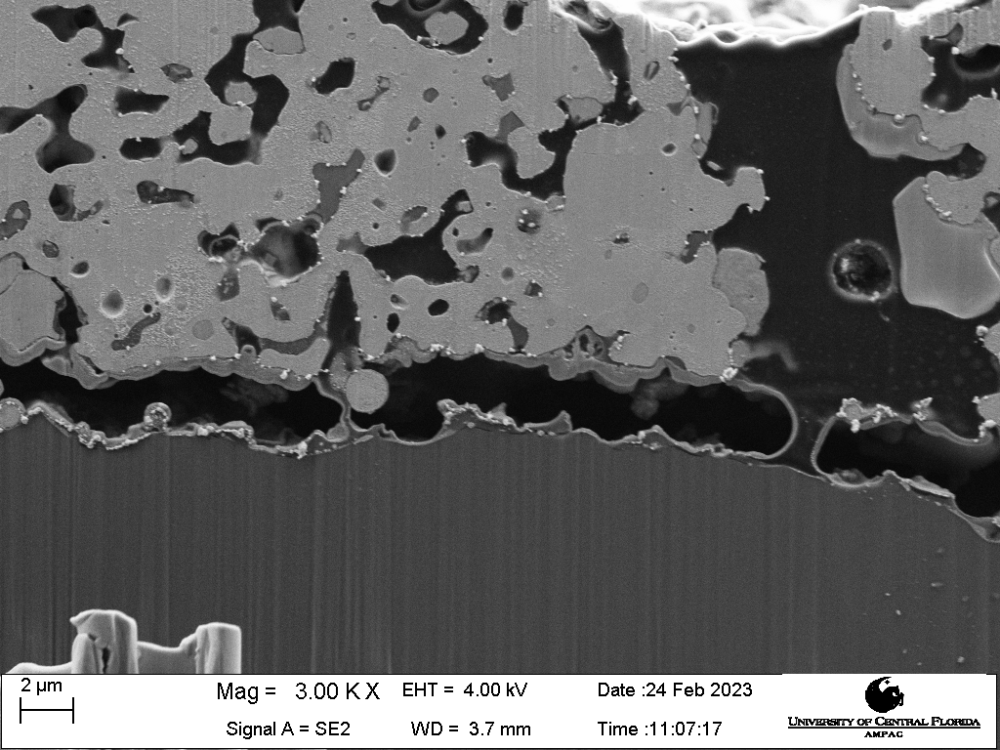

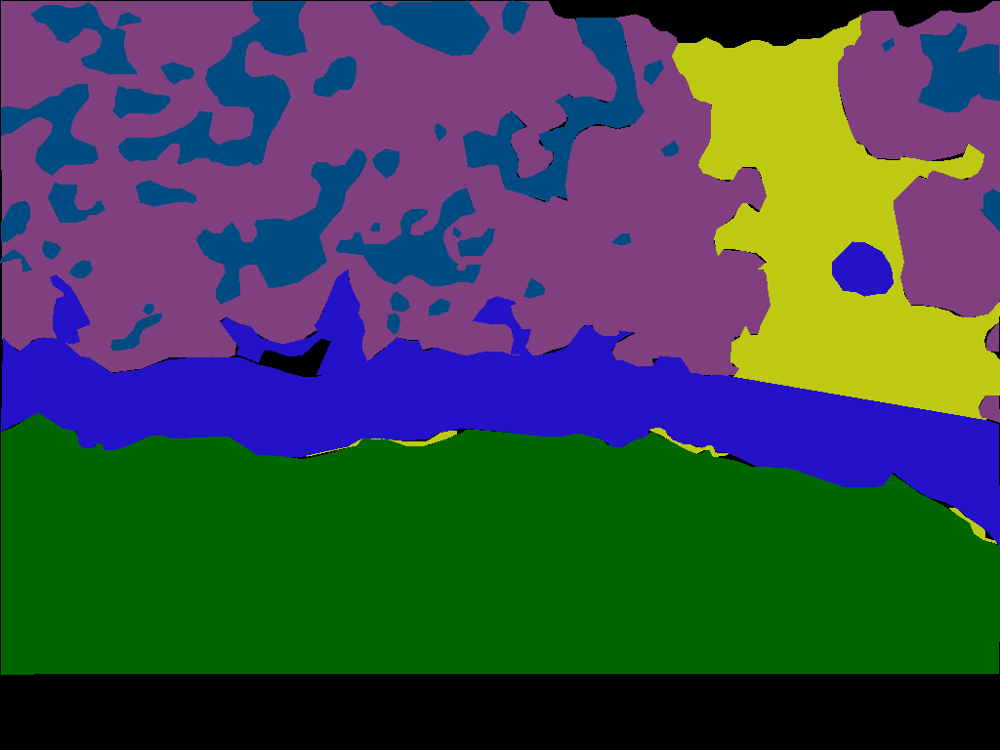

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


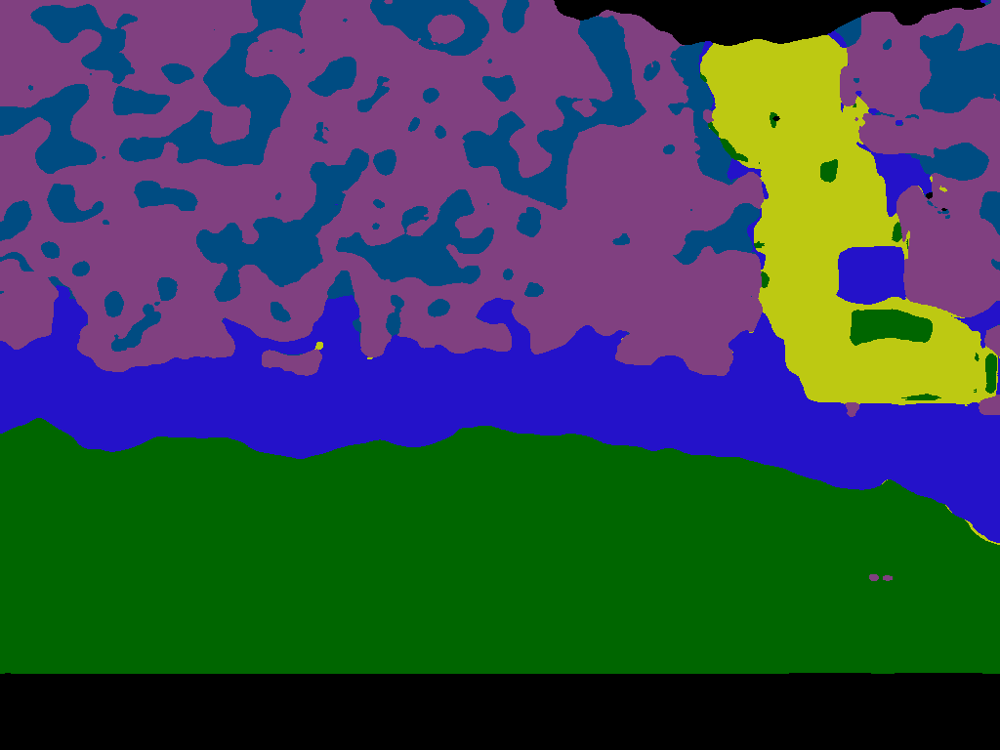

[0.31023102 0.98309179 0.91111111 0.70053476 0.99447514 0.76390606]
SLTE.C17CRA1.w2.2.png


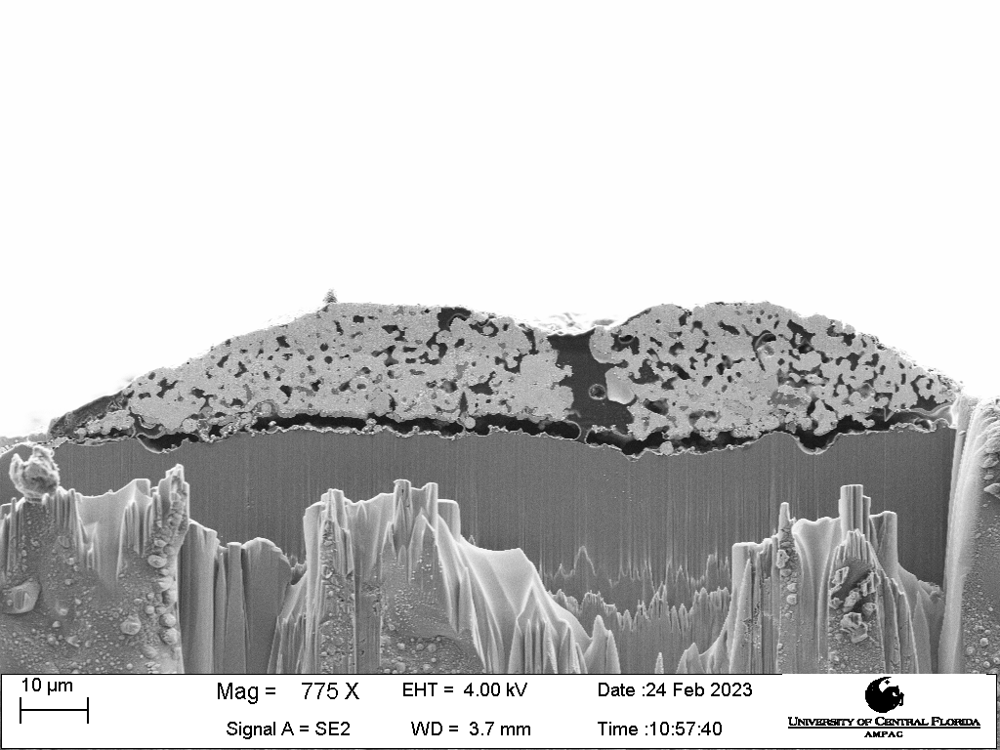

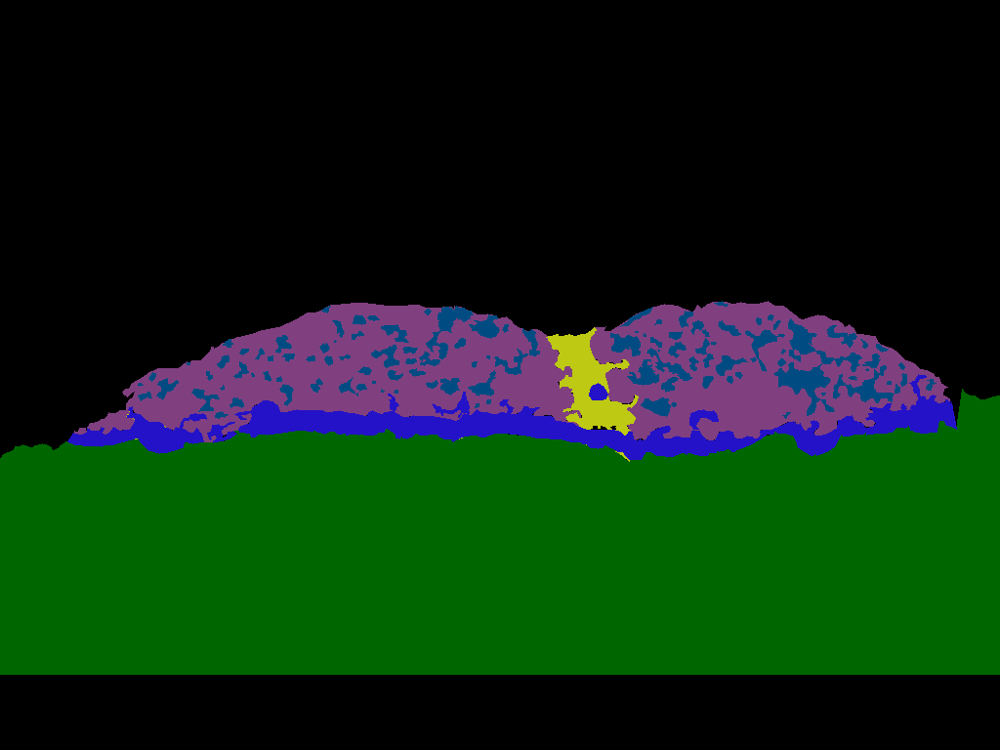

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


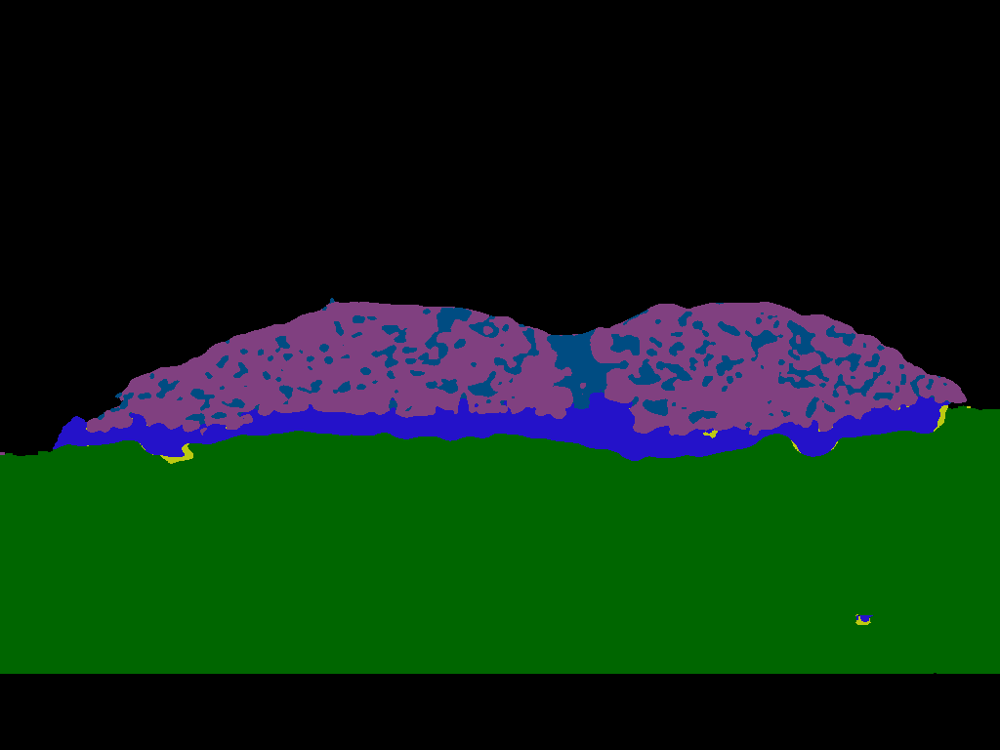

[0.99451554 0.96140351 0.45360825 0.96830986 0.94444444 0.8502994 ]
SLTE.C16CR11.c2.2.jpg


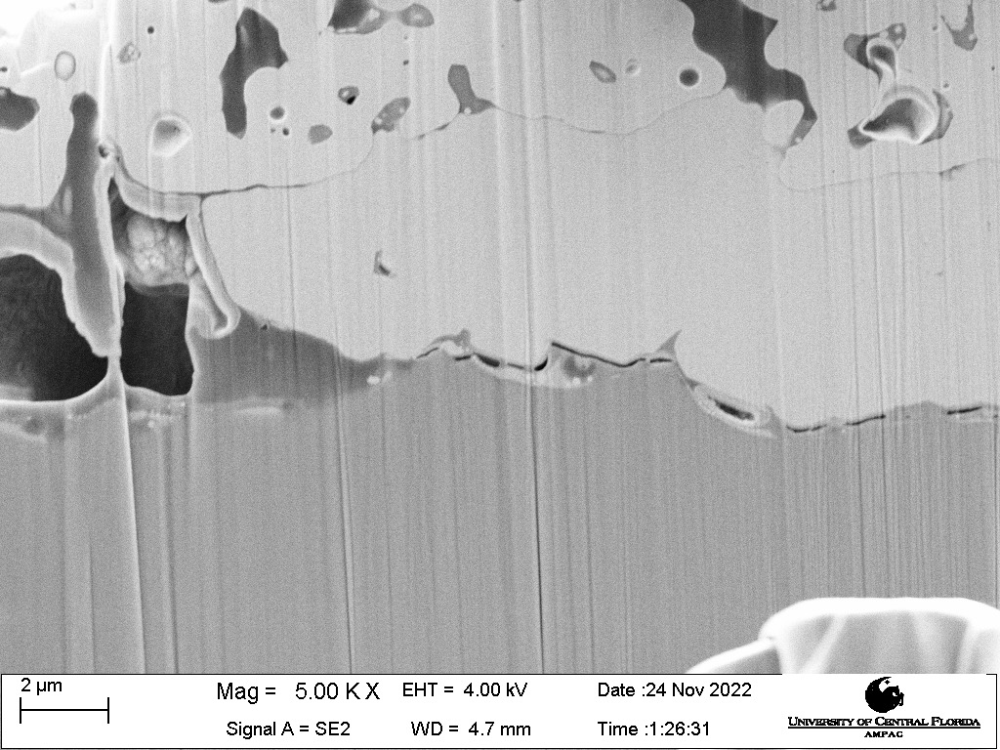

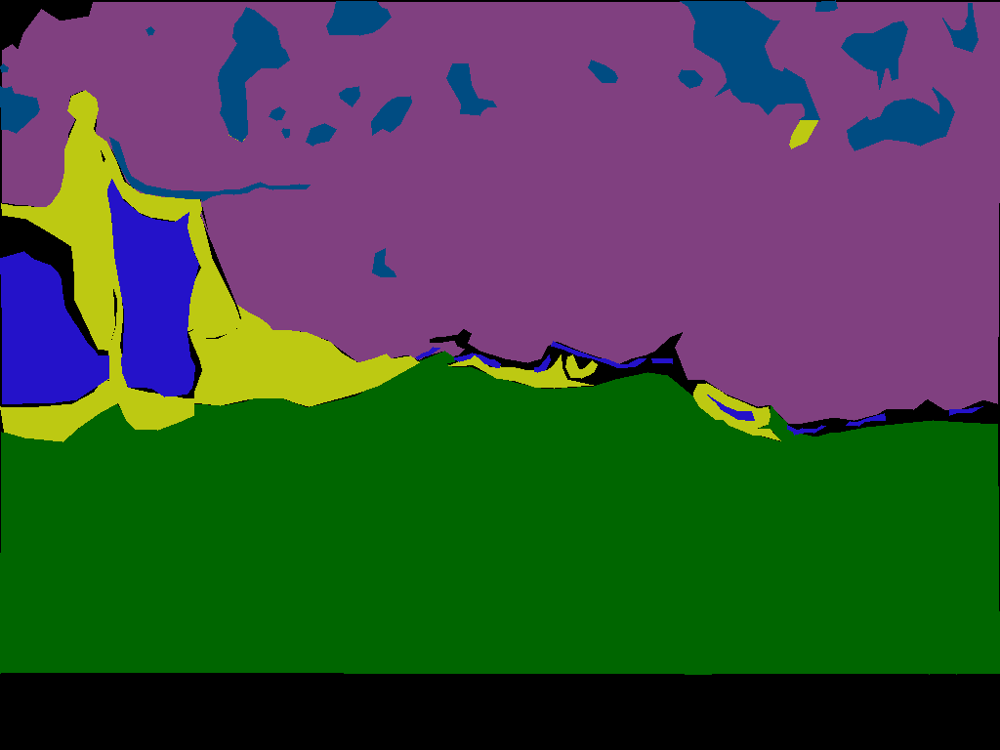

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


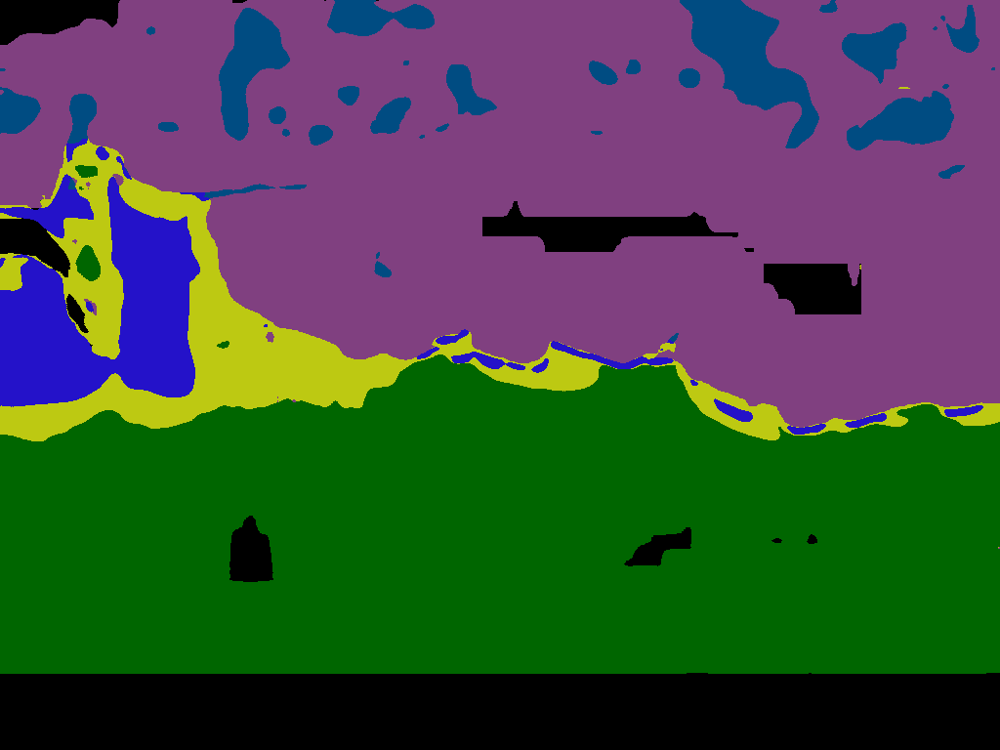

[0.64838394 0.99082569 0.91988131 0.90581717 0.92576419 0.92579505]
SLTE.C16CR11.c1.1.jpg


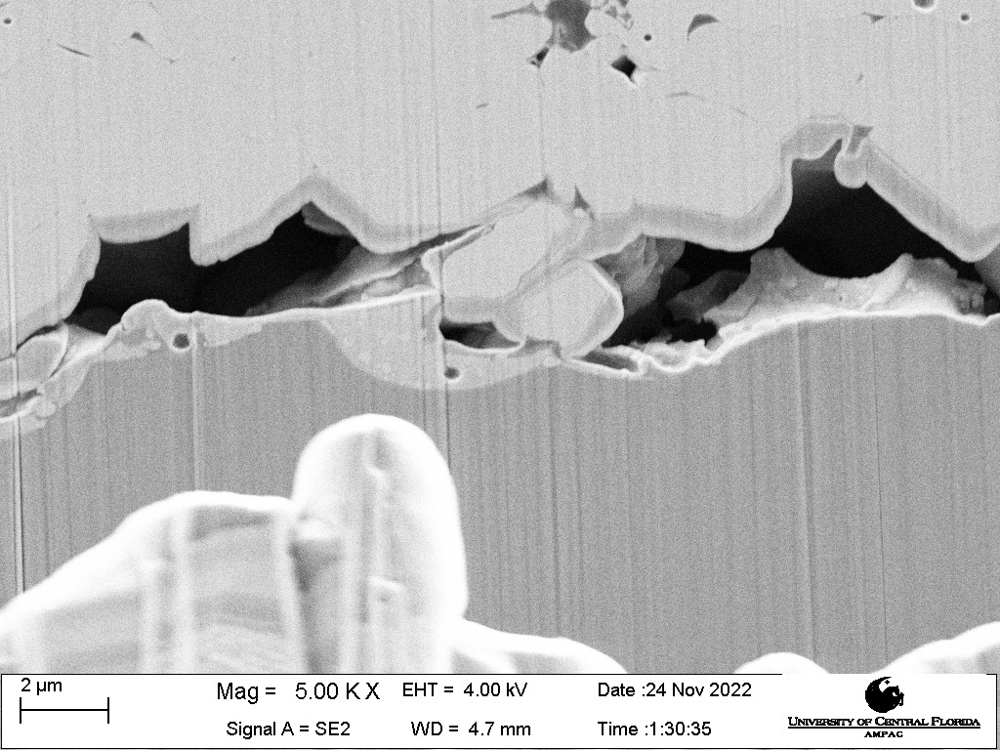

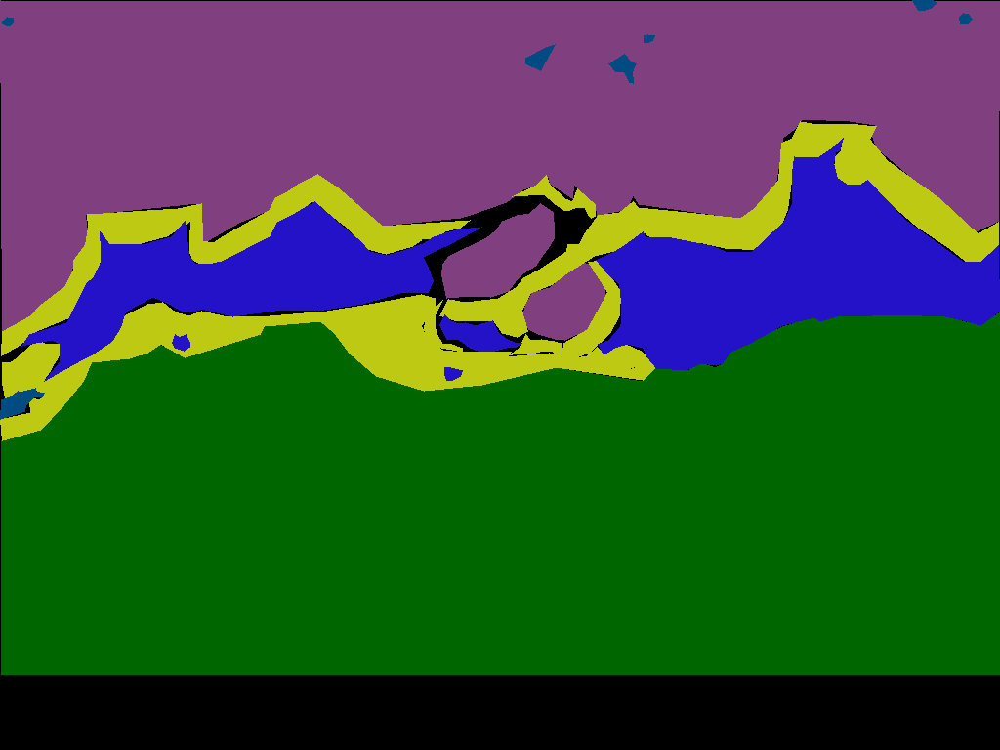

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


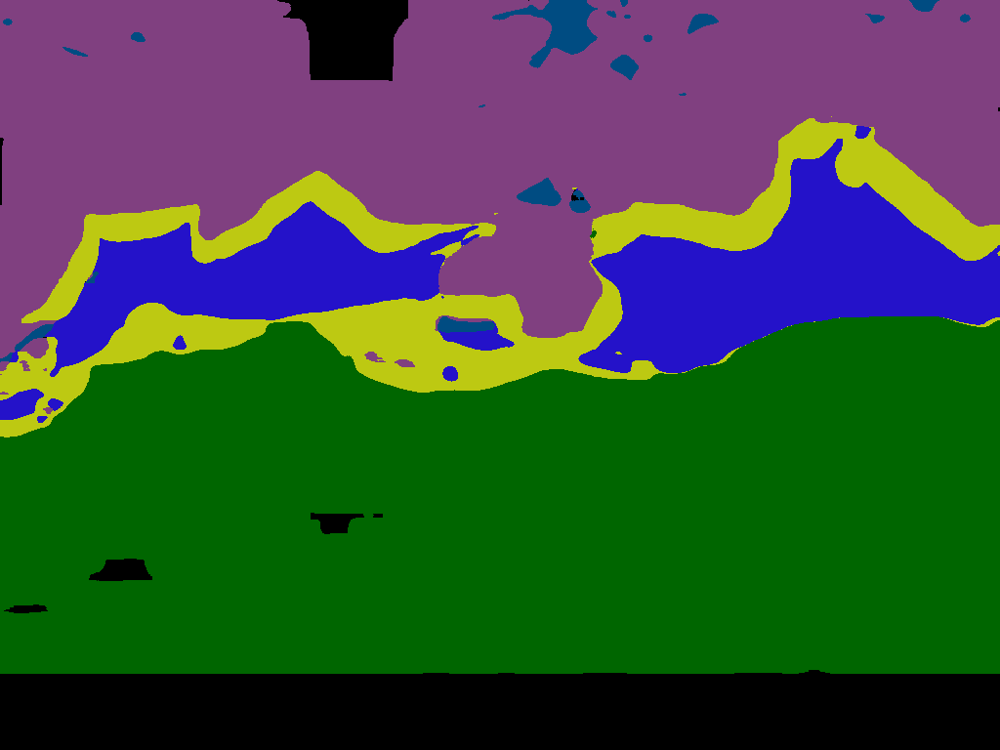

[0.43666323 0.94324324 0.98780488 0.98123324 0.49134948 0.91407678]
SLTE.C16CR11.w5.2.jpg


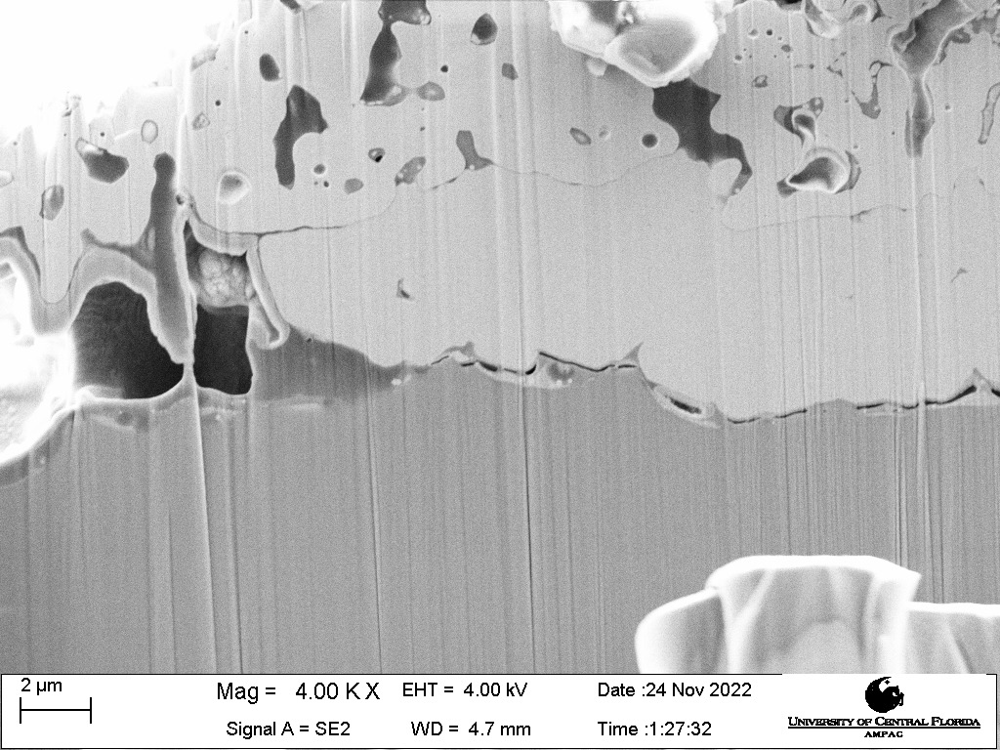

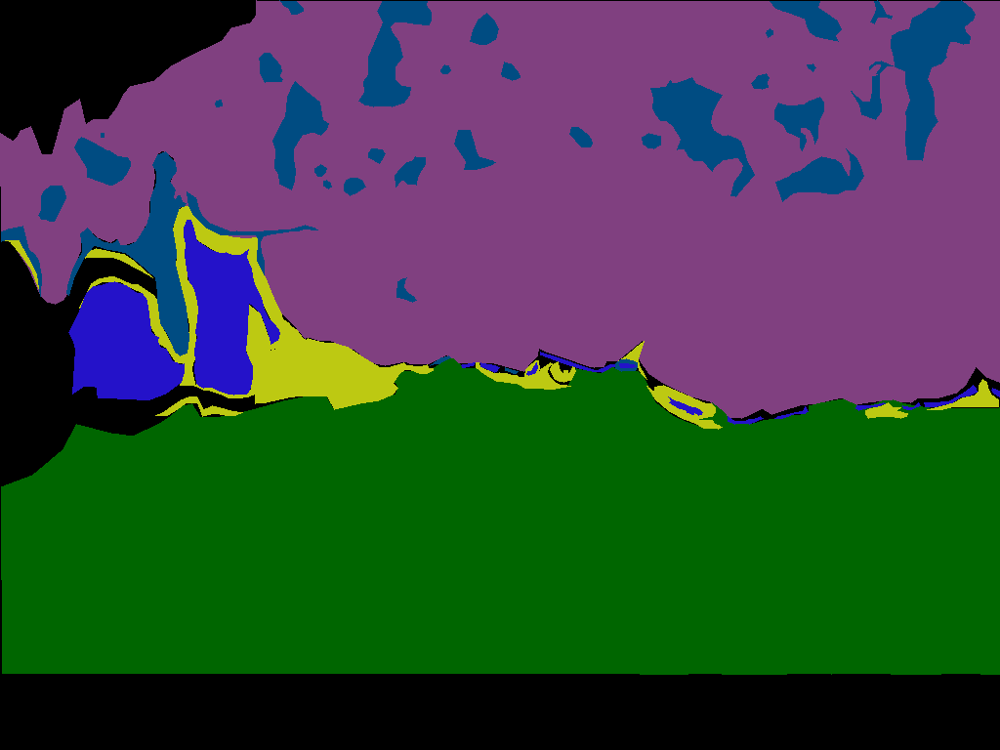

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


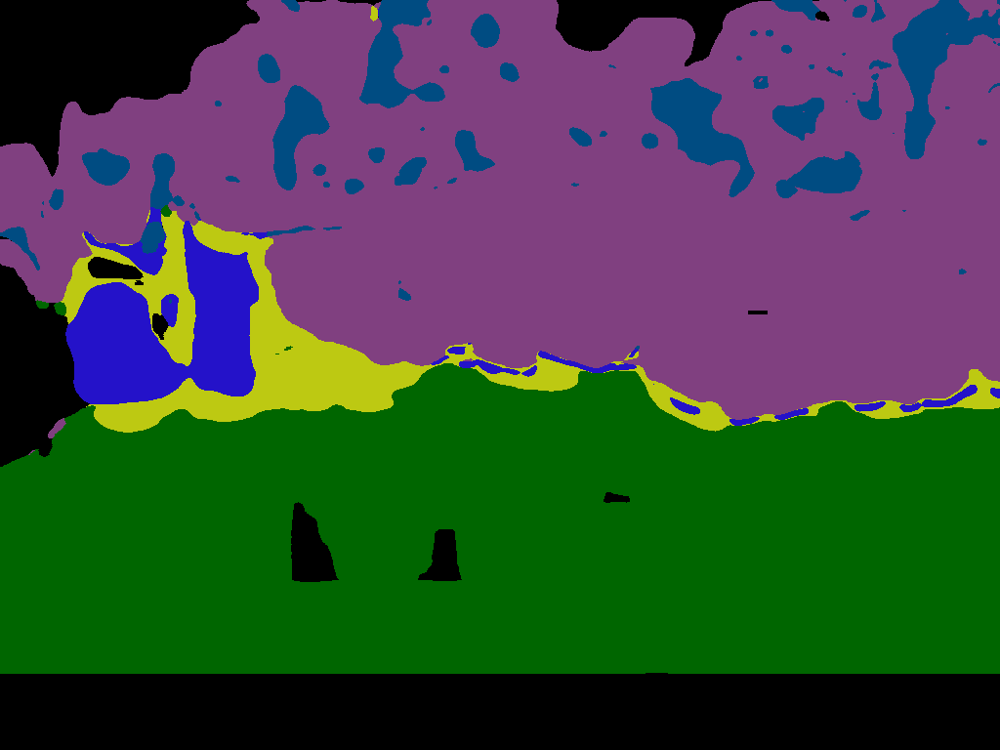

[0.84598047 0.97168743 0.95137421 0.9408284  0.88500728 0.95022624]
SLTE.C17BB11.c2.1.jpg


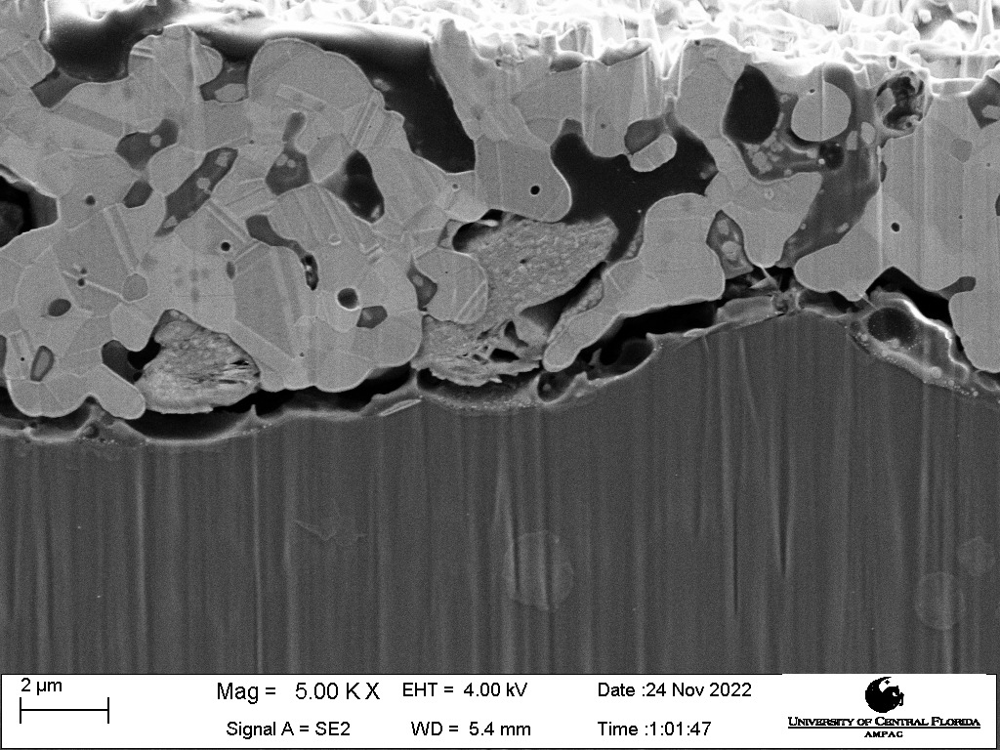

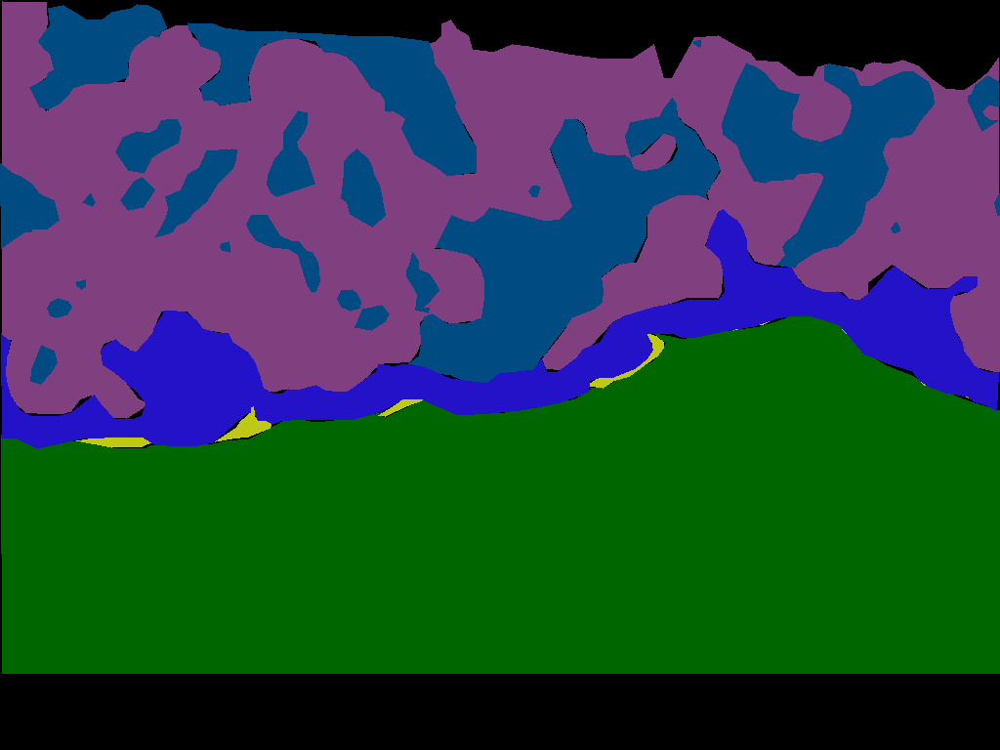

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


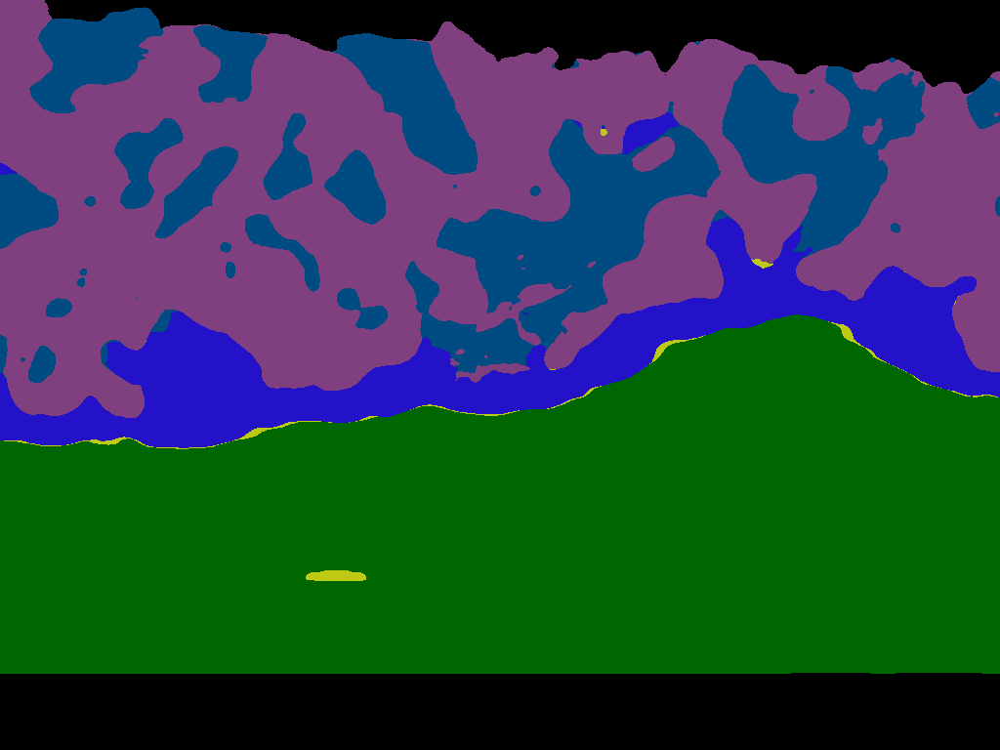

[0.37353255 0.99766355 0.82142857 0.9972752  0.99354839 0.88104089]
SLTE.C17BB11.c1.2.jpg


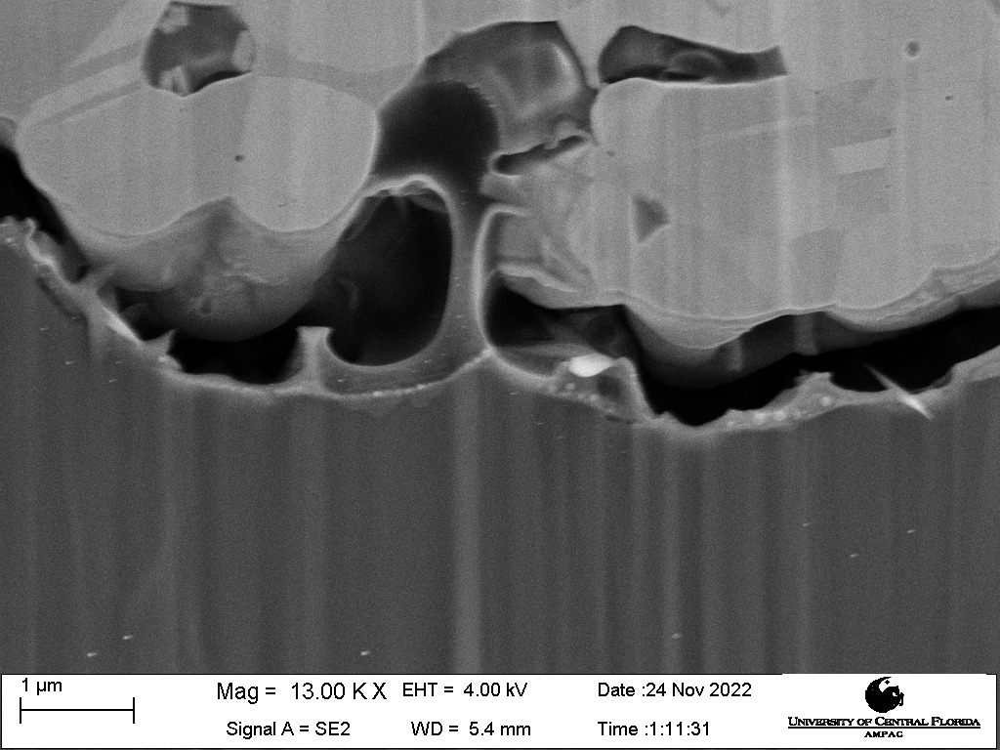

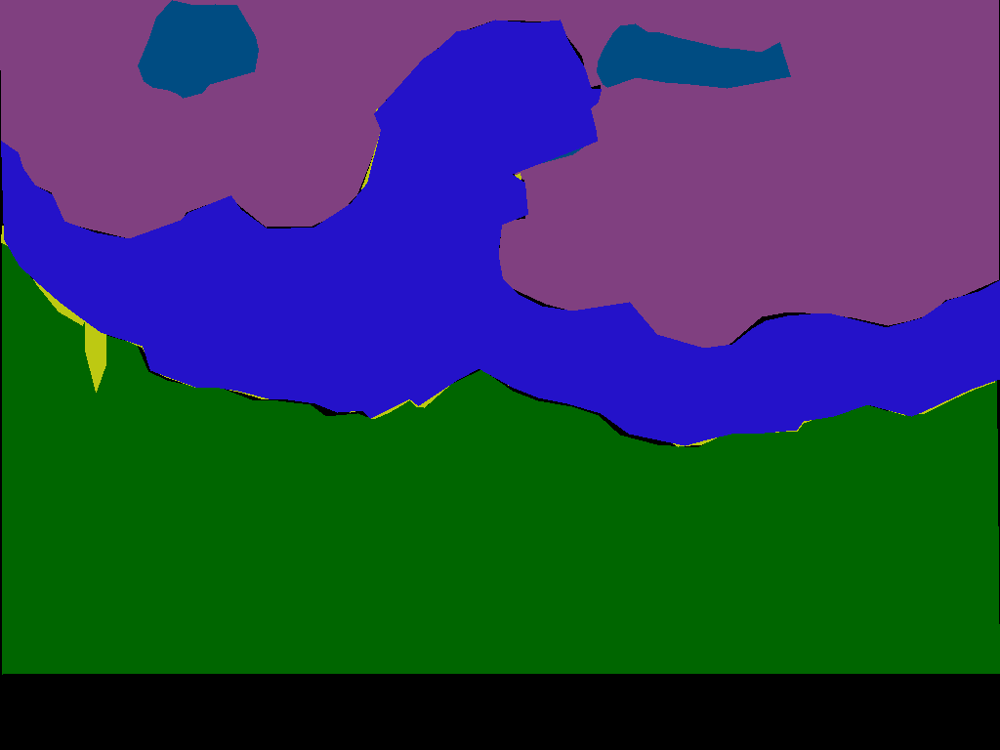

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


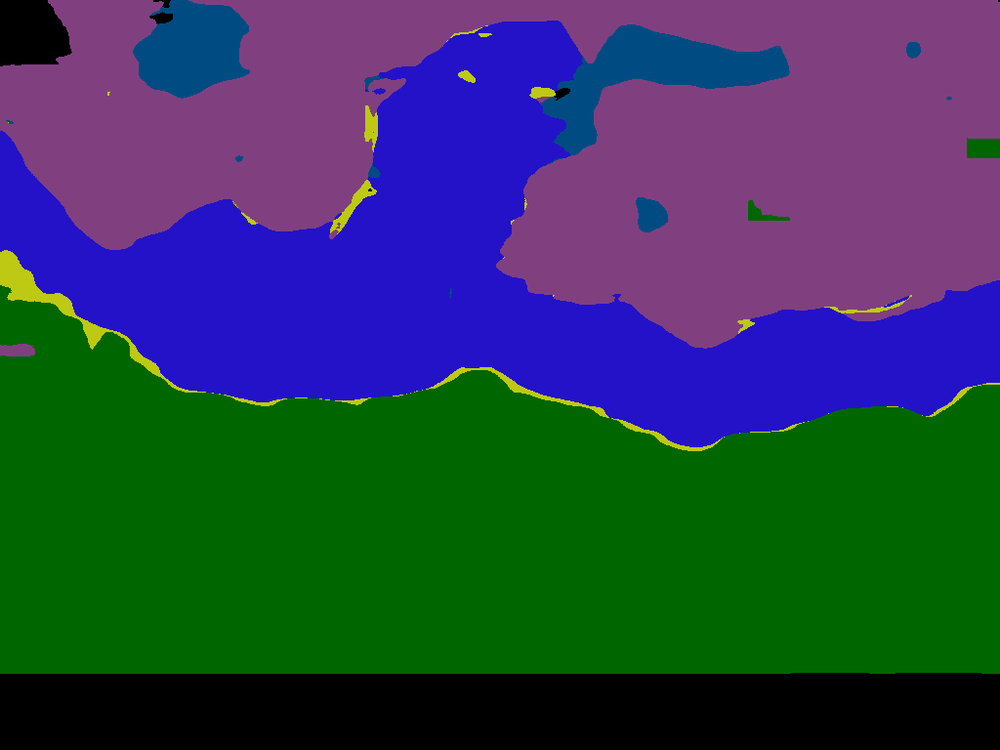

[0.35016112 0.98751734 0.67911715 0.90249433 0.67241379 0.99771167]
SLTE.C17BB11.c3.1.jpg


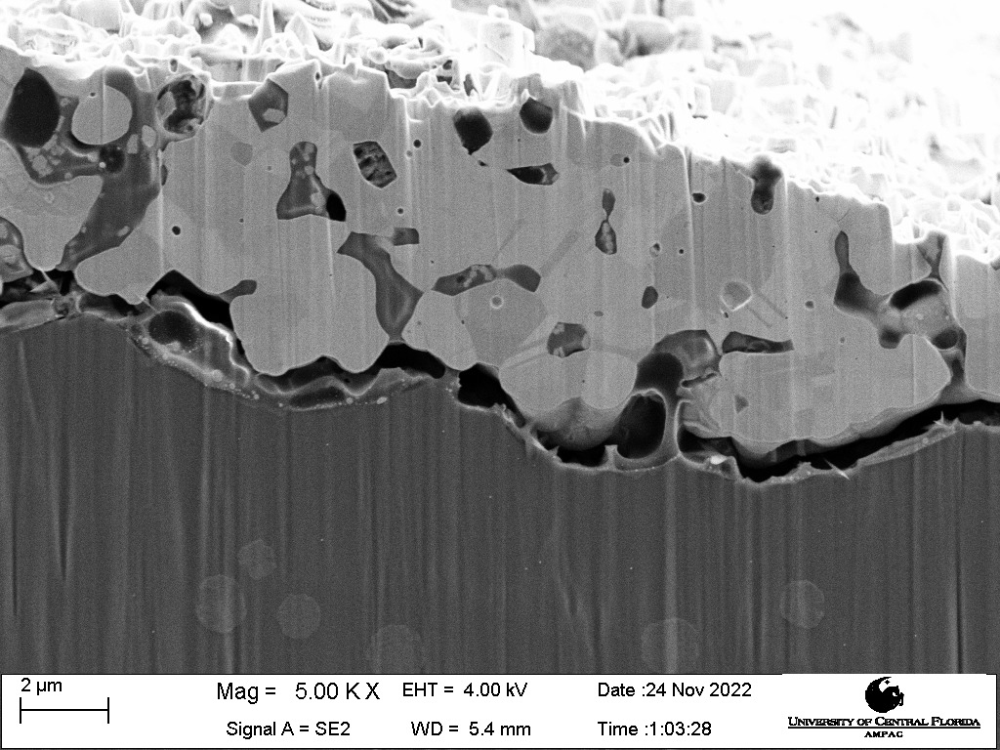

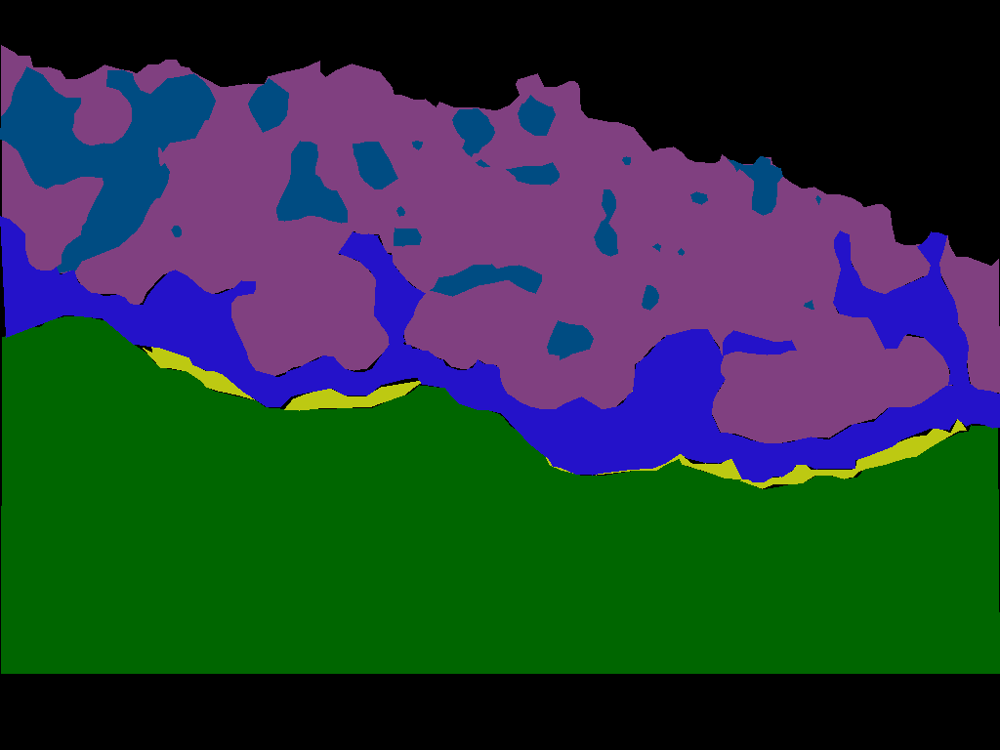

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


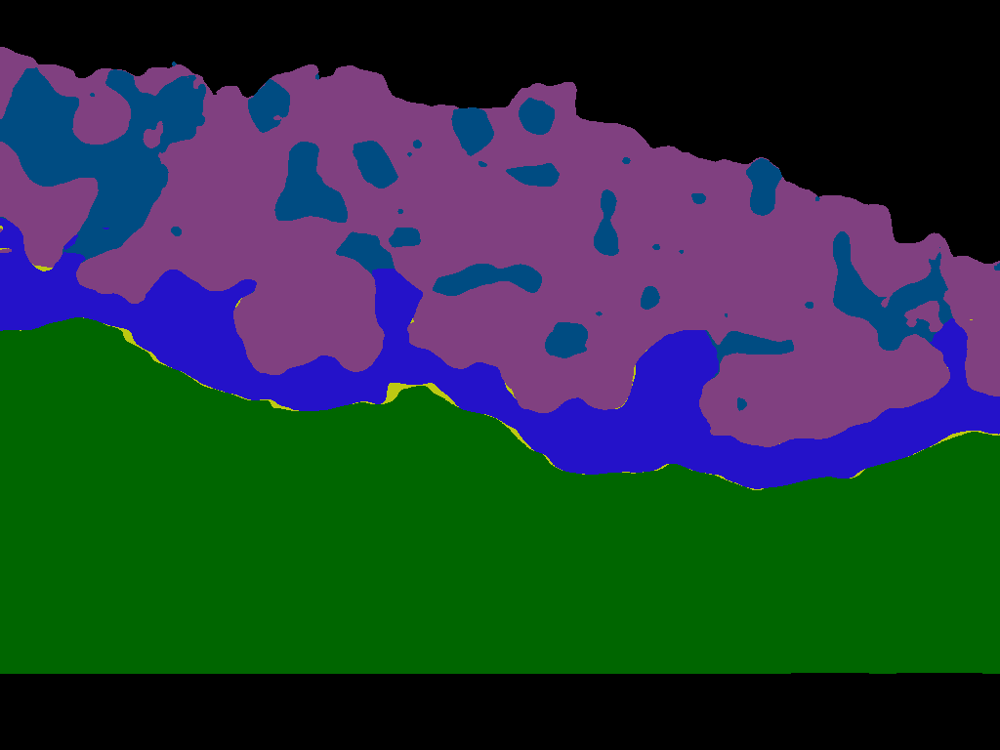

[0.62488809 0.99266504 0.81791045 0.99863201 0.92209857 0.98366606]
SLTE.C16CR11.w3.2.jpg


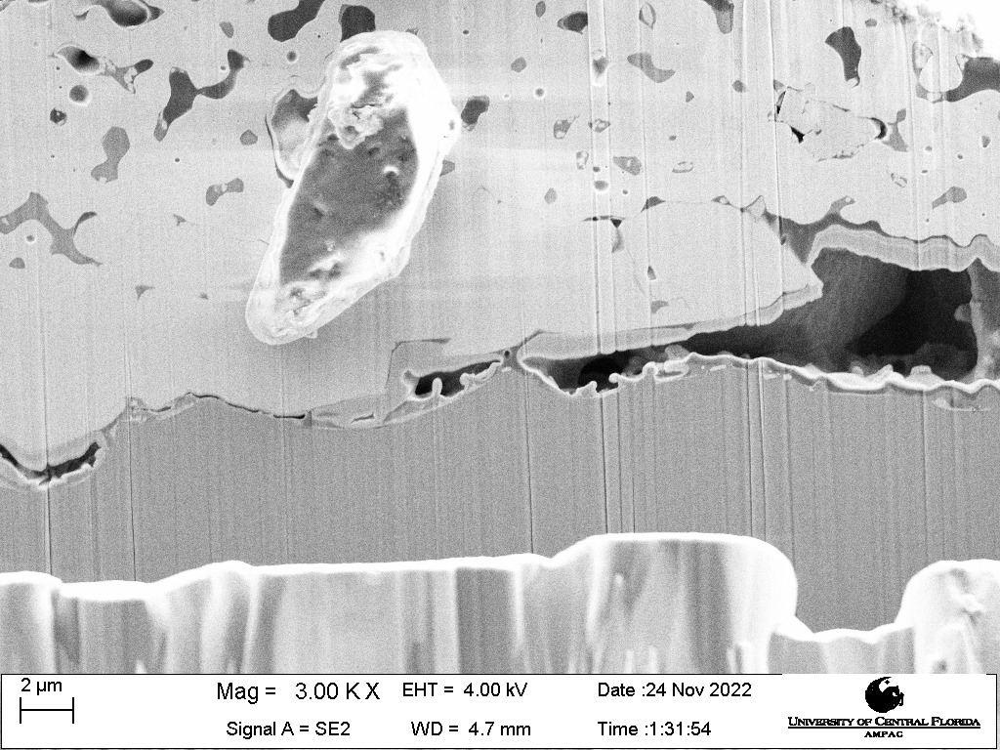

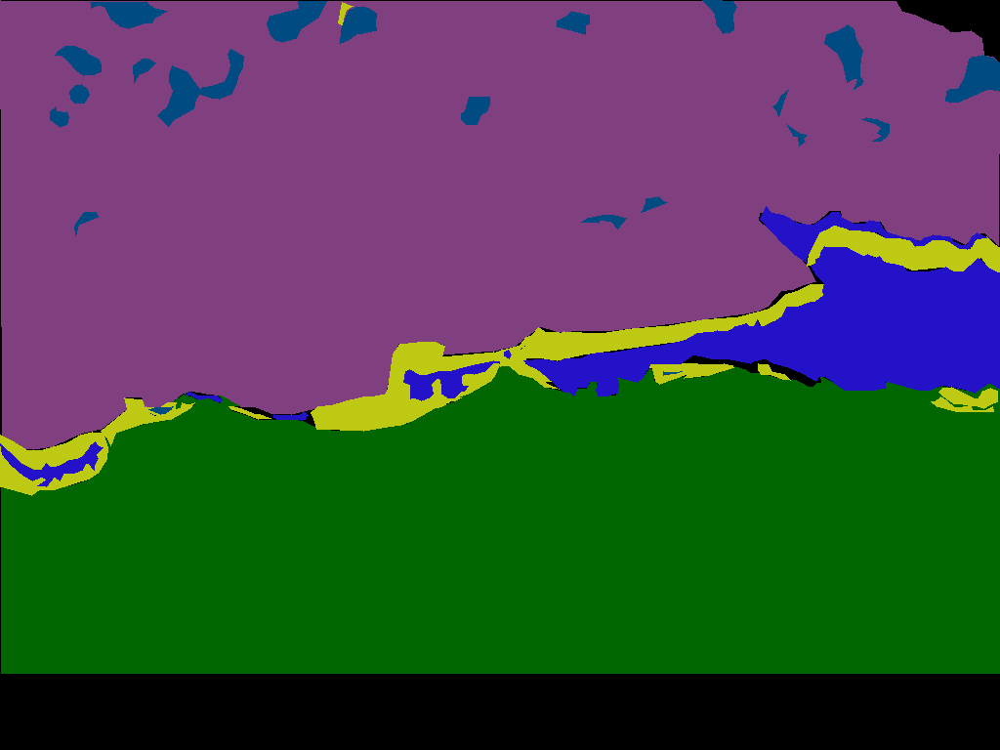

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


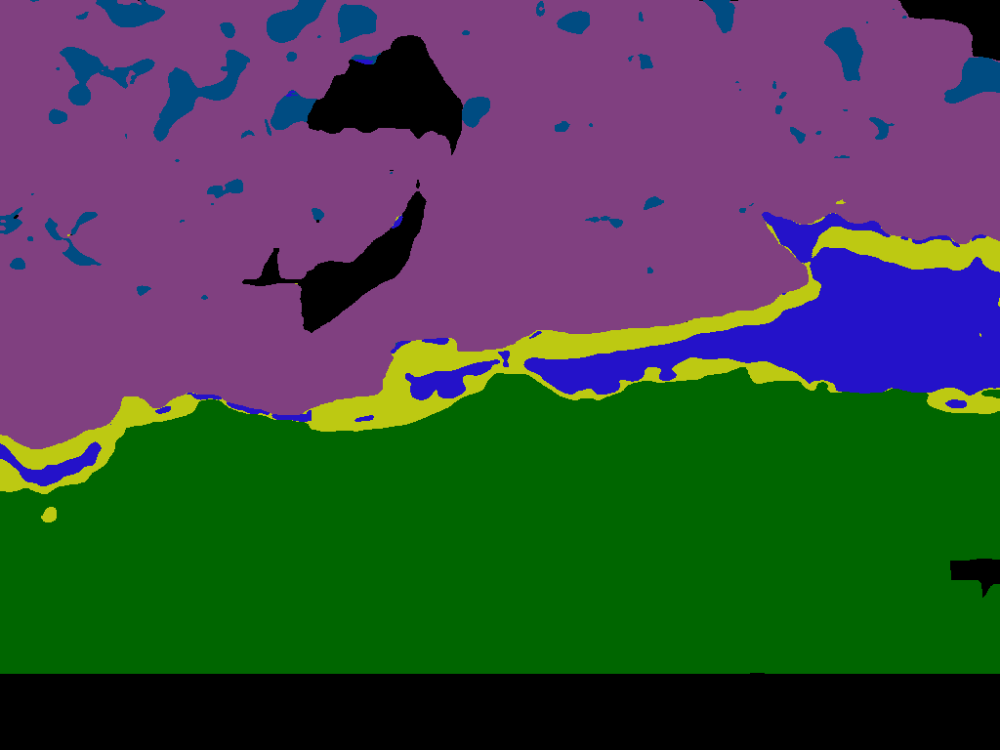

[0.68688671 0.99891422 0.88107203 0.99841017 0.78991597 0.94559099]
SLTE.C16CR11.w1.1.png


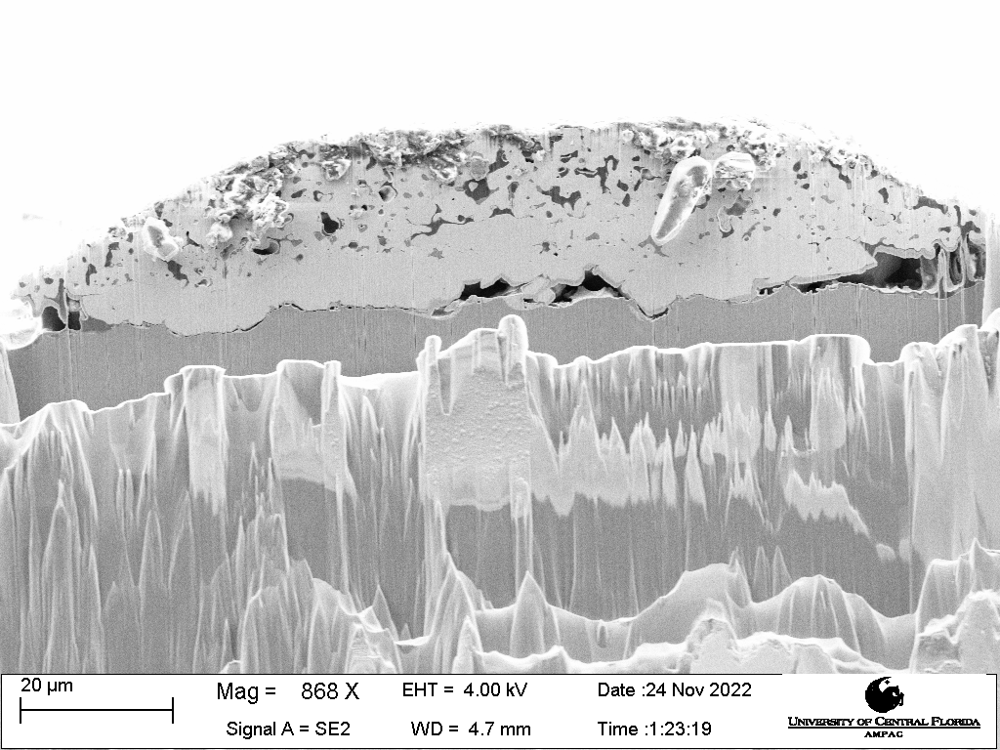

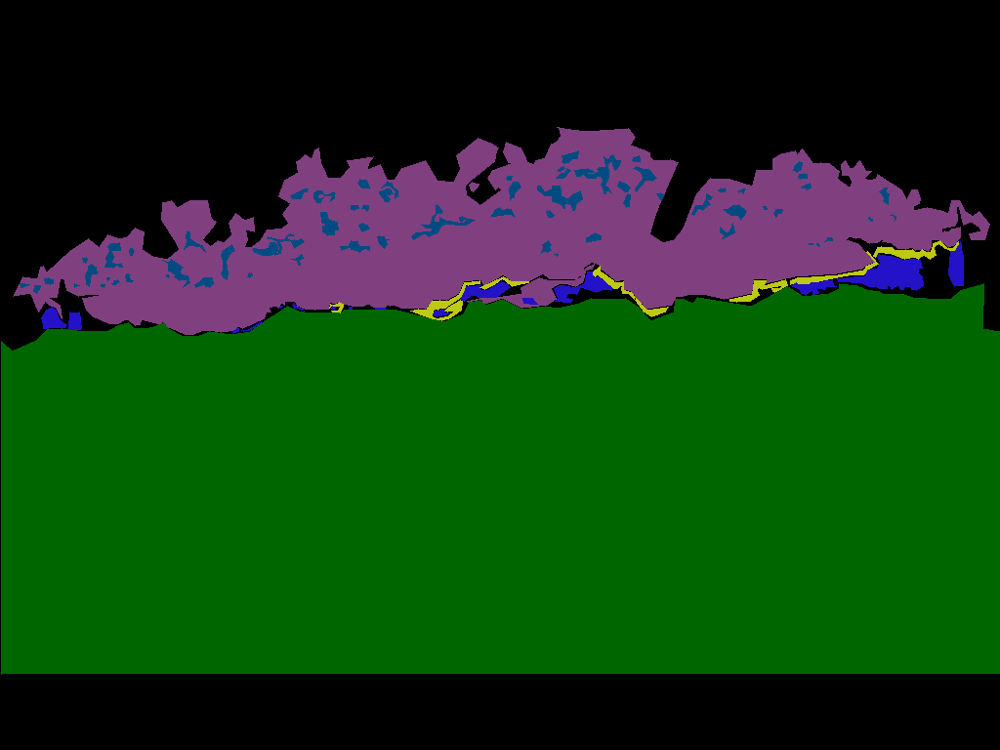

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


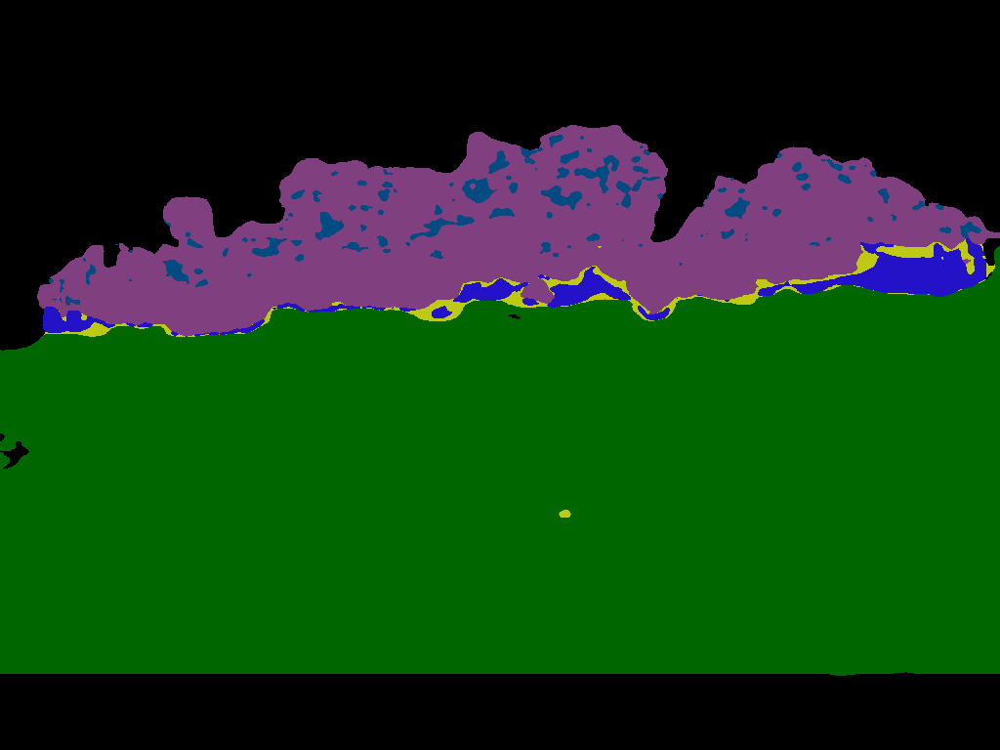

[0.76427997 0.99069767 0.86910995 0.95362663 0.9125     0.96938776]
SLTE.C16CR11.w2.1.png


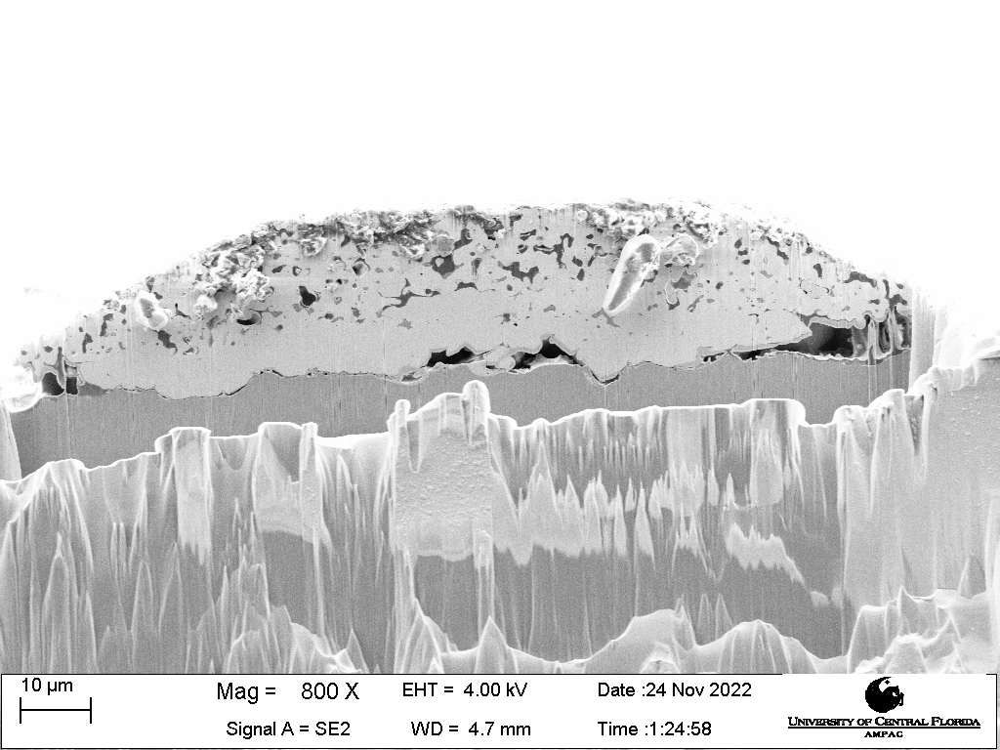

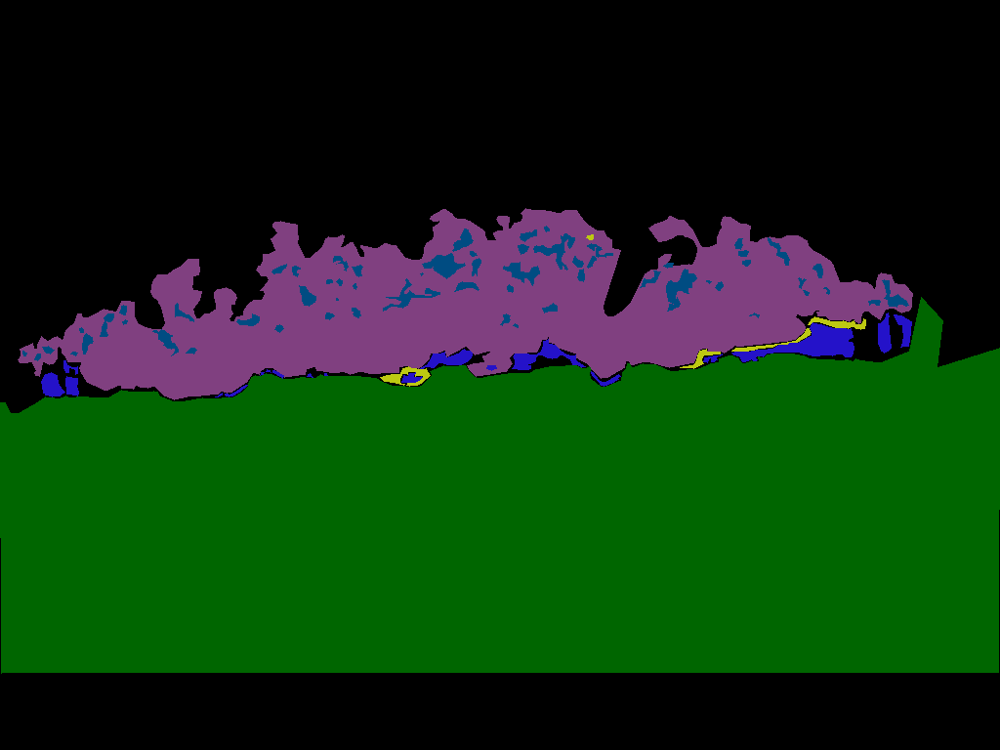

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


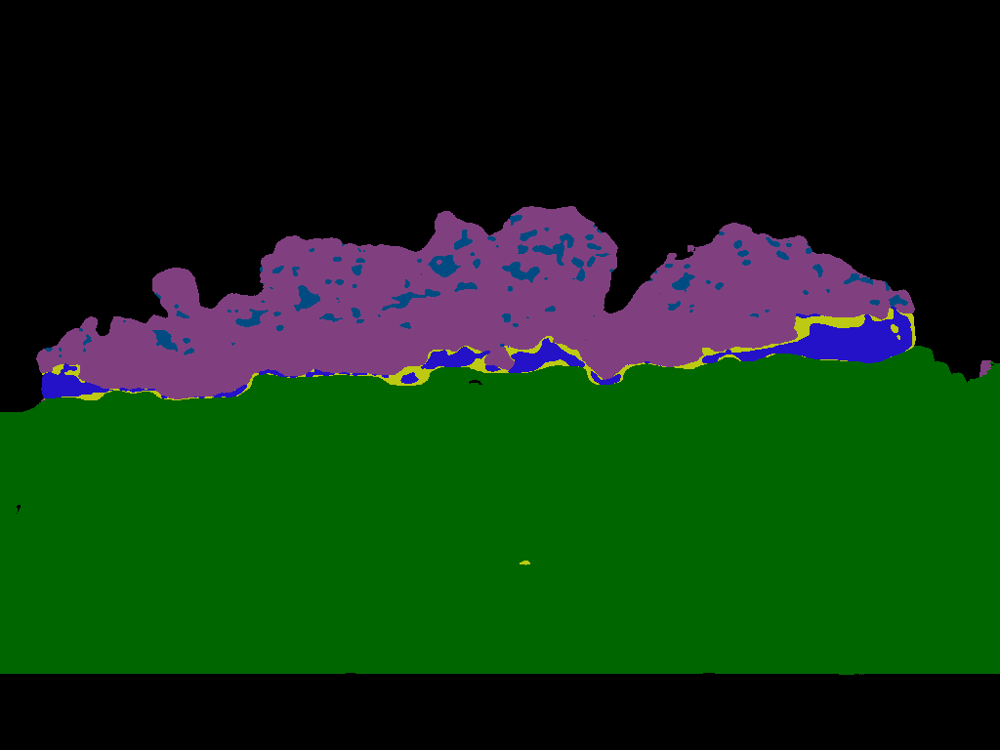

[0.85568761 0.99244332 0.80898876 0.92946058 0.94736842 0.96132597]
SLTE.C16CR11.w2.2.jpg


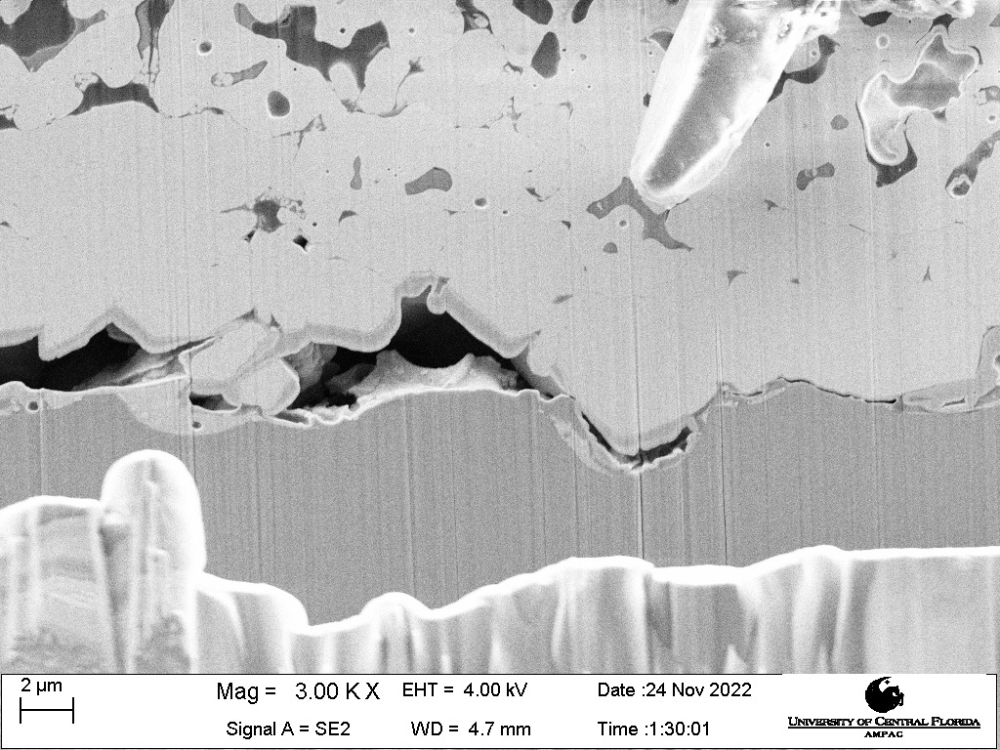

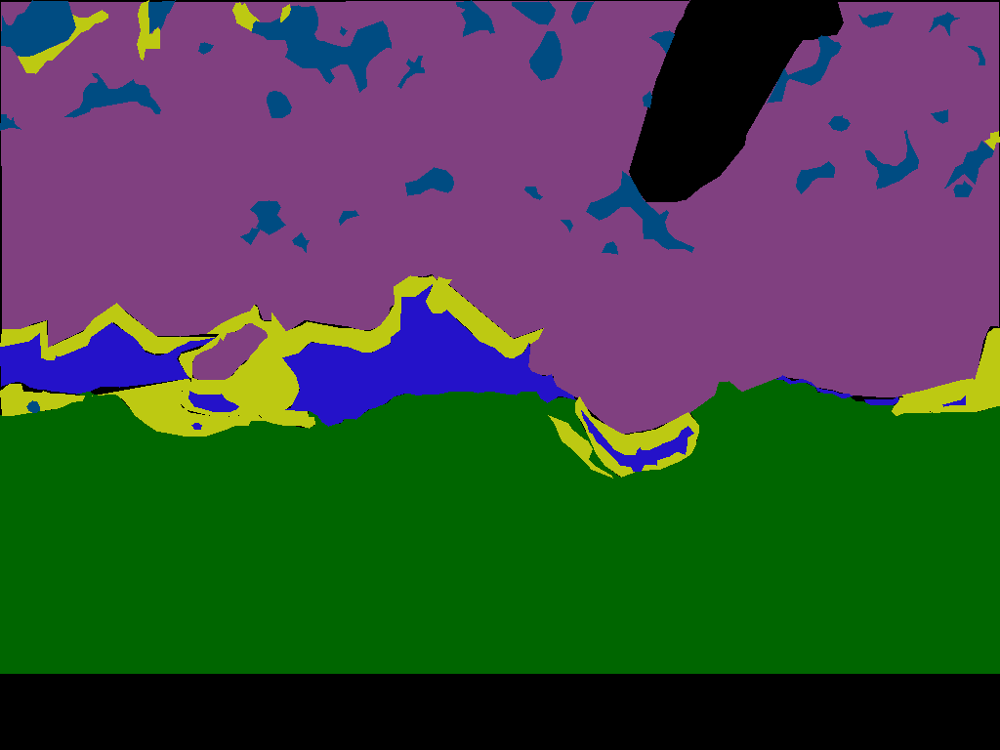

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


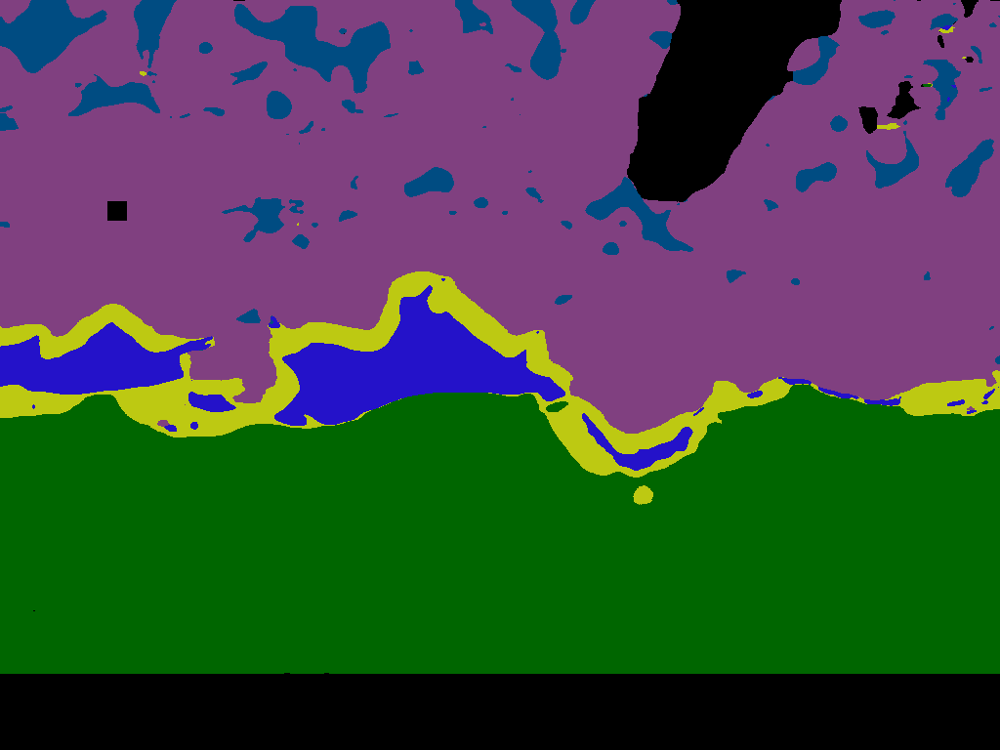

[0.72901679 0.99887514 0.77797513 0.98507463 0.88324873 0.95238095]
FGCU.3767.C10BB21.c4.2.png


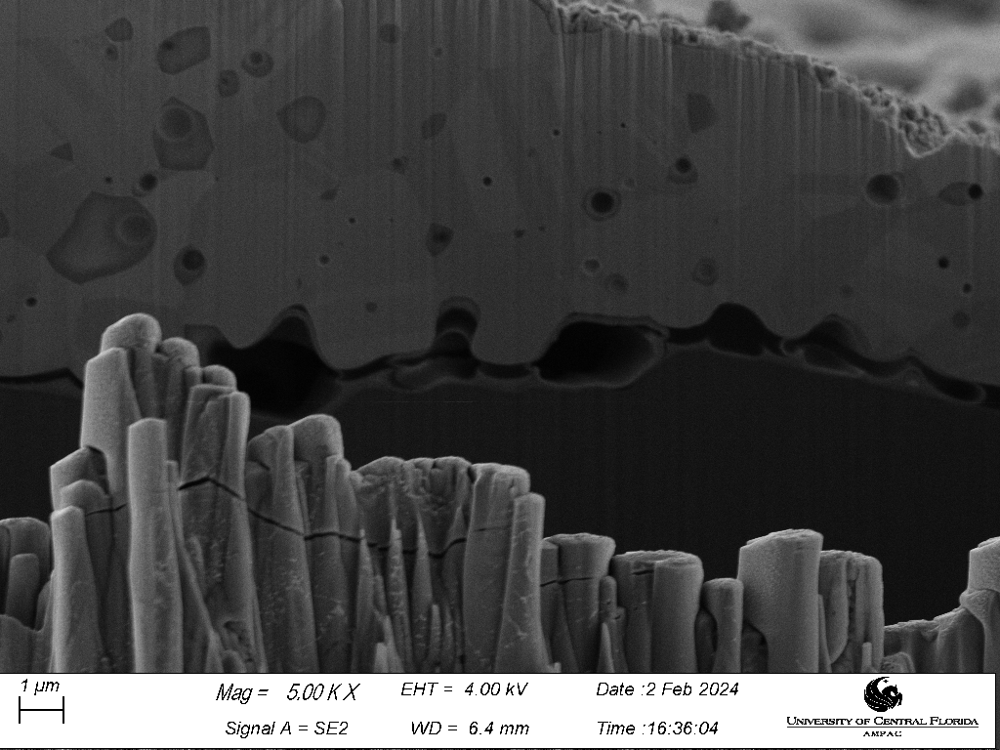

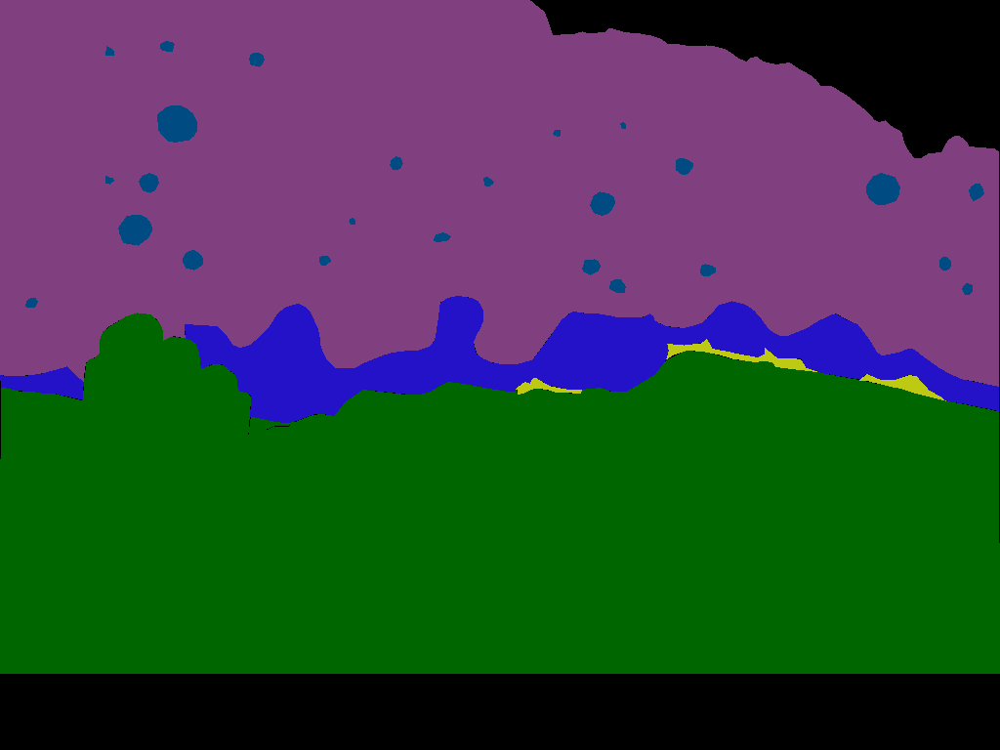

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


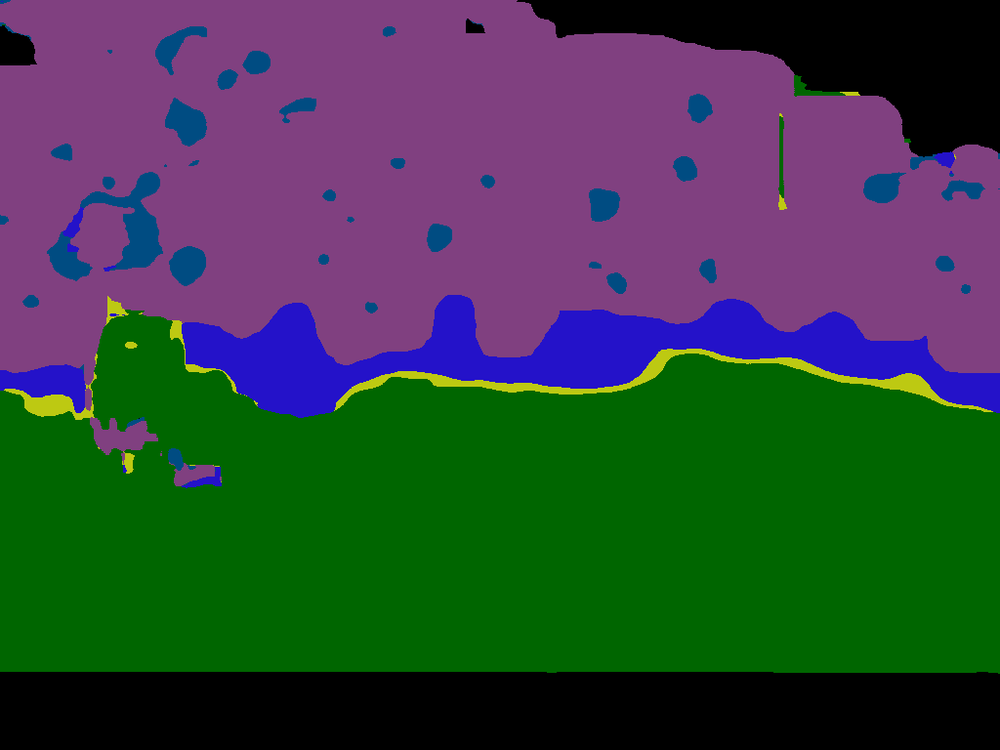

[0.54794521 0.89064262 0.50819672 0.87058824 0.74245115 0.7204611 ]
FGCU.3767.C10BB21.c2.1.png


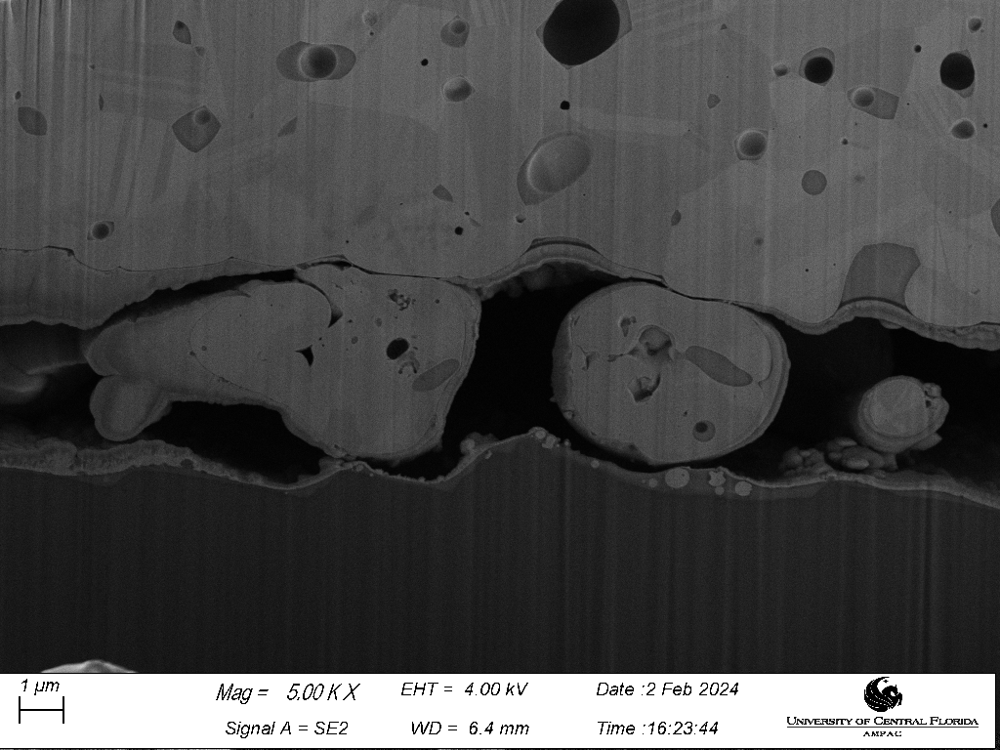

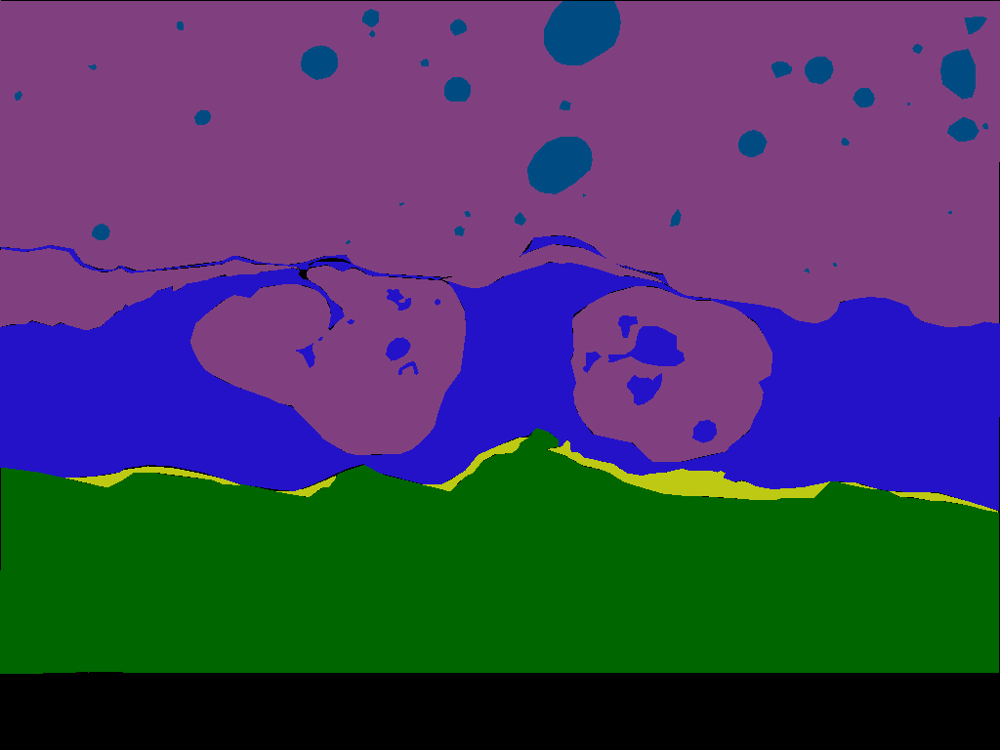

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


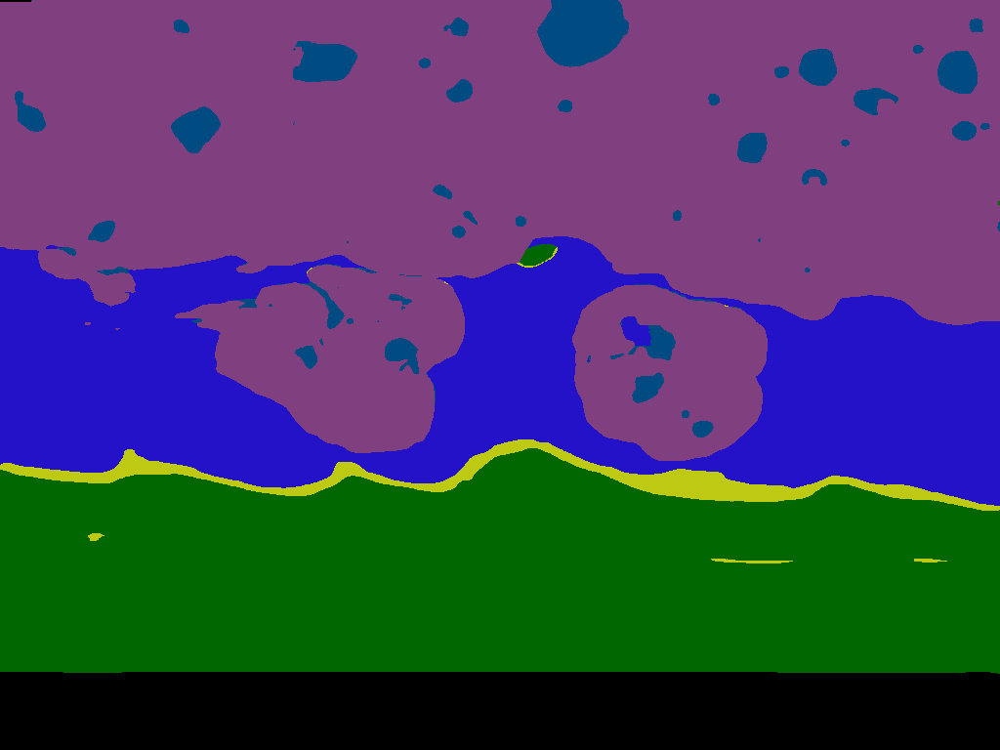

[0.26213592 0.9968321  0.74871795 0.90766208 0.72644377 0.98924731]
FGCU.3767.C10BB21.c1.1.png


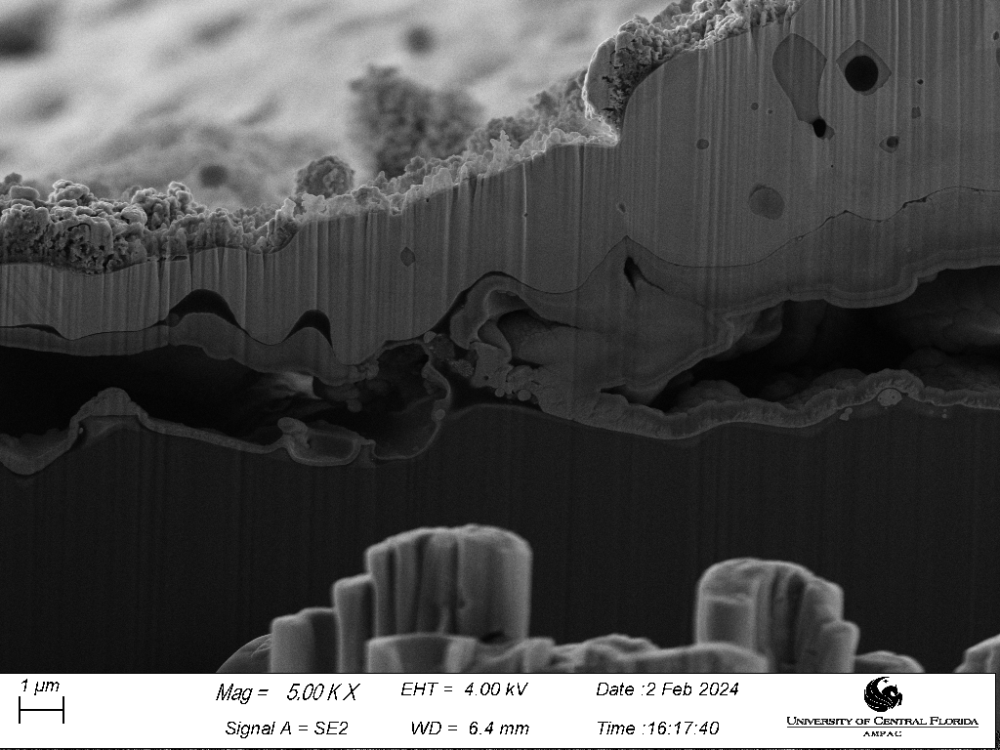

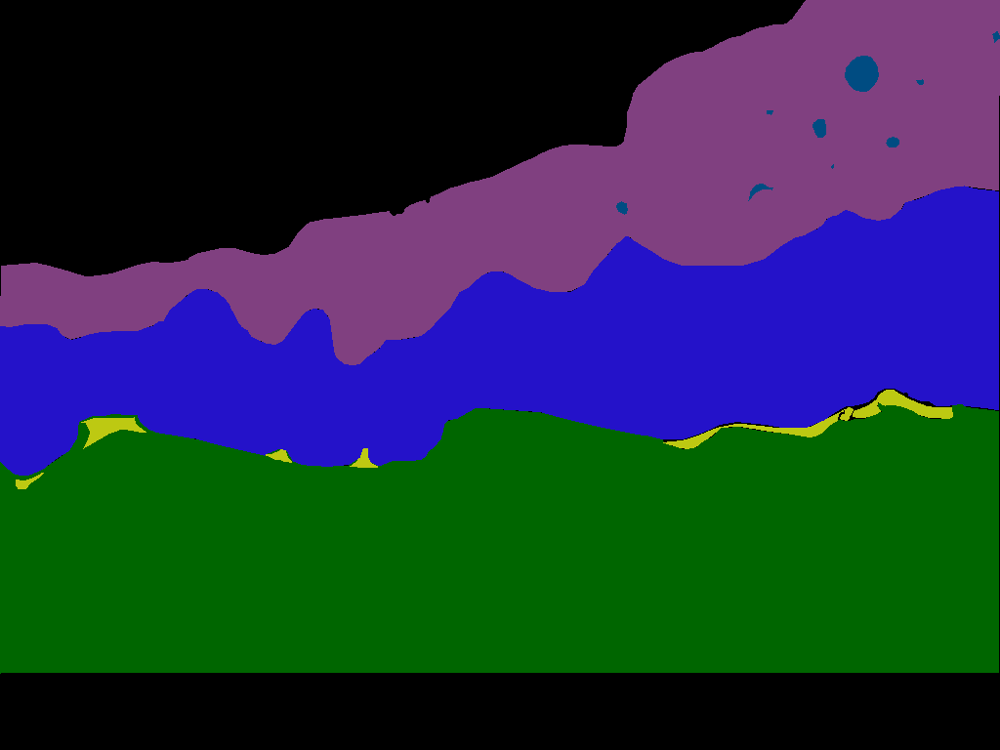

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


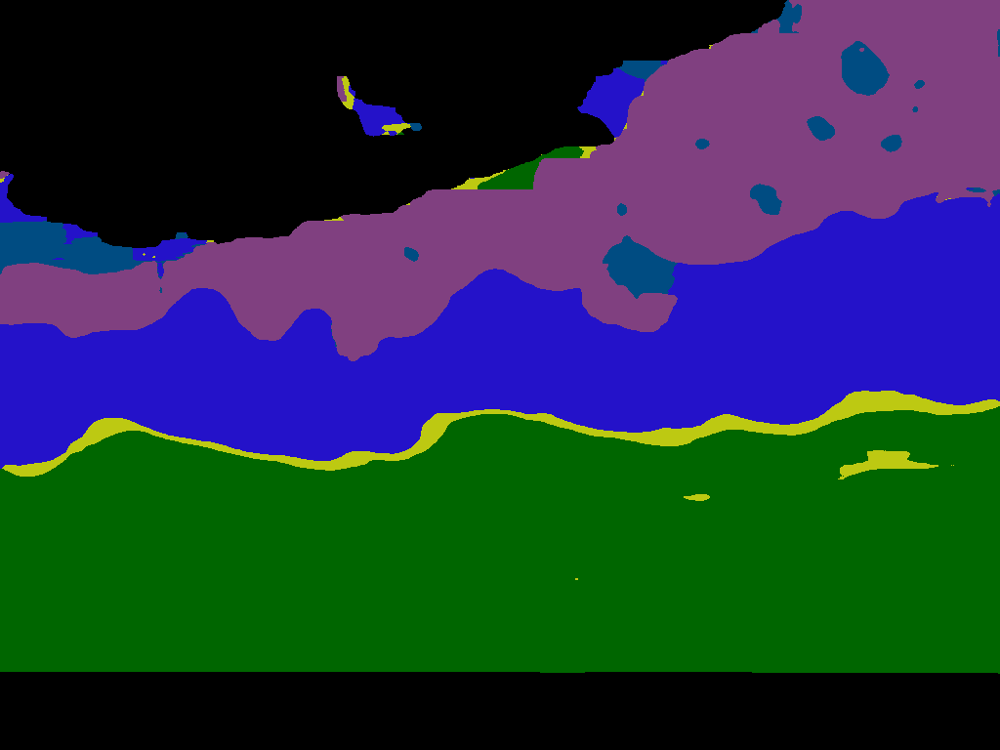

[0.6061706  0.99462366 0.57333333 0.91638796 0.57731959 0.86053412]
FGCU.3767.C10BB21.c5.1.png


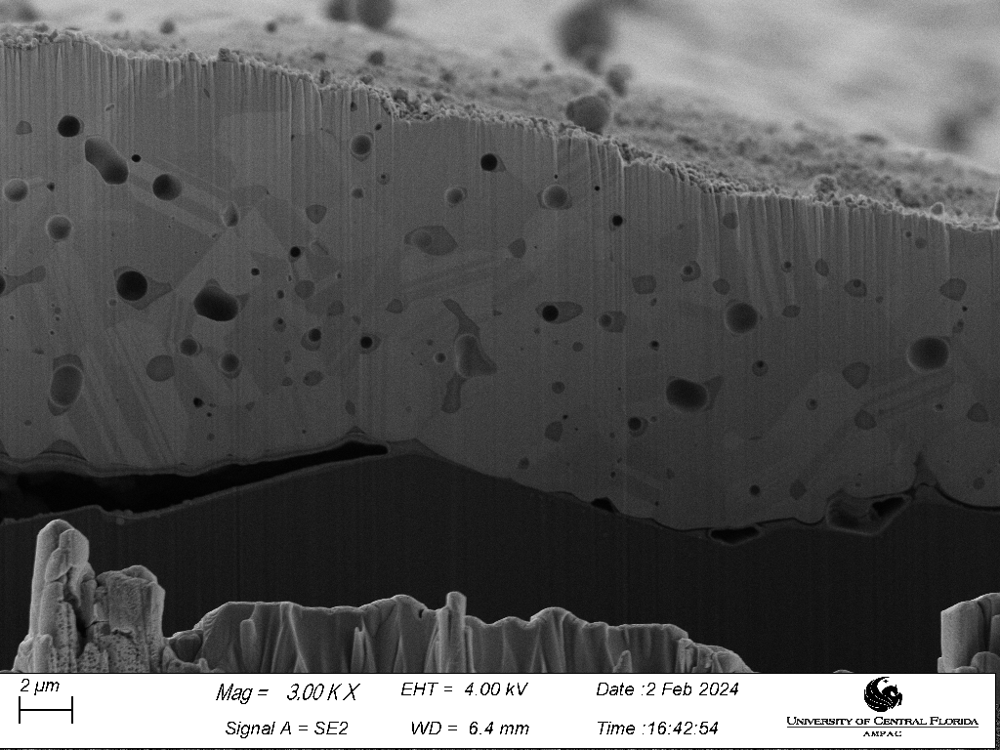

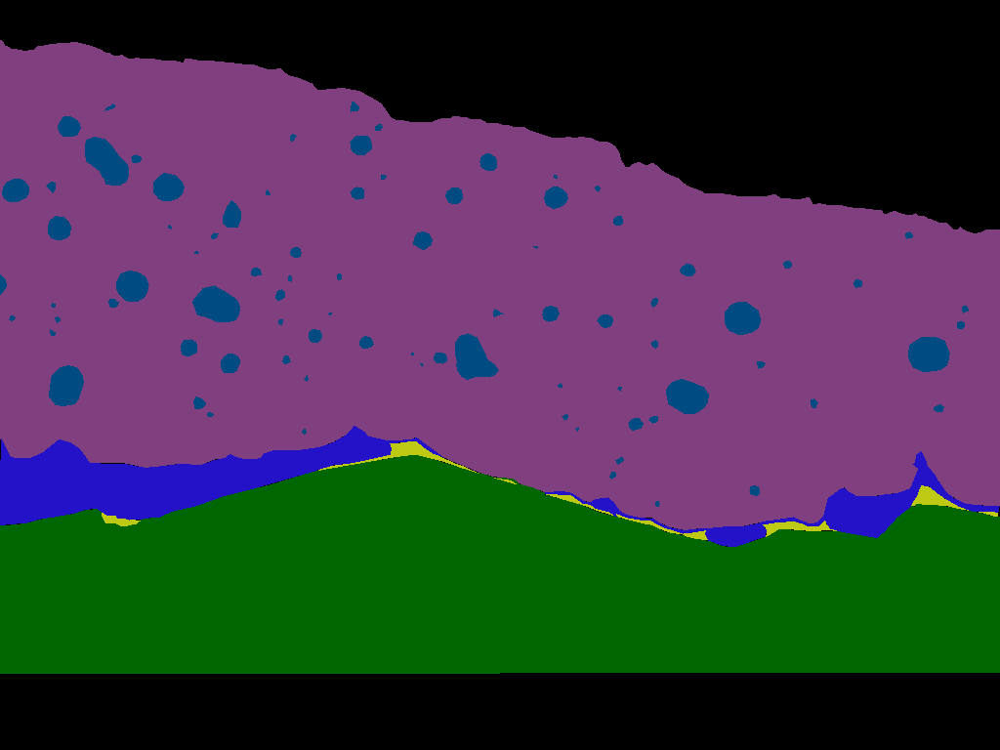

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


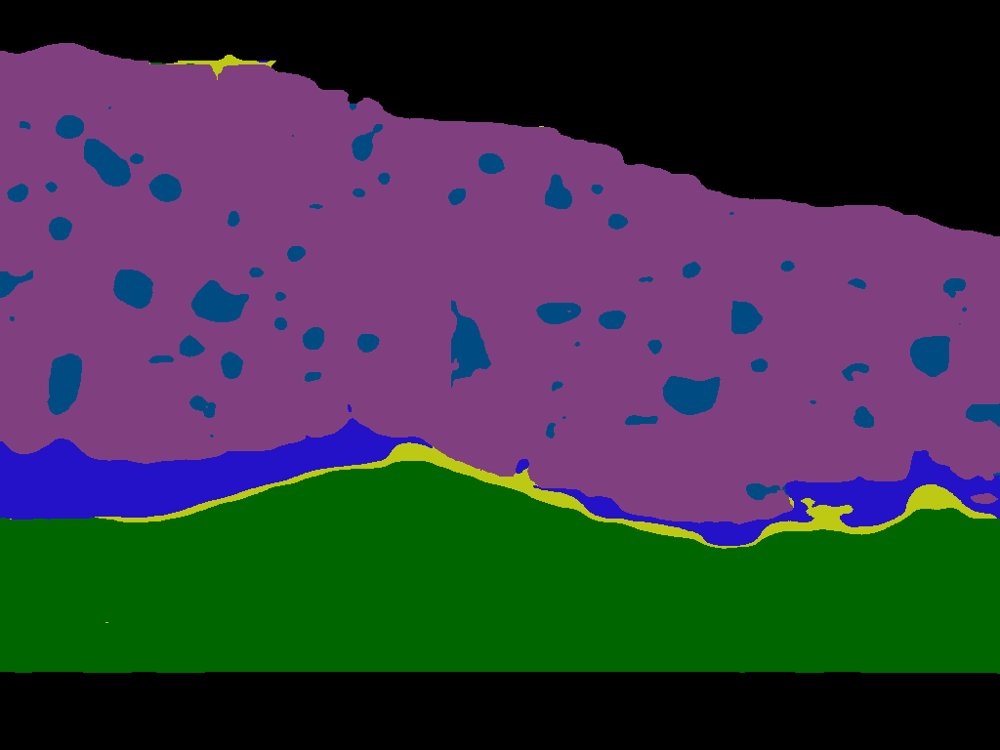

[0.86530612 0.99095477 0.81545064 0.98198198 0.93888889 0.92830189]
FGCU.C18BB24.c1.5.png


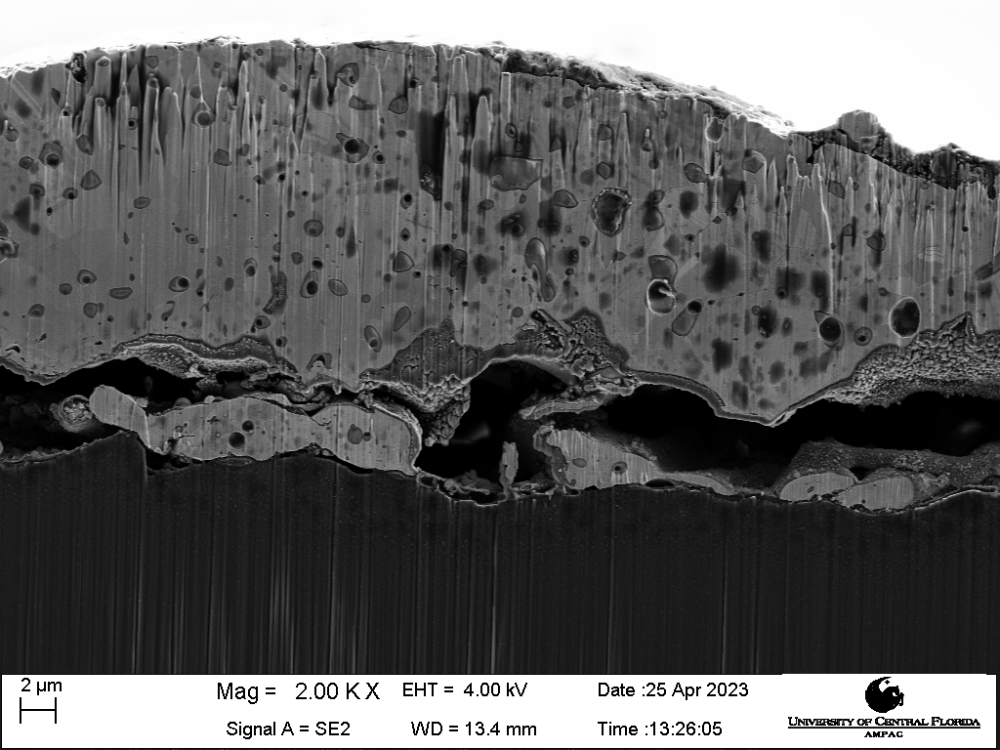

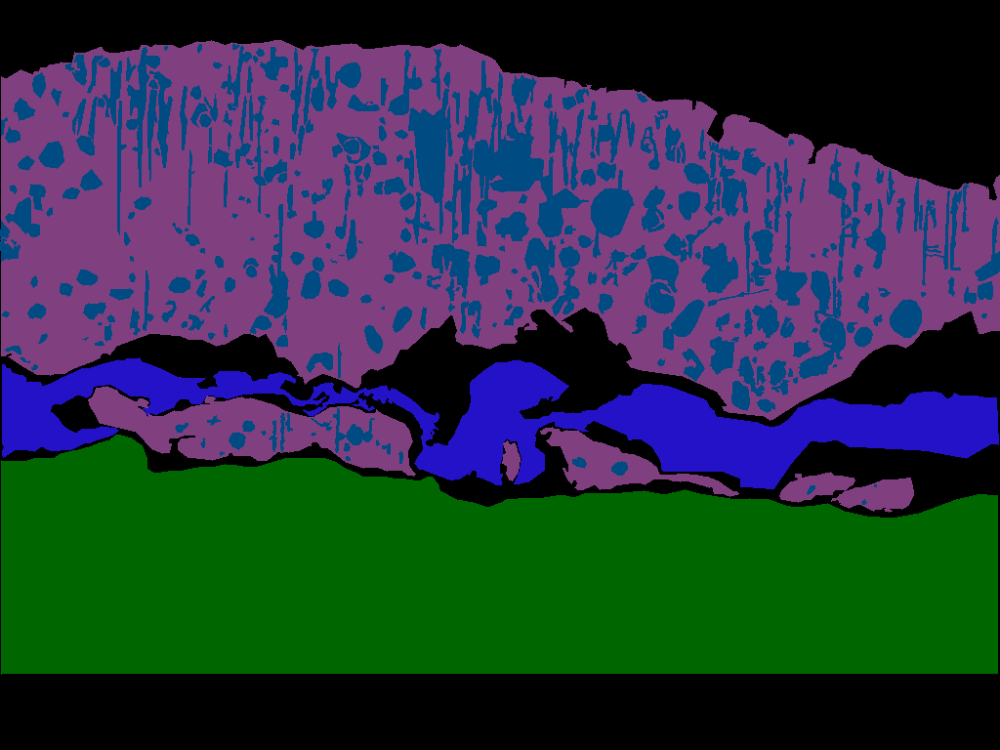

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


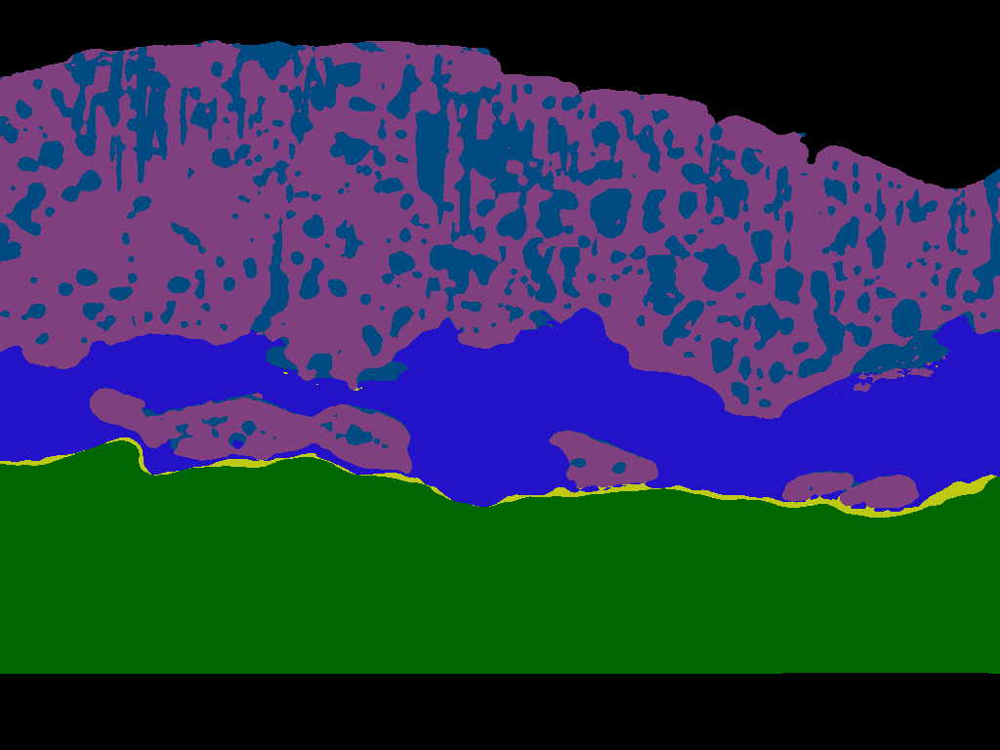

gLASSgLASS.GG1.w1.1.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


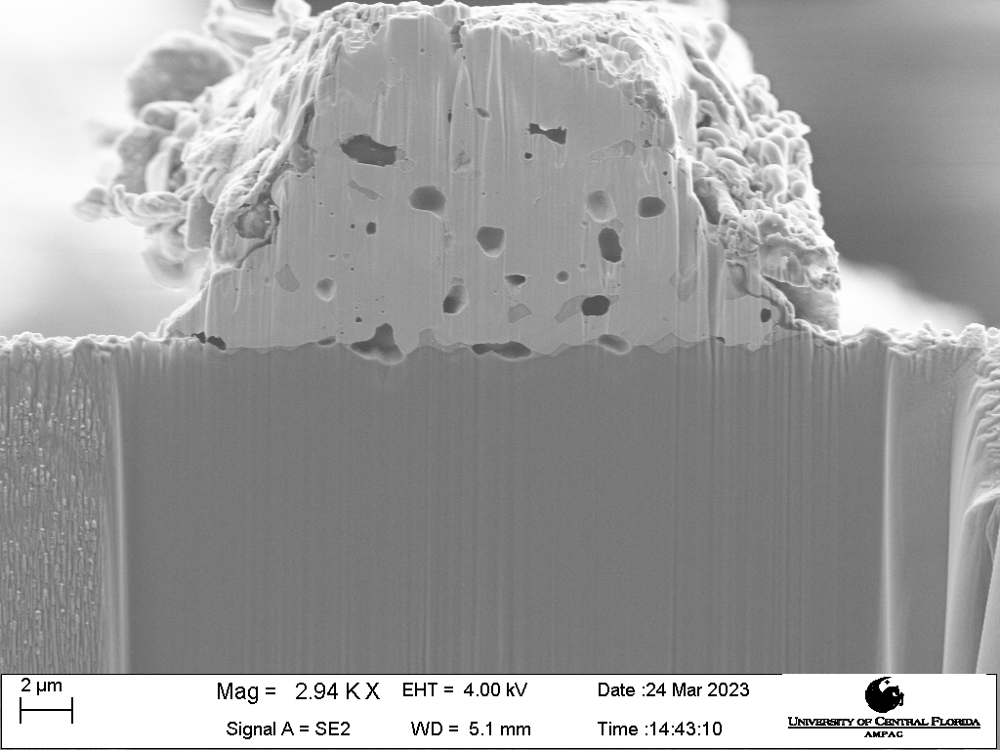

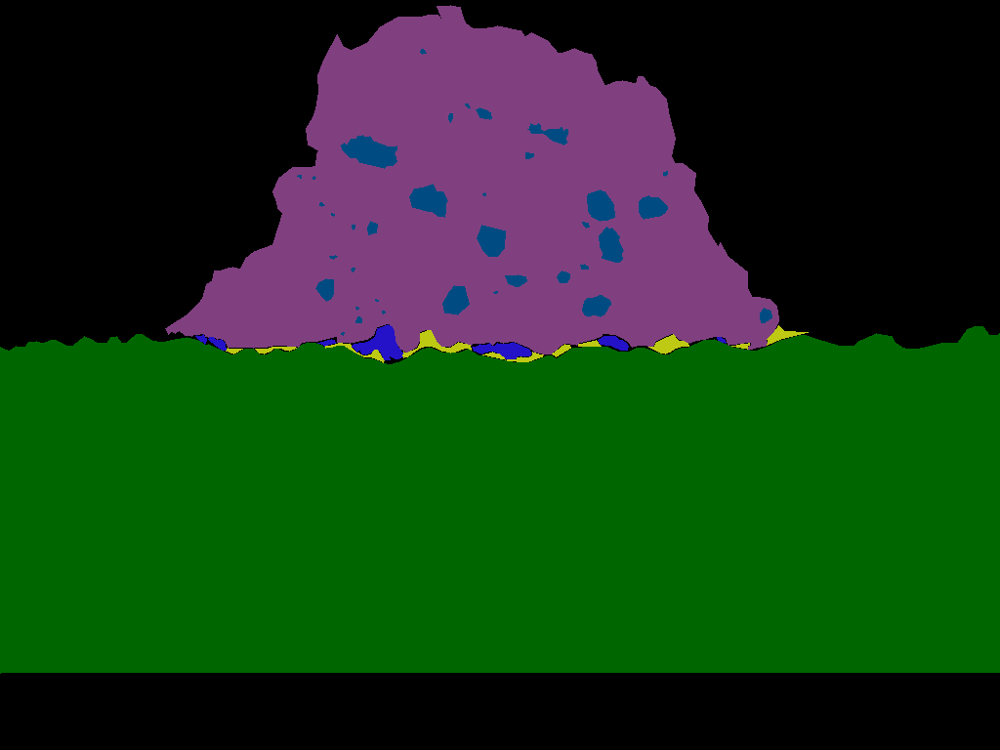

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


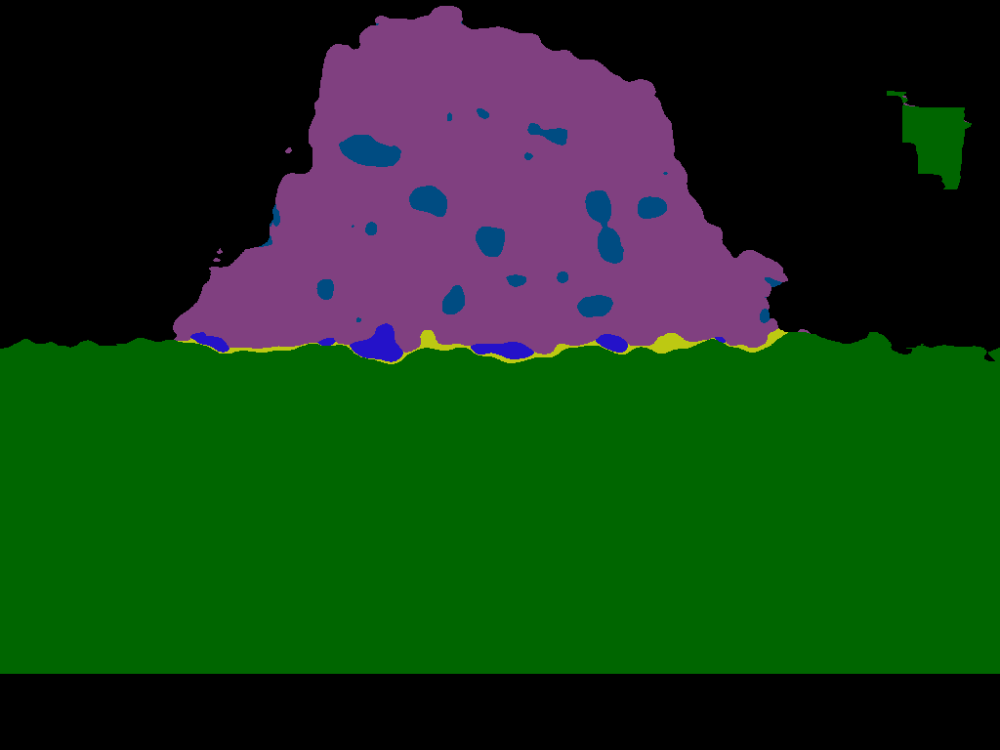

[0.99555556 0.9986014  0.94736842 0.86848635 0.90610329 0.96103896]
FGCU.C18BB24.c3.3.png


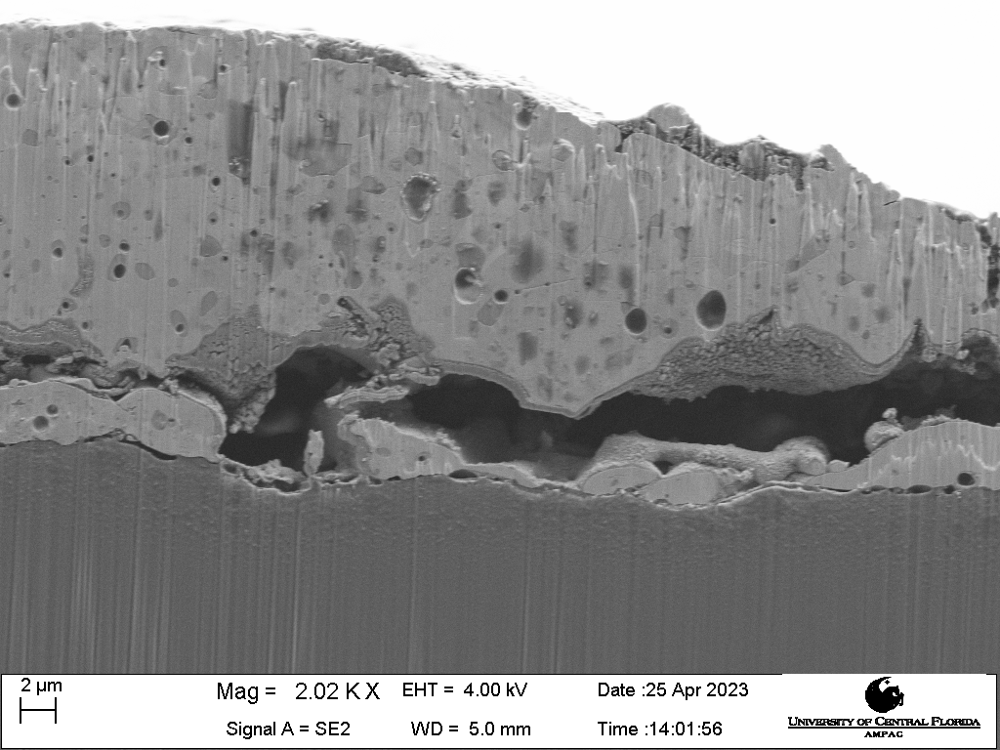

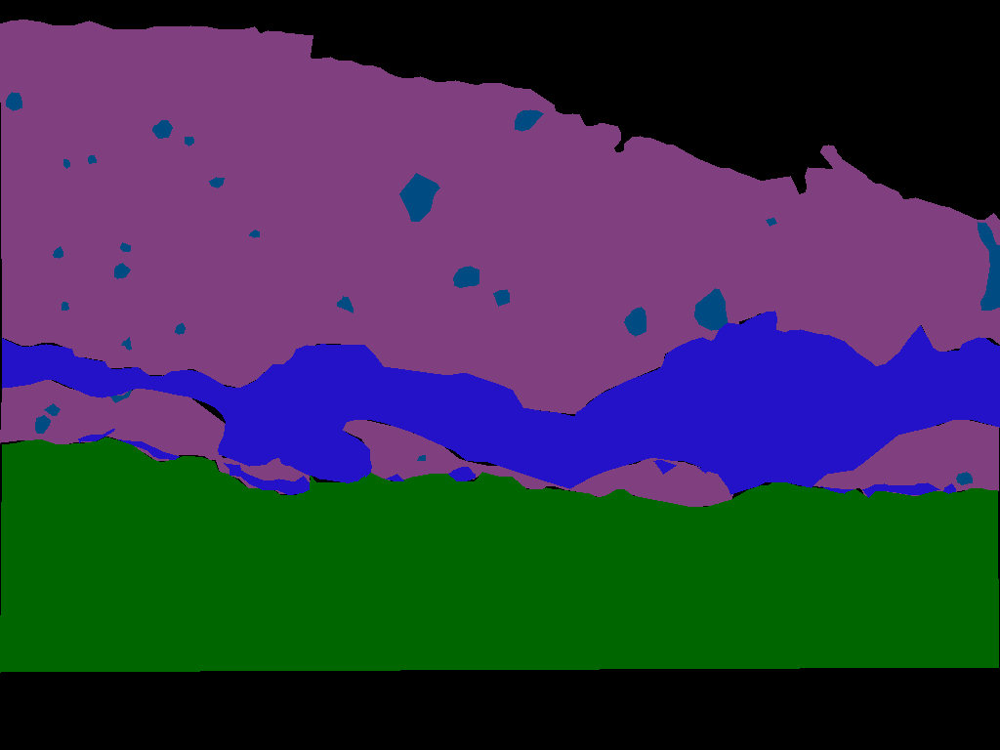

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


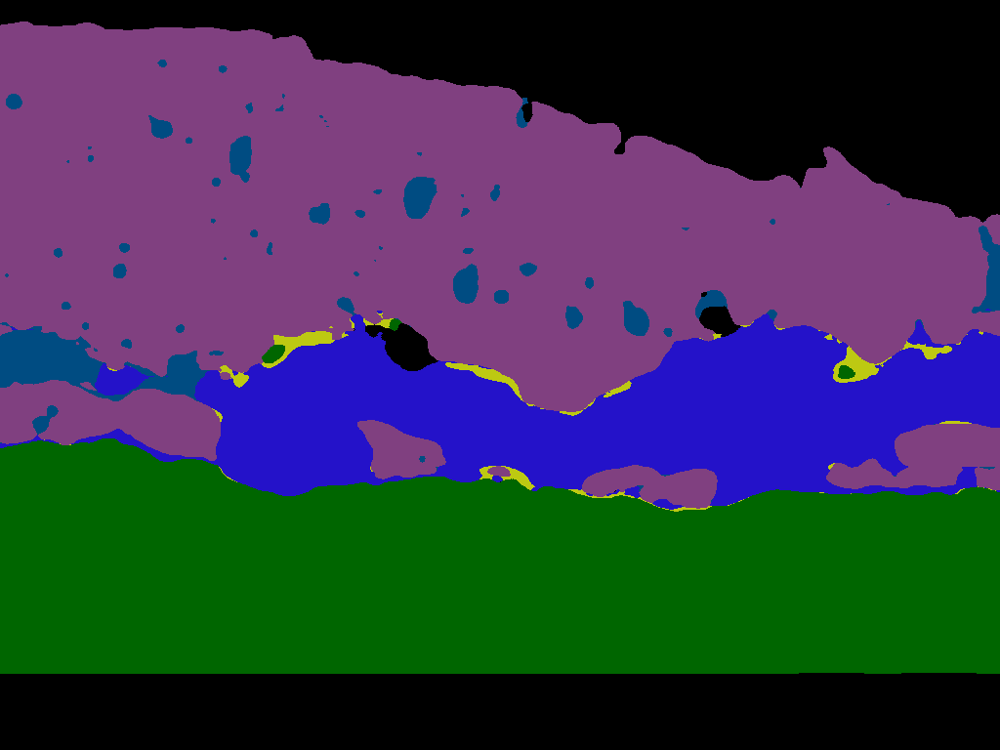

FGCU.C18CR12.w3.1.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


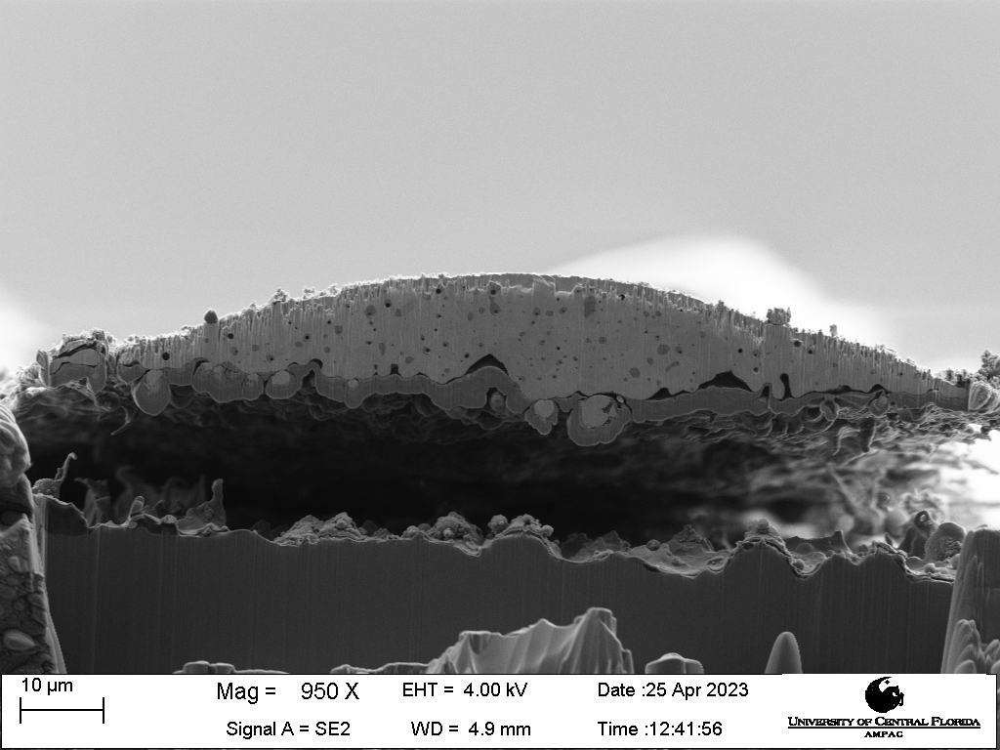

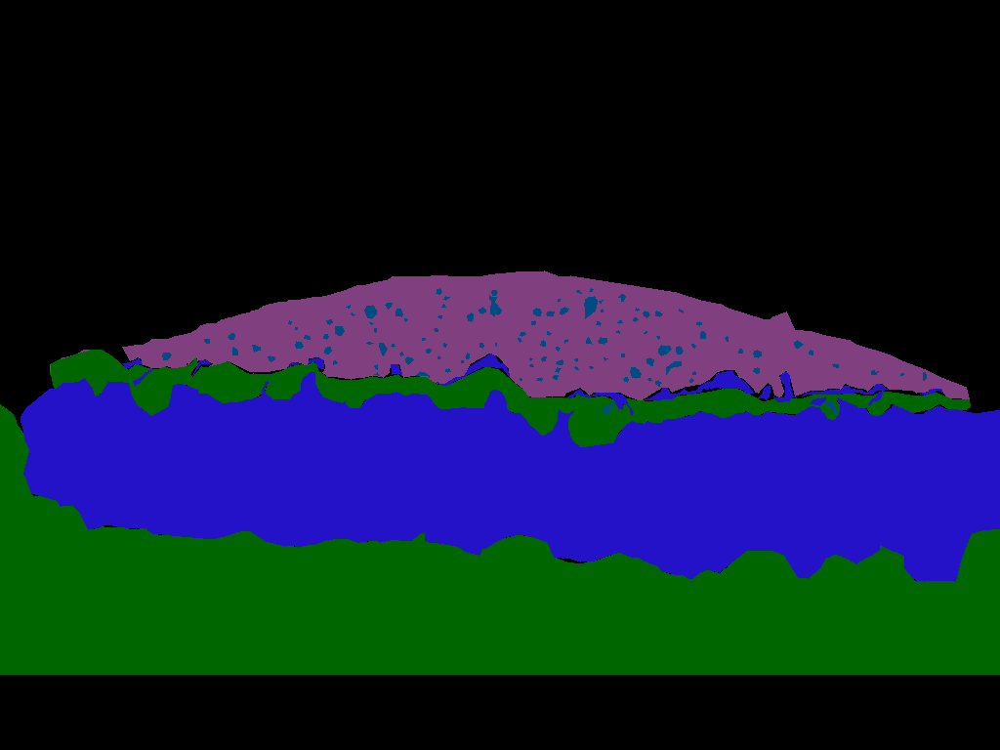

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


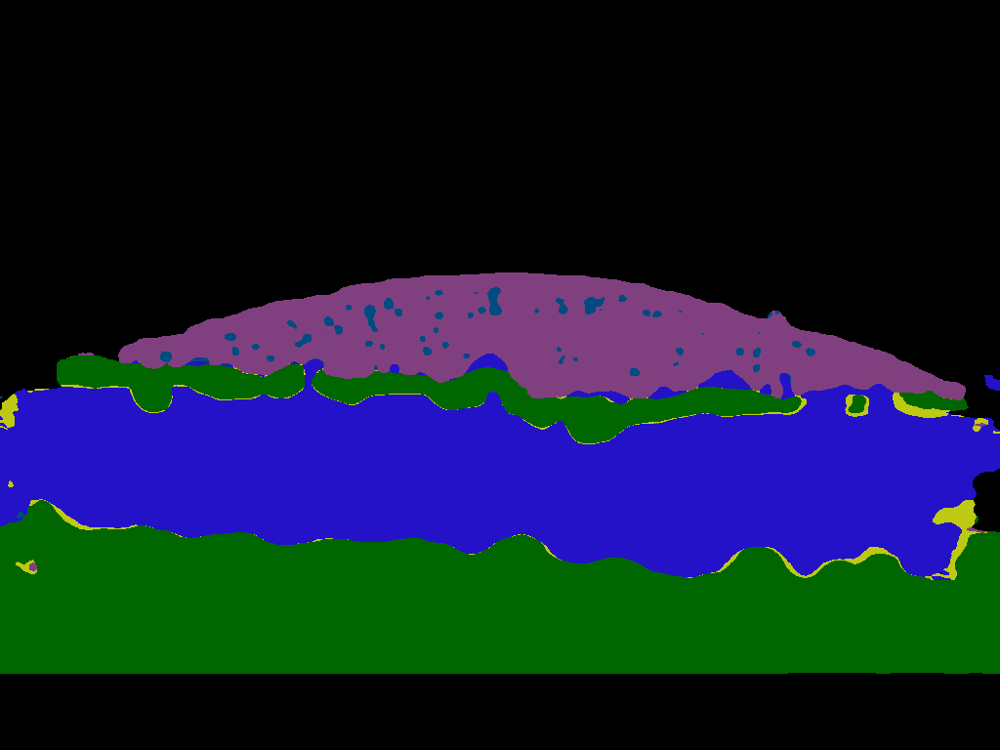

FGCU.C18CR12.w4.2.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


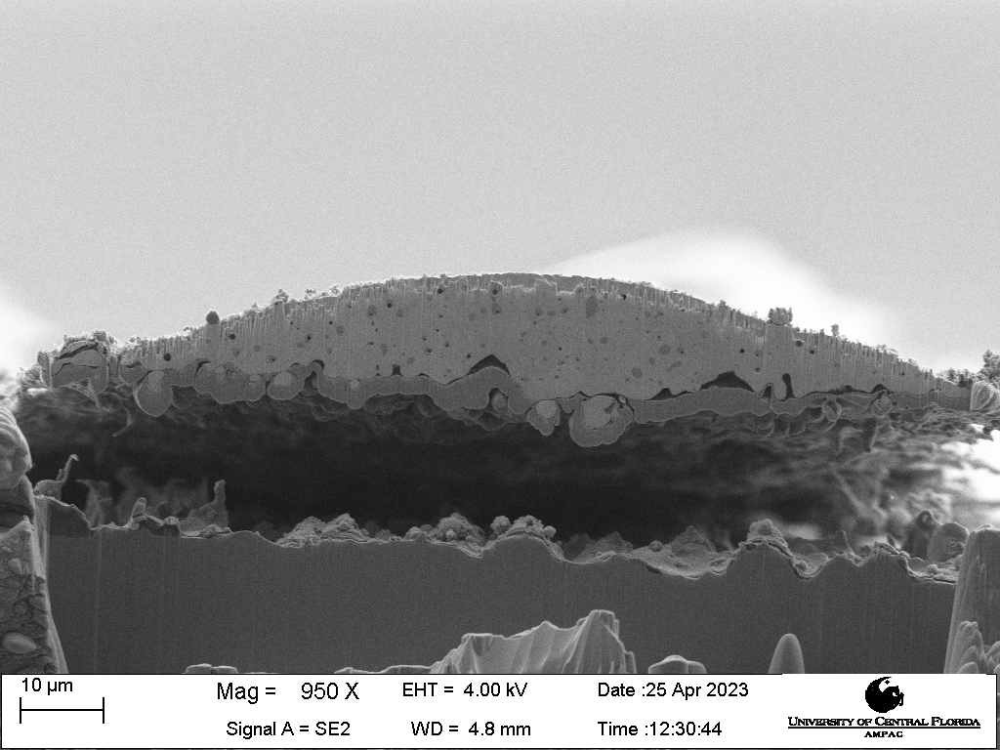

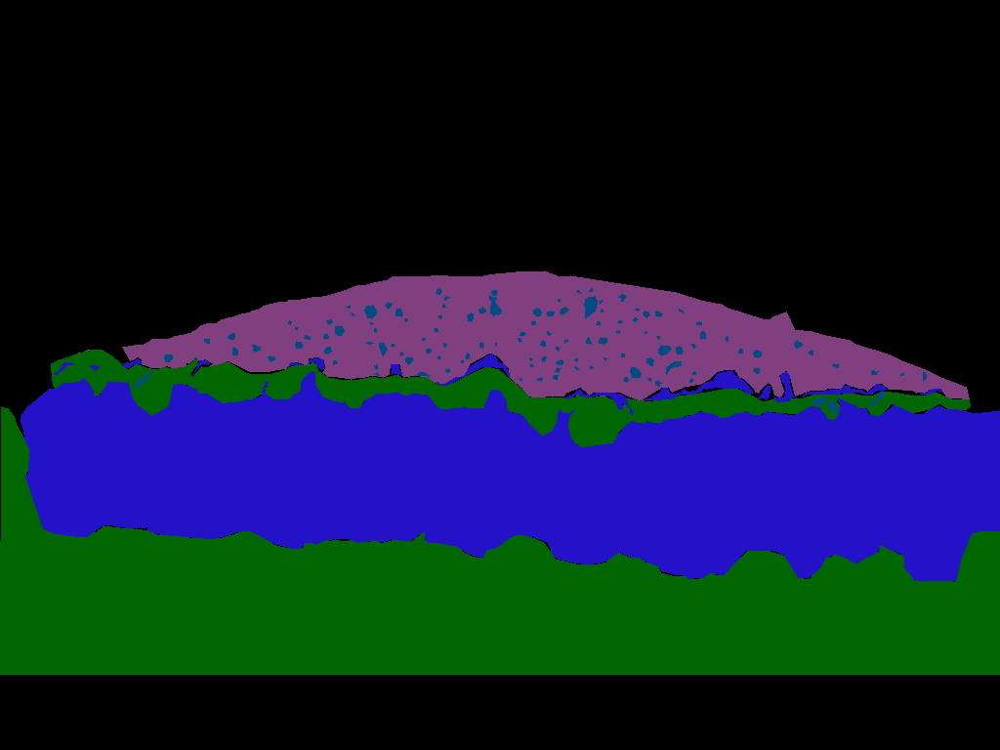

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


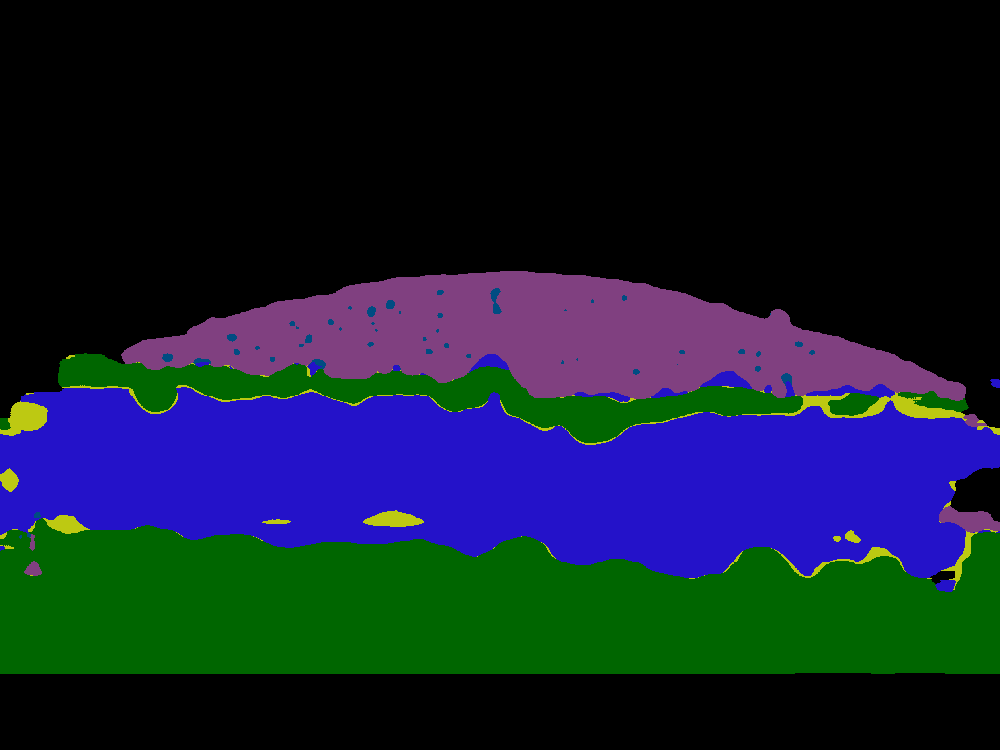

FGCU.3767.C10BB21.c3.1.png


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:895: UserWarning: unknown class(es) [2] will be ignored
  warnings.warn(


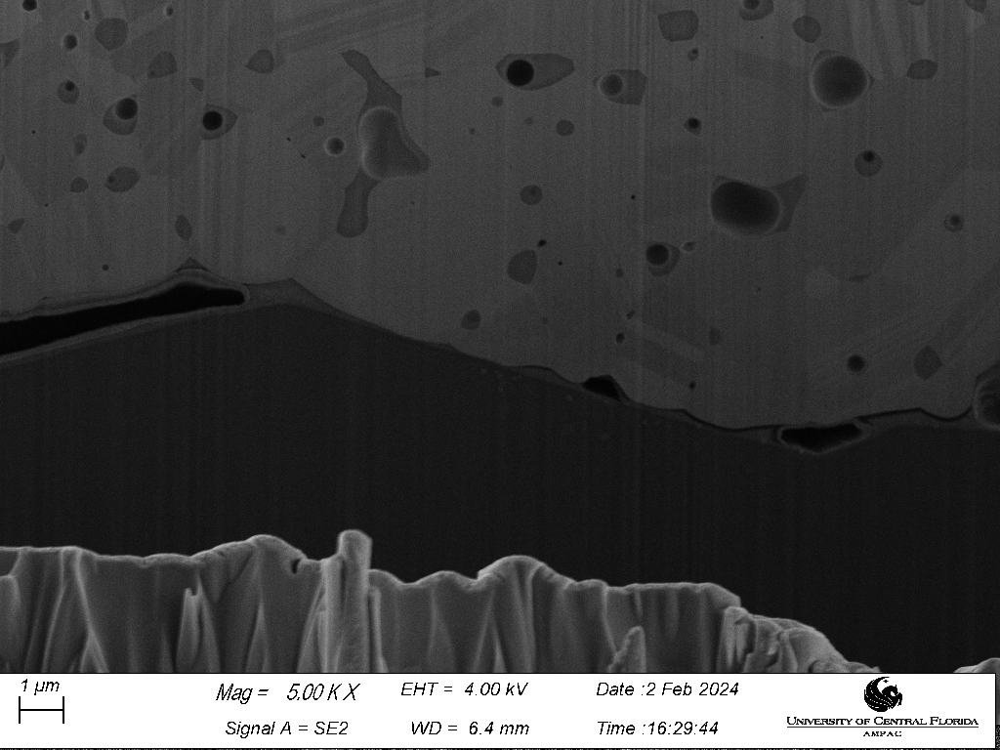

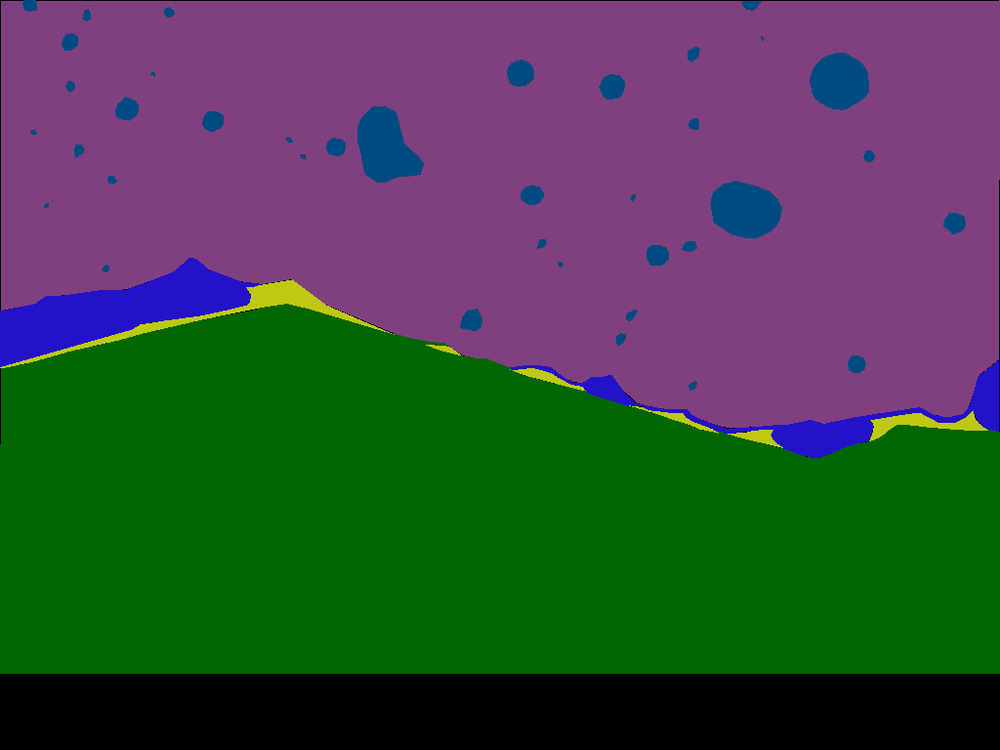

predicted
IMAGE DIMS:  torch.Size([1, 1, 768, 1024])


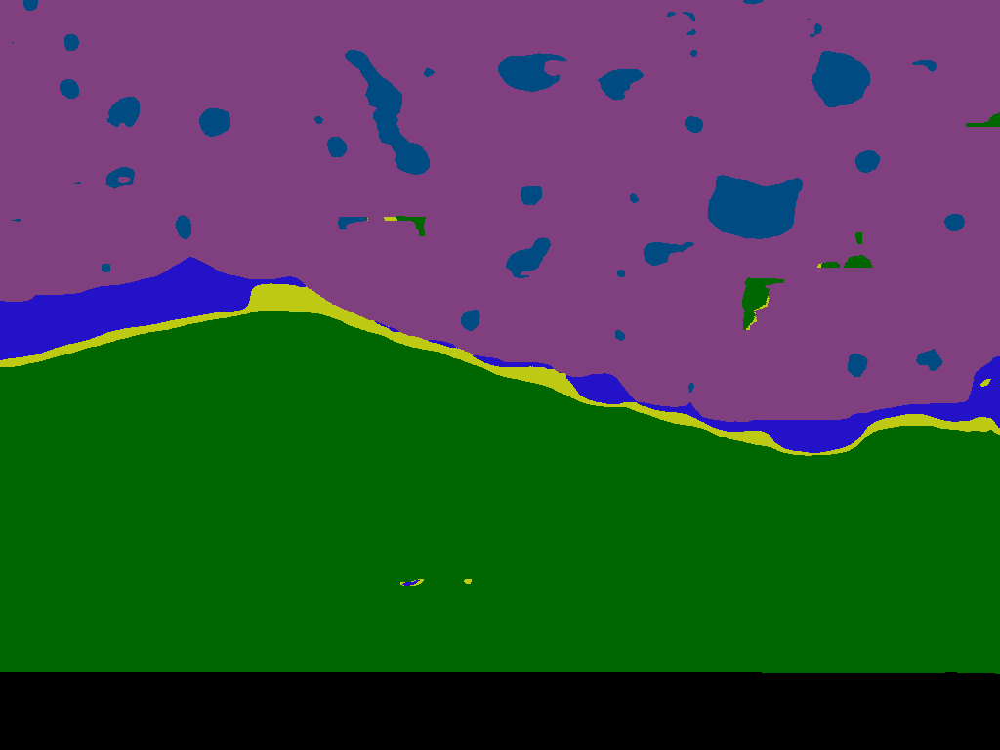

[0.25120773 0.99196326 0.88068182 0.90023753 0.93997072 0.968523  ]
background 0.6504585957342869
silver 0.9864537826367145
glass 0.7206009439300611
silicon 0.9116097524779333
void 0.9098396900645
interfacial void 0.9115952647993459


<Figure size 640x480 with 0 Axes>

In [35]:
# Check if cuda is available
use_cuda = torch.cuda.is_available()
# Set proper device based on cuda availability
device = torch.device("cuda" if use_cuda else "cpu")

model = UNet_PV().to(device)
model = torch.load('/content/drive/MyDrive/SEM_project/final_model_filled2.pth')
model.eval()

trans = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5))
 ])

classes = ["background", "silver", "glass", "silicon", "void", "interfacial void"]
f1_dict = {"background":[], "silver":[], "glass":[], "silicon":[], "void":[], "interfacial void":[]}
flag = 1

counter = 0
img_dir = '/content/drive/MyDrive/SEM_project/train/data/'
for filename in os.listdir(img_dir):
  file_path = Path(img_dir + filename)
  if file_path.suffix == '.png' or file_path.suffix == '.tif' or file_path.suffix == '.jpg':
        # Print OG photo
        print(filename)
        image = Image.open(file_path)
        image = image.resize((1024, 768))
        plt.clf()
        display(image)

        #print target mask
        mask_dir = "/content/drive/MyDrive/SEM_project/train/output/"
        label_name = mask_dir + os.path.basename(os.path.splitext(filename)[0]) + '_label.npy'
        label_np = np.load(label_name)
        label = torch.from_numpy(label_np) # convert label to tensor
        target_np = label.cpu().numpy().squeeze()
        label_mask = get_mask(target_np)
        label_mask = cv.resize(cv.cvtColor(label_mask, cv.COLOR_BGR2RGB), (1024, 768))
        cv2_imshow(label_mask)


        # print predicted mask
        image = grayscale(image)
        image = trans(image)
        image = image.to(device)
        image = image.unsqueeze(0)
        print('predicted')
        print("IMAGE DIMS: ", image.shape)
        pred = model(image)
        pred = F.softmax(pred, dim=1)
        pred = torch.argmax(pred, dim=1)
        pred = pred.cpu().numpy().squeeze()
        # plt.imshow(pred, cmap="viridis")
        # plt.title('Predicted')
        # plt.axis('off')  # Turn off axis labels
        # plt.show()
        pred_mask = get_mask(pred)
        pred_mask = cv.cvtColor(pred_mask, cv.COLOR_BGR2RGB)
        cv2_imshow(pred_mask)

         # Save images as PNG files with epoch number in the filename
        imsave(os.path.join("/content/drive/MyDrive/SEM_project/masks/final", os.path.splitext(os.path.basename(file_path))[0] + "_final.png"), pred_mask)
        plt.clf()
        label = np.load(Path(mask_dir + "/" + os.path.splitext(os.path.basename(file_path))[0] + "_label.npy"))
        m = MultiLabelBinarizer().fit(label)
        f1 = f1_score(m.transform(label), m.transform(pred), average=None)
        if len(f1) != 6:
            continue
        for i, class_name in enumerate(classes):
            f1_dict[class_name].append(f1[i])
        print(f1)
for class_name in classes:
    print(class_name, np.mean(f1_dict[class_name]))

#

In [36]:
# # Check if cuda is available
# use_cuda = torch.cuda.is_available()
# # Set proper device based on cuda availability
# device = torch.device("cuda" if use_cuda else "cpu")



# model = UNet_PV().to(device)

# model = torch.load('/content/drive/MyDrive/datasets1/final_model_filled2.pth')
# model.eval()

# trans = transforms.Compose([
#     transforms.ToTensor(),
#     transforms.Normalize((0.5), (0.5))
#  ])
# if flag not in locals() or flag == 0:
#   classes = ["background", "silver", "glass", "silicon", "void", "interfacial void"]
#   f1_dict = {"background":[], "silver":[], "glass":[], "silicon":[], "void":[], "interfacial void":[]}
#   flag == 0

# img_dir = '/content/drive/MyDrive/datasets1/test'
# for filename in os.listdir(img_dir):
#   file_path = Path(img_dir + "/" + filename)
#   if file_path.suffix == '.png' or file_path.suffix == '.tif' or file_path.suffix == '.jpg':
#     # if counter < 10:
#         print(filename)
#         image = Image.open(file_path).convert("L")
#         image = image.resize((1024, 768))
#         plt.clf()
#         print(image.mode)
#         OG_image = image
#         # OG_image = grayscale(image)
#         OG_image = image.point(lambda x: min(max(0, x), 255))
#         OG_image = np.array(image).astype(np.uint8)
#         cv2_imshow(OG_image)

#         mask_dir = "/content/drive/MyDrive/datasets1/test/output"
#         OG_mask_path = Path(mask_dir + "/" + os.path.splitext(os.path.basename(file_path))[0] + ".png")
#         print(OG_mask_path)
#         OG_Mask = Image.open(OG_mask_path)
#         OG_Mask = OG_Mask.resize((1024, 768))
#         OG_Mask = np.array(OG_Mask).astype(np.uint8)
#         cv2_imshow(OG_Mask)

#         image = grayscale(image)
#         image = trans(image)
#         image = image.to(device)
#         image = image.unsqueeze(0)
#         print("IMAGE DIMS: ", image.shape)
#         pred = model(image)
#         pred = F.softmax(pred, dim=1)
#         pred = torch.argmax(pred, dim=1)
#         pred = pred.cpu().numpy().squeeze()
#         # pred = np.moveaxis(pred, 0, -1)
#         pred_mask = get_mask(pred)
#         pred_mask = cv.cvtColor(pred_mask, cv.COLOR_BGR2RGB)
#         cv2_imshow(pred_mask)
#         imsave(os.path.join("/content/drive/MyDrive/datasets1/output", os.path.splitext(os.path.basename(file_path))[0] + ".png"), pred_mask)
#         plt.clf()
#         label = np.load(Path(mask_dir + "/" + os.path.splitext(os.path.basename(file_path))[0] + "_label.npy"))
#         m = MultiLabelBinarizer().fit(label)
#         f1 = f1_score(m.transform(label), m.transform(pred), average=None)
#         if len(f1) != 6:
#             continue
#         for i, class_name in enumerate(classes):
#             f1_dict[class_name].append(f1[i])
#         print(f1)
# for class_name in classes:
#     print(class_name, np.mean(f1_dict[class_name]))

